## Libraries

In [2]:
import pandas as pd 
import warnings
warnings.filterwarnings('ignore')
from neo4j import GraphDatabase
import matplotlib.pyplot as plt
import pm4py
from pm4py.statistics.traces.log import case_statistics
from datetime import datetime
import matplotlib.dates as mdates
import seaborn as sns
import numpy as np


## Global Veriables

In [3]:

common_path = "/Users/abdalrhman/Documents/bdma-thesis/python/data/"

driver = GraphDatabase.driver("bolt://localhost:7687", auth=("Username", "Password"))
session = driver.session()

In [4]:
def neo4j_date_to_datetime(date):
    return datetime(year=date.year, month=date.month, day=date.day)


In [5]:
def get_day_of_week(date):
    return date.weekday()

In [ ]:
def count_within_intervals(group):
    group = group.sort_values('e.timestamp')
    counts = []
    start_idx = 0
    for i in range(len(group)):
        while group.iloc[i]['e.timestamp'] - group.iloc[start_idx]['e.timestamp'] > pd.Timedelta(minutes=5):
            start_idx += 1
        counts.append(i - start_idx + 1)
    group['count'] = counts
    return group

In [ ]:
def calc_time_diff(group):
    group = group.sort_values(by='e.timestamp')
    group['time_diff'] = group['e.timestamp'].diff()
    return group

## Analyze the working hours

In [128]:
query = f'''MATCH (n:Event)
WITH date(datetime({{epochmillis:timestamp(n.timestamp)}})) AS date, n
RETURN date, MIN(n.timestamp) AS earliestTimestamp, MAX(n.timestamp) AS latestTimestamp
order by date'''

result = session.run(query)
records = [record.values() for record in result]
columns = result.keys()
df = pd.DataFrame(records, columns=columns)
df['earliestTimestamp'] = pd.to_datetime(df['earliestTimestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df['latestTimestamp'] = pd.to_datetime(df['latestTimestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df.head()

,date,earliestTimestamp,latestTimestamp
0,2022-01-01,2022-01-01 07:09:00+00:00,2022-01-01 21:54:00+00:00
1,2022-01-02,2022-01-02 06:54:00+00:00,2022-01-02 21:52:00+00:00
2,2022-01-03,2022-01-03 06:59:00+00:00,2022-01-03 21:44:00+00:00
3,2022-01-04,2022-01-04 06:50:00+00:00,2022-01-04 21:49:00+00:00
4,2022-01-05,2022-01-05 06:44:00+00:00,2022-01-05 21:54:00+00:00


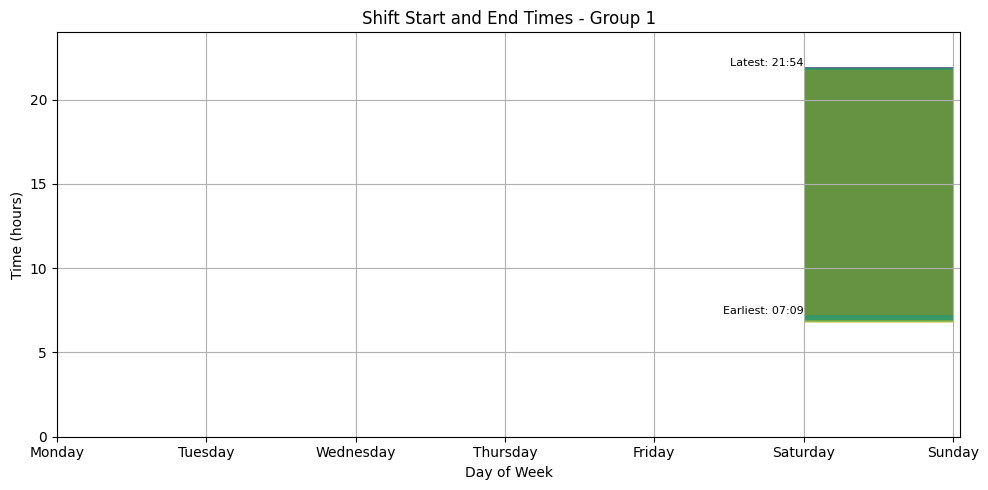

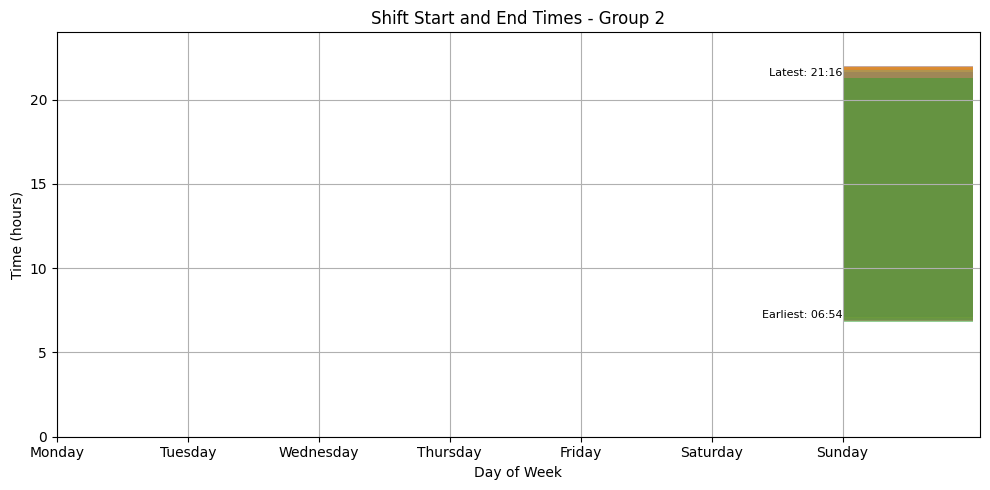

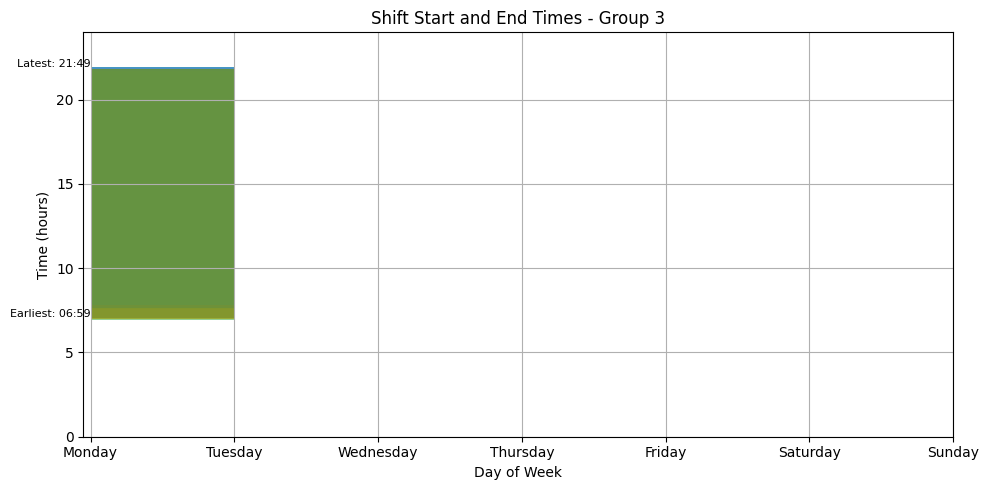

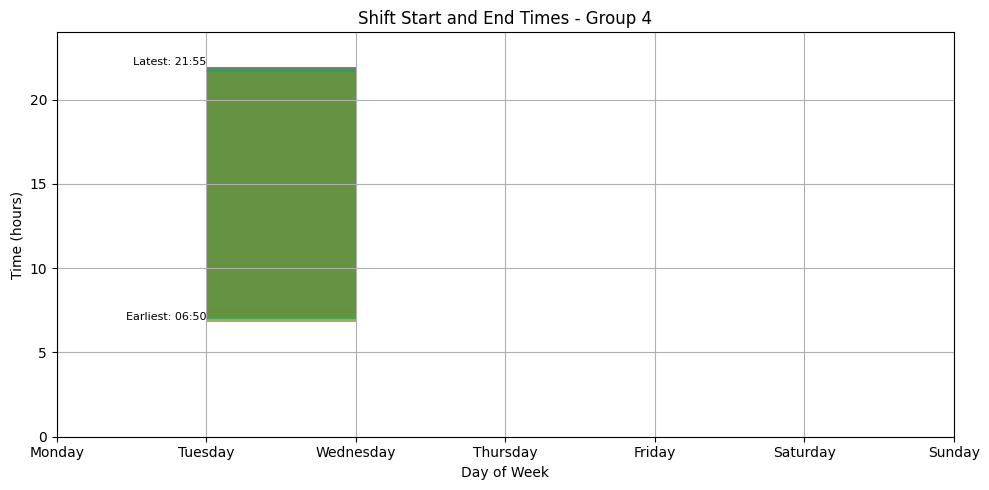

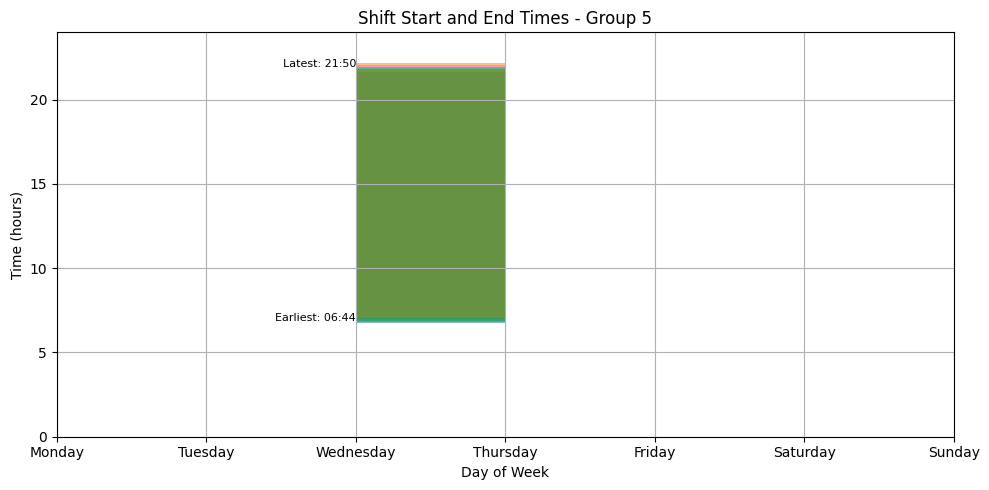

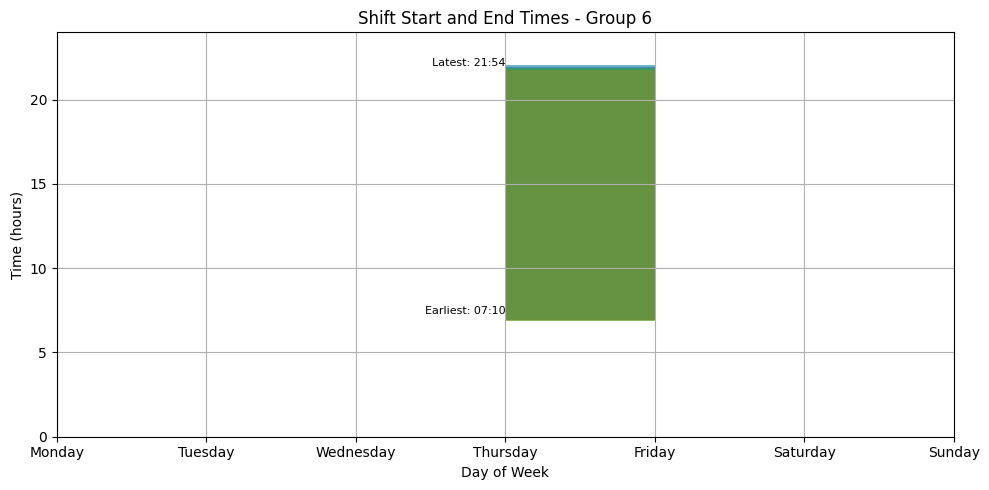

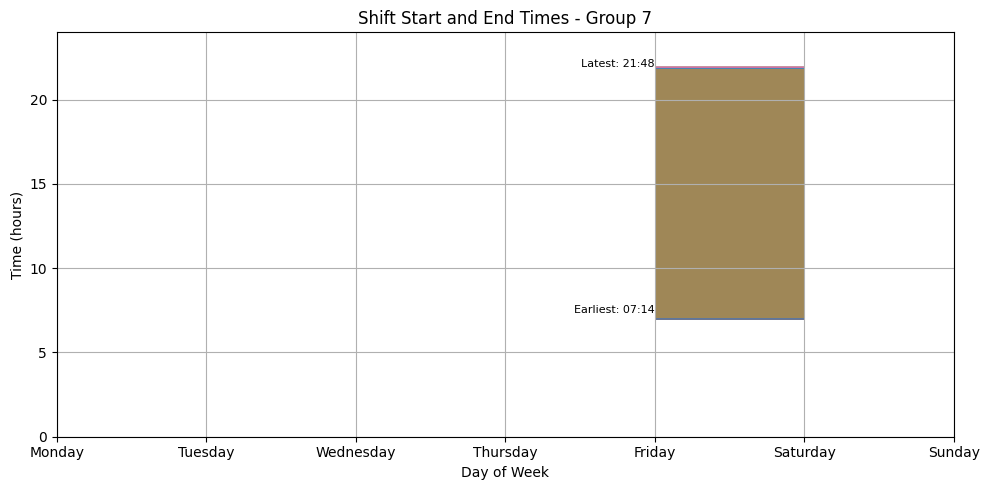

In [129]:
df['date'] = df['date'].apply(neo4j_date_to_datetime)
df['day_of_week'] = df['date'].apply(get_day_of_week)

groups = df.groupby(df.index % 7)

for idx, (group_idx, group_df) in enumerate(groups):
    fig, ax = plt.subplots(figsize=(10, 5))
    
    for _, row in group_df.iterrows():
        start_time = row['earliestTimestamp'].hour + row['earliestTimestamp'].minute / 60
        end_time = row['latestTimestamp'].hour + row['latestTimestamp'].minute / 60
        ax.fill_between([row['day_of_week'], row['day_of_week'] + 1], start_time, end_time, alpha=0.5)
    
    earliest_row = group_df.loc[group_df['earliestTimestamp'].idxmin()]
    latest_row = group_df.loc[group_df['latestTimestamp'].idxmax()]
    
    ax.text(earliest_row['day_of_week'], earliest_row['earliestTimestamp'].hour + earliest_row['earliestTimestamp'].minute / 60, f"Earliest: {earliest_row['earliestTimestamp'].strftime('%H:%M')}", ha='right', va='bottom', fontsize=8, color='black')
    ax.text(latest_row['day_of_week'], latest_row['latestTimestamp'].hour + latest_row['latestTimestamp'].minute / 60, f"Latest: {latest_row['latestTimestamp'].strftime('%H:%M')}", ha='right', va='bottom', fontsize=8, color='black')

    ax.set_xticks([0, 1, 2, 3, 4, 5, 6])
    ax.set_xticklabels([ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

    ax.set_ylim(0, 24)

    plt.xlabel('Day of Week')
    plt.ylabel('Time (hours)')
    plt.title(f'Shift Start and End Times - Group {idx + 1}')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


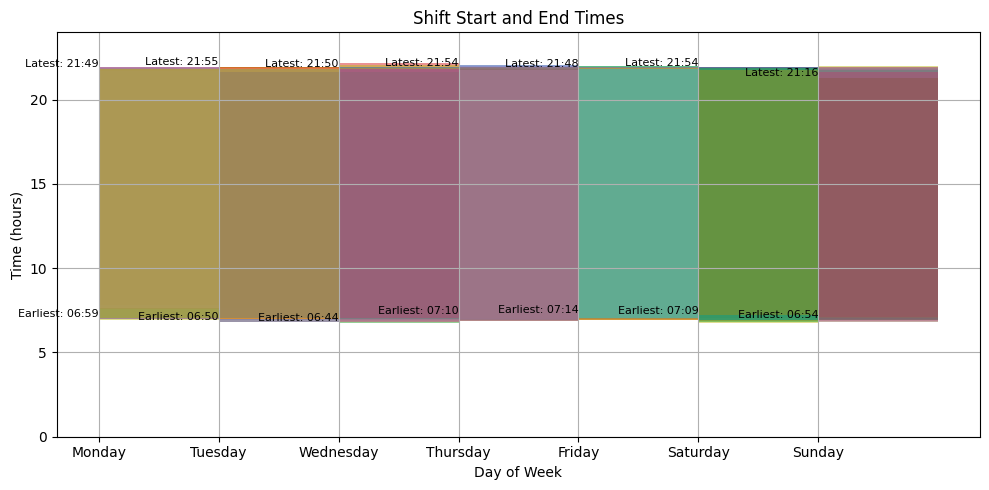

In [130]:
df['date'] = df['date'].apply(neo4j_date_to_datetime)

df['day_of_week'] = df['date'].apply(get_day_of_week)

groups = df.groupby(df.index % 7)
fig, ax = plt.subplots(figsize=(10, 5))

for idx, (group_idx, group_df) in enumerate(groups):
    
    for _, row in group_df.iterrows():
        start_time = row['earliestTimestamp'].hour + row['earliestTimestamp'].minute / 60
        end_time = row['latestTimestamp'].hour + row['latestTimestamp'].minute / 60
        ax.fill_between([row['day_of_week'], row['day_of_week'] + 1], start_time, end_time, alpha=0.5)
    
    earliest_row = group_df.loc[group_df['earliestTimestamp'].idxmin()]
    latest_row = group_df.loc[group_df['latestTimestamp'].idxmax()]
    
    ax.text(earliest_row['day_of_week'], earliest_row['earliestTimestamp'].hour + earliest_row['earliestTimestamp'].minute / 60, f"Earliest: {earliest_row['earliestTimestamp'].strftime('%H:%M')}", ha='right', va='bottom', fontsize=8, color='black')
    ax.text(latest_row['day_of_week'], latest_row['latestTimestamp'].hour + latest_row['latestTimestamp'].minute / 60, f"Latest: {latest_row['latestTimestamp'].strftime('%H:%M')}", ha='right', va='bottom', fontsize=8, color='black')

    ax.set_xticks([0, 1, 2, 3, 4, 5, 6])
    ax.set_xticklabels([ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

    ax.set_ylim(0, 24)

plt.xlabel('Day of Week')
plt.ylabel('Time (hours)')
plt.title(f'Shift Start and End Times')
plt.grid(True)
plt.tight_layout()
plt.show()


In [131]:
query = f'''MATCH (n:Event)
WITH date(datetime({{epochmillis:timestamp(n.timestamp)}})) AS date, n
RETURN  distinct date, count(distinct n.Usuario) 
order by date'''
result = session.run(query)
records = [record.values() for record in result]
columns = result.keys()
df = pd.DataFrame(records, columns=columns)
df.head()

,date,count(distinct n.Usuario)
0,2022-01-01,2
1,2022-01-02,2
2,2022-01-03,13
3,2022-01-04,12
4,2022-01-05,13


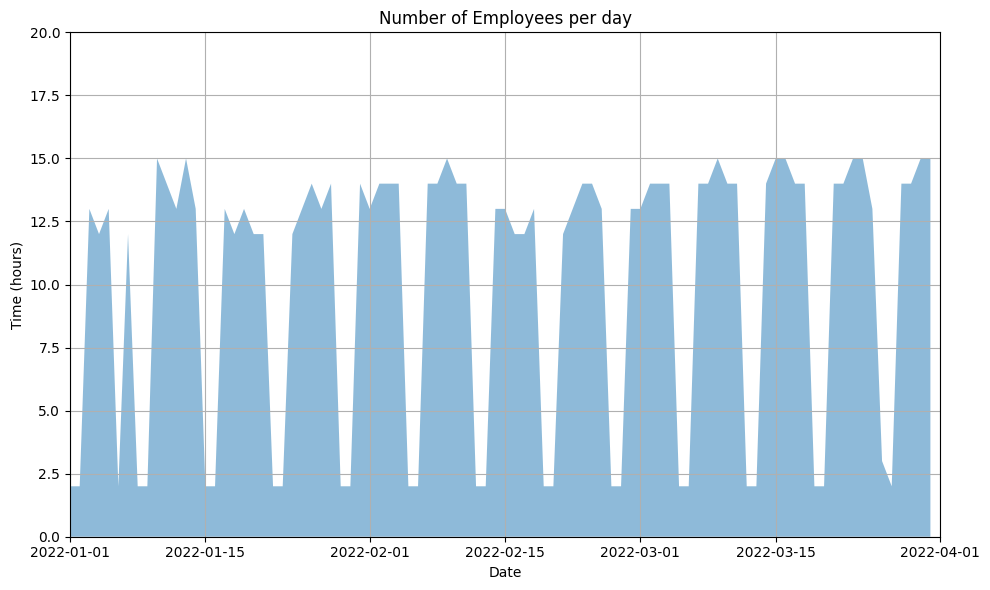

In [132]:
df['date'] = df['date'].apply(neo4j_date_to_datetime)

fig, ax = plt.subplots(figsize=(10, 6))

ax.set_xlim(pd.Timestamp("2022-01-01 00:00:00"), pd.Timestamp("2022-04-01 00:00:00"))
ax.set_ylim(0, 20)

x_values = mdates.date2num(df['date'])
y_values = df['count(distinct n.Usuario)']
ax.fill_between(x_values, 0, y_values, alpha=0.5)
ax.set_xlabel('Date')
ax.set_ylabel('Time (hours)')
ax.set_title('Number of Employees per day')
ax.grid(True)

plt.tight_layout()
plt.show()



In [133]:
query = f'''MATCH (n:Event)
WITH date(datetime({{epochmillis:timestamp(n.timestamp)}})) AS date, n
RETURN  distinct n.Usuario, date, MIN(n.timestamp) AS earliestTimestamp, MAX(n.timestamp) AS latestTimestamp
order by date, earliestTimestamp'''
result = session.run(query)
records = [record.values() for record in result]
columns = result.keys()
df = pd.DataFrame(records, columns=columns)
df['earliestTimestamp'] = pd.to_datetime(df['earliestTimestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df['latestTimestamp'] = pd.to_datetime(df['latestTimestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df.head()

,n.Usuario,date,earliestTimestamp,latestTimestamp
0,MCE,2022-01-01,2022-01-01 07:09:00+00:00,2022-01-01 13:57:00+00:00
1,LI,2022-01-01,2022-01-01 14:17:00+00:00,2022-01-01 21:54:00+00:00
2,MCE,2022-01-02,2022-01-02 06:54:00+00:00,2022-01-02 14:27:00+00:00
3,LI,2022-01-02,2022-01-02 14:24:00+00:00,2022-01-02 21:52:00+00:00
4,BM,2022-01-03,2022-01-03 06:59:00+00:00,2022-01-03 14:18:00+00:00


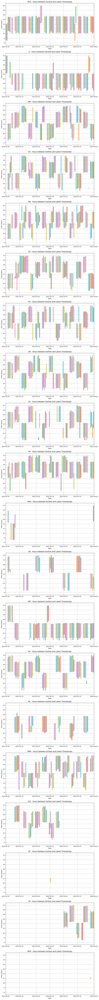

In [134]:
df['date'] = df['date'].apply(neo4j_date_to_datetime)

users = df['n.Usuario'].unique()
fig, axs = plt.subplots(len(users), figsize=(10, 5 * len(users)))

for idx, user in enumerate(users):
    user_df = df[df['n.Usuario'] == user]

    for _, row in user_df.iterrows():
        start_time = row['earliestTimestamp'].hour + row['earliestTimestamp'].minute / 60
        end_time = row['latestTimestamp'].hour + row['latestTimestamp'].minute / 60
        x_values = [mdates.date2num(row['date']), mdates.date2num(row['date'] + pd.Timedelta(days=1))]
        axs[idx].fill_between(x_values, start_time, end_time, alpha=0.5)
    
    earliest_row = user_df.loc[user_df['earliestTimestamp'].idxmin()]
    latest_row = user_df.loc[user_df['latestTimestamp'].idxmax()]
    
    axs[idx].text(earliest_row['date'], earliest_row['earliestTimestamp'].hour + earliest_row['earliestTimestamp'].minute / 60, f"", ha='right', va='bottom', fontsize=8, color='black')
    axs[idx].text(latest_row['date'], latest_row['latestTimestamp'].hour + latest_row['latestTimestamp'].minute / 60, f"", ha='right', va='bottom', fontsize=8, color='black')
    axs[idx].set_xlim(pd.Timestamp("2022-01-01 00:00:00"), pd.Timestamp("2022-04-01 00:00:00"))
    axs[idx].set_ylim(5, 23)
    axs[idx].set_xlabel('Date')
    axs[idx].set_ylabel('Time (hours)')
    axs[idx].set_title(f'{user} - Hours between Earliest and Latest Timestamps')
    axs[idx].grid(True)

plt.tight_layout()
plt.show()


In [135]:
query = f'''MATCH (n:Event) - [:CORR] -> (r:Run {{EntityType:"Kit"}})
WITH date(datetime({{epochmillis:timestamp(n.timestamp)}})) AS date, n
RETURN  distinct date, count(distinct n.CaseID) as unfilteredRuns
order by date'''
result = session.run(query)
records = [record.values() for record in result]
columns = result.keys()
df1 = pd.DataFrame(records, columns=columns)
query = f'''MATCH (n:Event) - [:CORR] -> (r:Run {{EntityType:"Kit"}})
where r.durationInMinutes > 0
WITH date(datetime({{epochmillis:timestamp(n.timestamp)}})) AS date, n
RETURN  distinct date, count(distinct n.CaseID) as filteredRuns
order by date'''
result = session.run(query)
records = [record.values() for record in result]
columns = result.keys()
df = pd.DataFrame(records, columns=columns)
df['unfilteredRuns'] = df1['unfilteredRuns']
df.head()

,date,filteredRuns,unfilteredRuns
0,2022-01-01,47,100
1,2022-01-02,65,141
2,2022-01-03,275,614
3,2022-01-04,232,417
4,2022-01-05,242,539


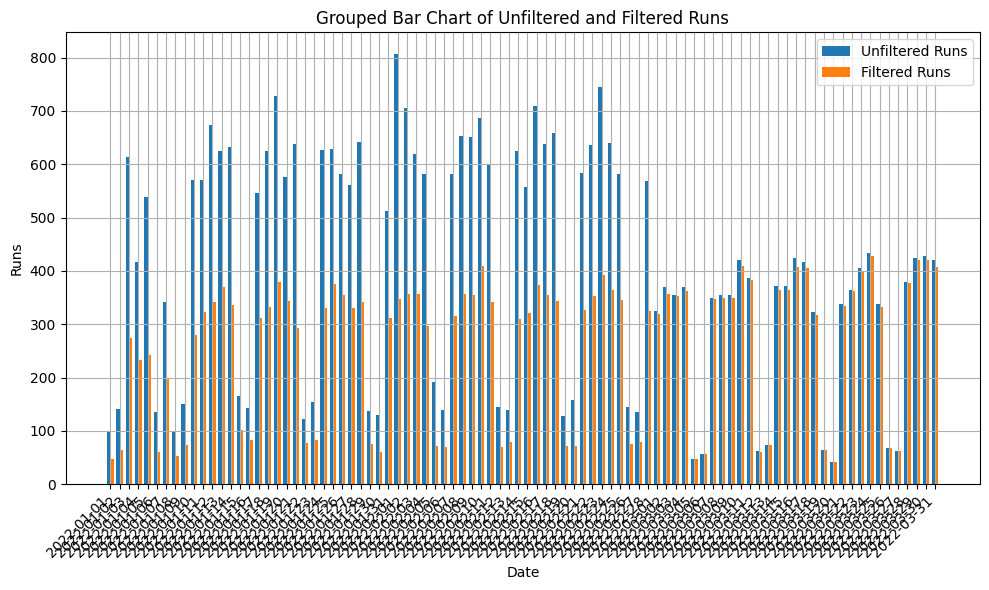

In [136]:
df['date'] = df['date'].apply(neo4j_date_to_datetime)

fig, ax = plt.subplots(figsize=(10, 6))

bar_width = 0.35

x = range(len(df))
ax.bar(x, df['unfilteredRuns'], width=bar_width, label='Unfiltered Runs')
ax.bar([i + bar_width for i in x], df['filteredRuns'], width=bar_width, label='Filtered Runs')

ax.set_xticks([i + bar_width / 2 for i in x])
ax.set_xticklabels(df['date'].dt.strftime('%Y-%m-%d'), rotation=45, ha='right')
ax.set_xlabel('Date')
ax.set_ylabel('Runs')
ax.set_title('Grouped Bar Chart of Unfiltered and Filtered Runs')
ax.grid(True)
ax.legend()
plt.tight_layout()
plt.show()

In [137]:
query = f'''MATCH (n:Event) - [:CORR] -> (r:Run {{EntityType:"Kit"}})
WITH date(datetime({{epochmillis:timestamp(n.timestamp)}})) AS date, r
RETURN  distinct date, avg(r.waitingDurationInMinutes) as waiting, avg(r.workingDurationInMinutes) as working
order by date'''
result = session.run(query)
records = [record.values() for record in result]
columns = result.keys()
df = pd.DataFrame(records, columns=columns)
df.head()

,date,waiting,working
0,2022-01-01,173.196030,149.275434
1,2022-01-02,234.293680,168.791822
2,2022-01-03,176.377488,162.961565
3,2022-01-04,184.883333,171.556863
4,2022-01-05,281.225861,159.180101


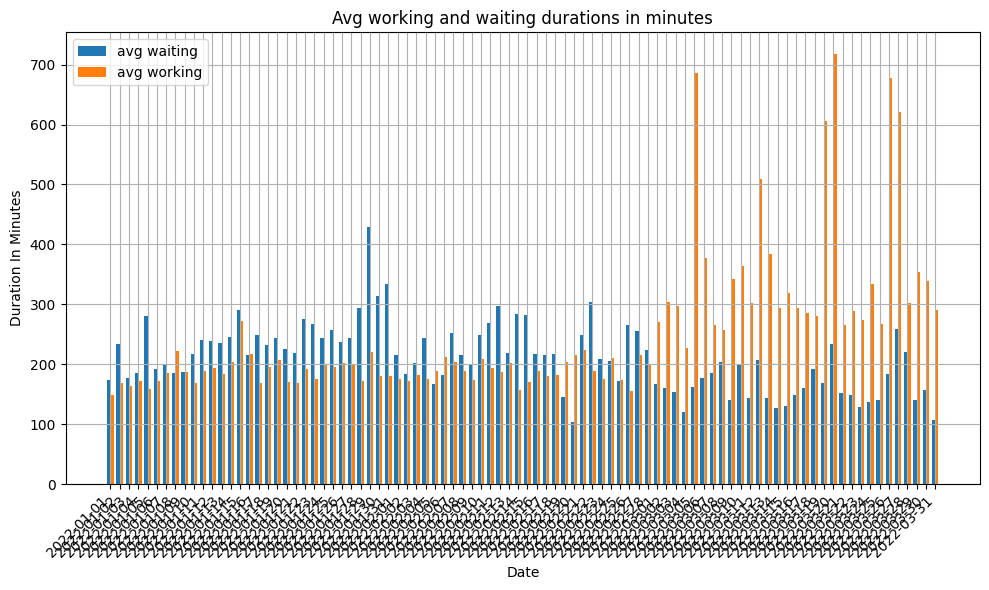

In [138]:
df['date'] = df['date'].apply(neo4j_date_to_datetime)

fig, ax = plt.subplots(figsize=(10, 6))
bar_width = 0.35

x = range(len(df))
ax.bar(x, df['waiting'], width=bar_width, label='avg waiting')
ax.bar([i + bar_width for i in x], df['working'], width=bar_width, label='avg working')
ax.set_xticks([i + bar_width / 2 for i in x])
ax.set_xticklabels(df['date'].dt.strftime('%Y-%m-%d'), rotation=45, ha='right')
ax.set_xlabel('Date')
ax.set_ylabel('Duration In Minutes')
ax.set_title('Avg working and waiting durations in minutes')
ax.grid(True)
ax.legend()

plt.tight_layout()
plt.show()

In [140]:
query = """
MATCH (e:Event {Activity: 'Entrada Material Sucio'})
RETURN e.timestamp AS timestamp
"""

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['timestamp'] = pd.to_datetime(df['timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df['day_of_week'] = df['timestamp'].dt.day_name()
df['hour'] = df['timestamp'].dt.hour
df.head()


                  timestamp day_of_week  hour
0 2022-03-08 21:13:00+00:00     Tuesday    21
1 2022-03-08 21:13:00+00:00     Tuesday    21
2 2022-03-08 19:51:00+00:00     Tuesday    19
3 2022-03-08 18:05:00+00:00     Tuesday    18
4 2022-03-08 18:04:00+00:00     Tuesday    18


In [141]:
event_counts = df.groupby(['day_of_week', 'hour']).size().reset_index(name='count')
pivot_table = event_counts.pivot(index='day_of_week', columns='hour', values='count').fillna(0)
average_events_per_hour = pivot_table.mean(axis=1)
print(average_events_per_hour)


day_of_week
Friday       138.266667
Monday       166.200000
Saturday      23.866667
Sunday        25.600000
Thursday     177.933333
Tuesday      167.533333
Wednesday    175.866667
dtype: float64


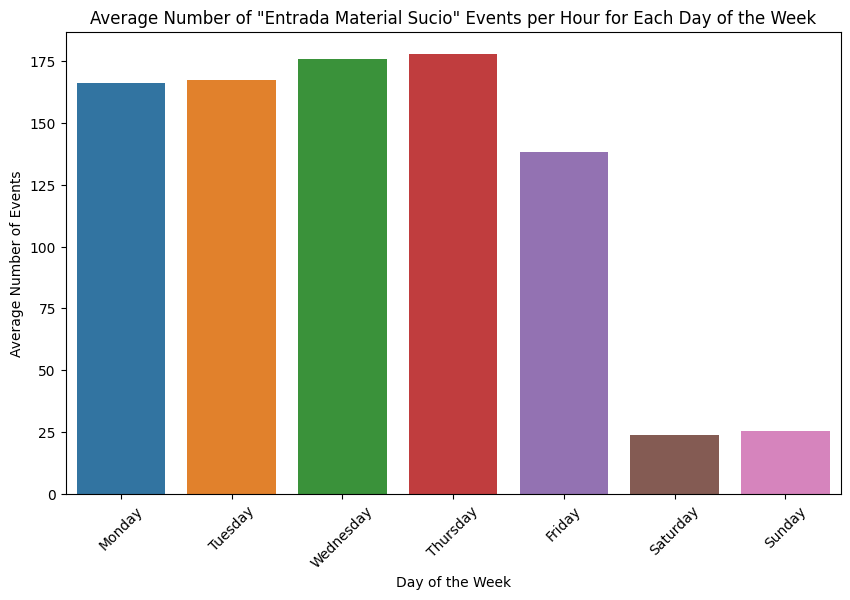

In [142]:
days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

average_events_per_hour = average_events_per_hour.reindex(days_order)

plt.figure(figsize=(10, 6))
sns.barplot(x=average_events_per_hour.index, y=average_events_per_hour.values)
plt.title('Average Number of "Entrada Material Sucio" Events per Hour for Each Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Average Number of Events')
plt.xticks(rotation=45)
plt.show()


In [143]:
average_events_per_hour.describe()

count      7.000000
mean     125.038095
std       69.737825
min       23.866667
25%       81.933333
50%      166.200000
75%      171.700000
max      177.933333
dtype: float64

In [144]:
event_counts_per_hour = df.groupby('hour').size().reset_index(name='count')
print(event_counts_per_hour)


    hour  count
0      7    595
1      8    215
2      9    288
3     10    720
4     11   1663
5     12   1598
6     13   2935
7     14   1506
8     15   1034
9     16    922
10    17    702
11    18    325
12    19    268
13    20    228
14    21    130


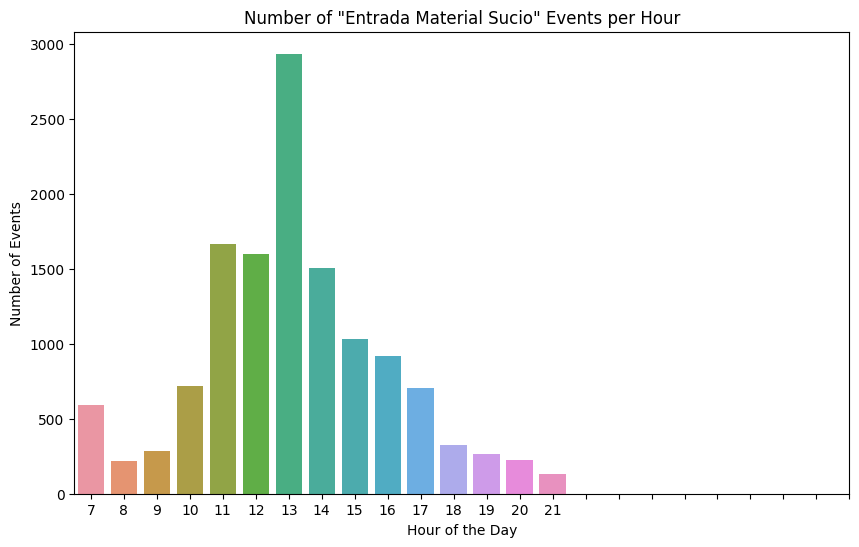

In [145]:

plt.figure(figsize=(10, 6))
sns.barplot(x=event_counts_per_hour['hour'], y=event_counts_per_hour['count'])
plt.title('Number of "Entrada Material Sucio" Events per Hour')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Events')
plt.xticks(range(0, 24))  
plt.show()


In [146]:
grouped = df.groupby(['day_of_week', 'hour']).size().reset_index(name='count')
average_events = grouped.groupby(['day_of_week', 'hour'])['count'].mean().reset_index()
print(average_events)


    day_of_week  hour  count
0        Friday     7   63.0
1        Friday     8   35.0
2        Friday     9   26.0
3        Friday    10   85.0
4        Friday    11  314.0
..          ...   ...    ...
98    Wednesday    17  174.0
99    Wednesday    18   72.0
100   Wednesday    19   55.0
101   Wednesday    20   27.0
102   Wednesday    21   34.0

[103 rows x 3 columns]


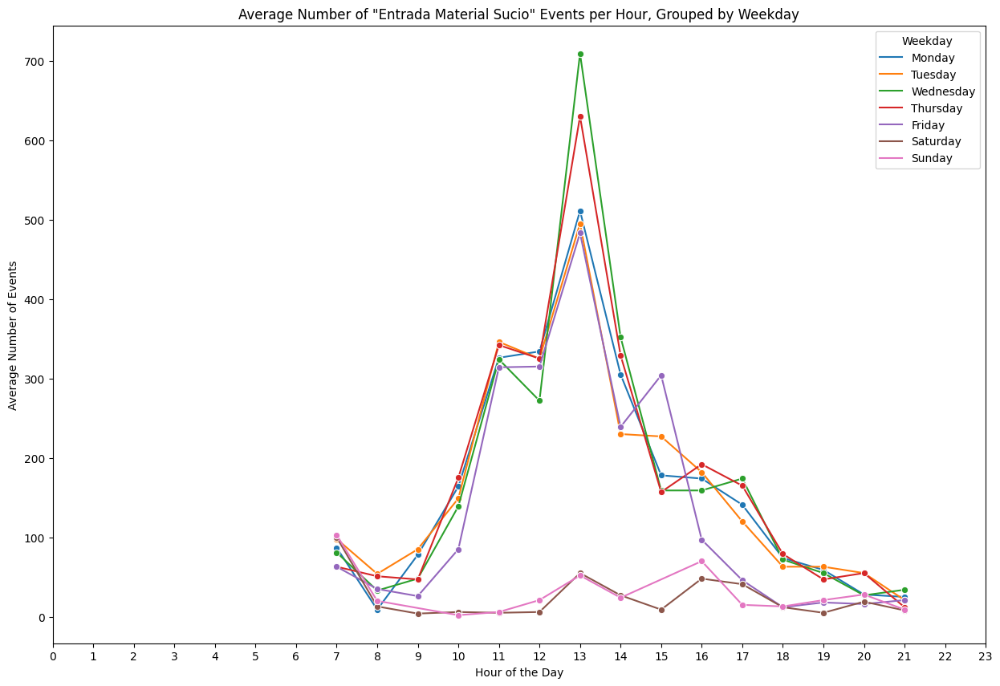

In [147]:
weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

plt.figure(figsize=(15, 10))
sns.lineplot(data=average_events, x='hour', y='count', hue='day_of_week', hue_order=weekday_order, marker='o')
plt.title('Average Number of "Entrada Material Sucio" Events per Hour, Grouped by Weekday')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Number of Events')
plt.xticks(range(0, 24))  
plt.legend(title='Weekday')
plt.show()


In [149]:
query = """
MATCH (e:Event)
RETURN e.timestamp AS timestamp, e.Usuario AS usuario
"""

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['timestamp'] = pd.to_datetime(df['timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')

df['hour'] = df['timestamp'].dt.hour
df['weekday'] = df['timestamp'].dt.day_name()
df['week'] = df['timestamp'].dt.isocalendar().week
df.head()


                  timestamp usuario  hour  weekday  week
0 2022-03-08 21:13:00+00:00      CM    21  Tuesday    10
1 2022-03-08 21:13:00+00:00      CM    21  Tuesday    10
2 2022-03-08 19:51:00+00:00      CM    19  Tuesday    10
3 2022-03-08 18:05:00+00:00      CM    18  Tuesday    10
4 2022-03-08 18:04:00+00:00      CM    18  Tuesday    10


In [150]:
grouped = df.groupby(['week', 'weekday', 'hour', 'usuario']).size().reset_index(name='count')
unique_counts = grouped.groupby(['week', 'weekday', 'hour']).size().reset_index(name='unique_usuarios')
print(unique_counts)

      week weekday  hour  unique_usuarios
0        1  Friday     7                2
1        1  Friday     8                2
2        1  Friday     9                3
3        1  Friday    10                3
4        1  Friday    11                4
...    ...     ...   ...              ...
1391    52  Sunday    17                1
1392    52  Sunday    18                1
1393    52  Sunday    19                1
1394    52  Sunday    20                1
1395    52  Sunday    21                1

[1396 rows x 4 columns]


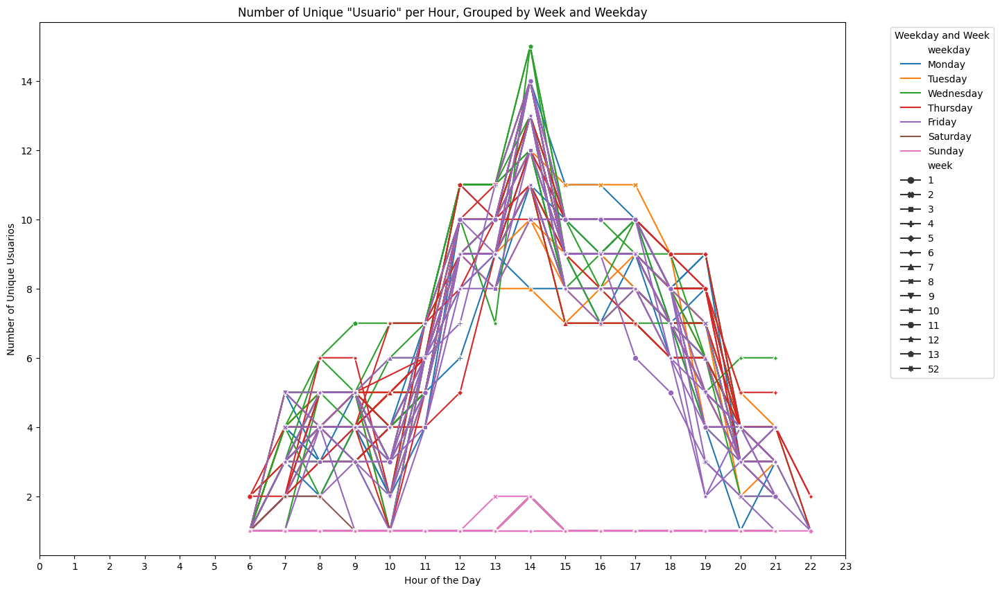

In [151]:
weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

plt.figure(figsize=(15, 10))
sns.lineplot(data=unique_counts, x='hour', y='unique_usuarios', hue='weekday', style='week', markers=True, dashes=False, hue_order=weekday_order)
plt.title('Number of Unique "Usuario" per Hour, Grouped by Week and Weekday')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Unique Usuarios')
plt.xticks(range(0, 24))  
plt.legend(title='Weekday and Week', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()



In [153]:
query = '''MATCH (e:Event {Activity: "Carga L+D iniciada"})-[r:WASHED_IN]->(w:WashingMachine) 
where w.machine in ['Lavadora 2', 'Lavadora 4', 'Lavadora 1', 'Lavadora 3', 'Jupiter']
RETURN distinct e.timestamp, count(e), w.machine
order by e.timestamp desc'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
counts = df['w.machine'].value_counts()
percentages = counts / counts.sum() * 100
results_df = pd.DataFrame({'count': counts, 'percentage': percentages})

print(results_df)

            count  percentage
Lavadora 2    418   28.053691
Lavadora 4    367   24.630872
Lavadora 1    365   24.496644
Lavadora 3    289   19.395973
Jupiter        51    3.422819


In [155]:
query = '''MATCH (e:Event {Activity: "Composición de cargas"})-[r:STERILIZED_IN]->(s:SterilizationMachine) 
where s.machine = 'Amsco Vpro'
RETURN distinct e.timestamp, count(e), s.machine, e.additionalInfo2
order by e.timestamp desc'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
counts = df['e.additionalInfo2'].value_counts()
percentages = counts / counts.sum() * 100
results_df = pd.DataFrame({'count': counts, 'percentage': percentages})
print(results_df)

                      count  percentage
LUMEN - Lumen            44   72.131148
NO -LUMEN - No Lumen     17   27.868852


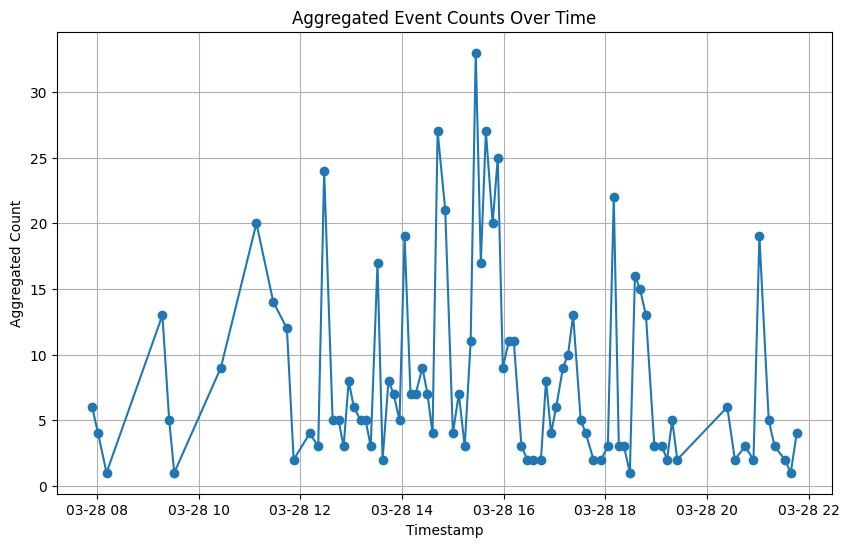

In [156]:
query = '''match (e:Event {Activity:"Producción montada"})
where e.timestamp.day = 28 and e.timestamp.month = 3 
return distinct e.timestamp, count(e)
order by e.timestamp asc'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df = df.sort_values(by='e.timestamp')

results = []

start_idx = 0
while start_idx < len(df):
    current_time = df.iloc[start_idx]['e.timestamp']
    end_idx = start_idx
    
    while end_idx + 1 < len(df) and (df.iloc[end_idx + 1]['e.timestamp'] - current_time).total_seconds() <= 300:
        end_idx += 1
    
    aggregated_count = df.iloc[start_idx:end_idx + 1]['count(e)'].sum()
    results.append((current_time, aggregated_count))
    start_idx = end_idx + 1

aggregated_df = pd.DataFrame(results, columns=['e.timestamp', 'aggregated_count'])

plt.figure(figsize=(10, 6))
plt.plot(aggregated_df['e.timestamp'], aggregated_df['aggregated_count'], marker='o')
plt.xlabel('Timestamp')
plt.ylabel('Aggregated Count')
plt.title('Aggregated Event Counts Over Time')
plt.grid(True)
plt.show()


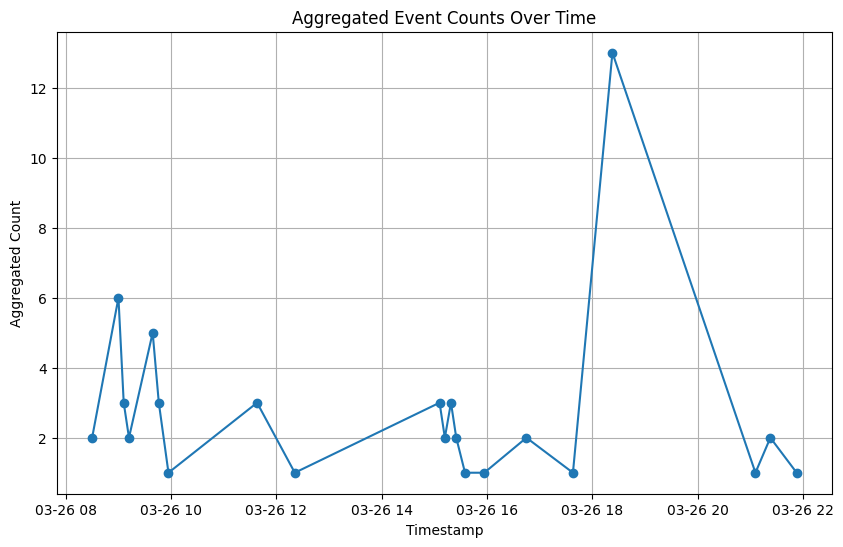

In [157]:
query = '''match (e:Event {Activity:"Montaje"})
where e.timestamp.day = 26 and e.timestamp.month = 3 
return distinct e.timestamp, count(e)
order by e.timestamp asc'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df = df.sort_values(by='e.timestamp')
results = []
start_idx = 0
while start_idx < len(df):
    current_time = df.iloc[start_idx]['e.timestamp']
    end_idx = start_idx
    
    while end_idx + 1 < len(df) and (df.iloc[end_idx + 1]['e.timestamp'] - current_time).total_seconds() <= 300:
        end_idx += 1
    
    aggregated_count = df.iloc[start_idx:end_idx + 1]['count(e)'].sum()
    results.append((current_time, aggregated_count))
    start_idx = end_idx + 1

aggregated_df = pd.DataFrame(results, columns=['e.timestamp', 'aggregated_count'])

plt.figure(figsize=(10, 6))
plt.plot(aggregated_df['e.timestamp'], aggregated_df['aggregated_count'], marker='o')
plt.xlabel('Timestamp')
plt.ylabel('Aggregated Count')
plt.title('Aggregated Event Counts Over Time')
plt.grid(True)
plt.show()


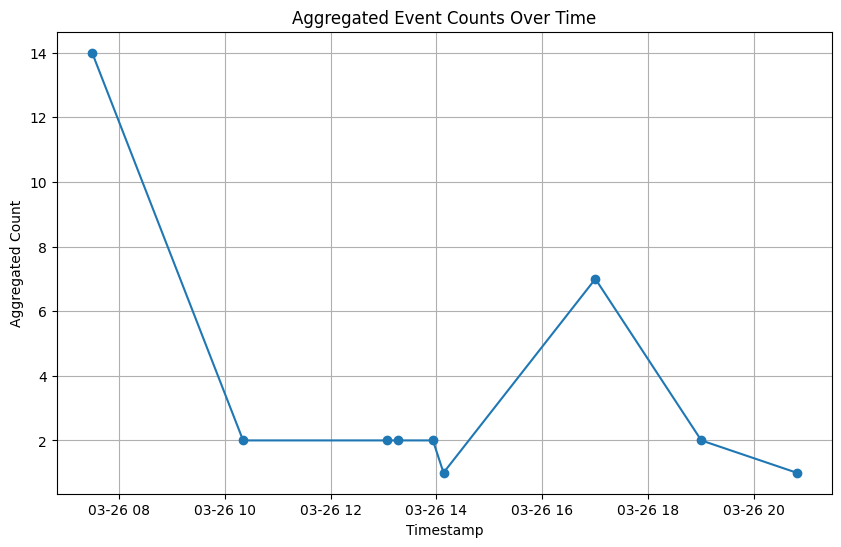

In [158]:
query = '''match (e:Event {Activity:"Entrada Material Sucio"})
where e.timestamp.day = 26 and e.timestamp.month = 3 
return distinct e.timestamp, count(e)
order by e.timestamp asc'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df = df.sort_values(by='e.timestamp')

results = []

start_idx = 0
while start_idx < len(df):
    current_time = df.iloc[start_idx]['e.timestamp']
    end_idx = start_idx
    
    while end_idx + 1 < len(df) and (df.iloc[end_idx + 1]['e.timestamp'] - current_time).total_seconds() <= 300:
        end_idx += 1
    
    aggregated_count = df.iloc[start_idx:end_idx + 1]['count(e)'].sum()
    results.append((current_time, aggregated_count))
    start_idx = end_idx + 1

aggregated_df = pd.DataFrame(results, columns=['e.timestamp', 'aggregated_count'])

plt.figure(figsize=(10, 6))
plt.plot(aggregated_df['e.timestamp'], aggregated_df['aggregated_count'], marker='o')
plt.xlabel('Timestamp')
plt.ylabel('Aggregated Count')
plt.title('Aggregated Event Counts Over Time')
plt.grid(True)
plt.show()


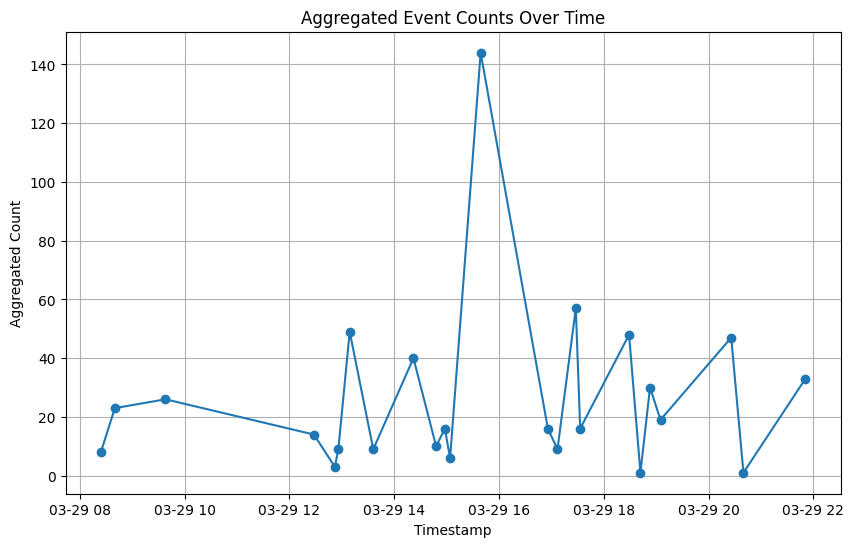

In [159]:
query = '''match (e:Event {Activity:"Composición de cargas"})
where e.timestamp.day = 29 and e.timestamp.month = 3 
return distinct e.timestamp, count(e)
order by e.timestamp asc'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df = df.sort_values(by='e.timestamp')

results = []

start_idx = 0
while start_idx < len(df):
    current_time = df.iloc[start_idx]['e.timestamp']
    end_idx = start_idx
    
    while end_idx + 1 < len(df) and (df.iloc[end_idx + 1]['e.timestamp'] - current_time).total_seconds() <= 180:
        end_idx += 1
    
    aggregated_count = df.iloc[start_idx:end_idx + 1]['count(e)'].sum()
    results.append((current_time, aggregated_count))
    start_idx = end_idx + 1

aggregated_df = pd.DataFrame(results, columns=['e.timestamp', 'aggregated_count'])

plt.figure(figsize=(10, 6))
plt.plot(aggregated_df['e.timestamp'], aggregated_df['aggregated_count'], marker='o')
plt.xlabel('Timestamp')
plt.ylabel('Aggregated Count')
plt.title('Aggregated Event Counts Over Time')
plt.grid(True)
plt.show()


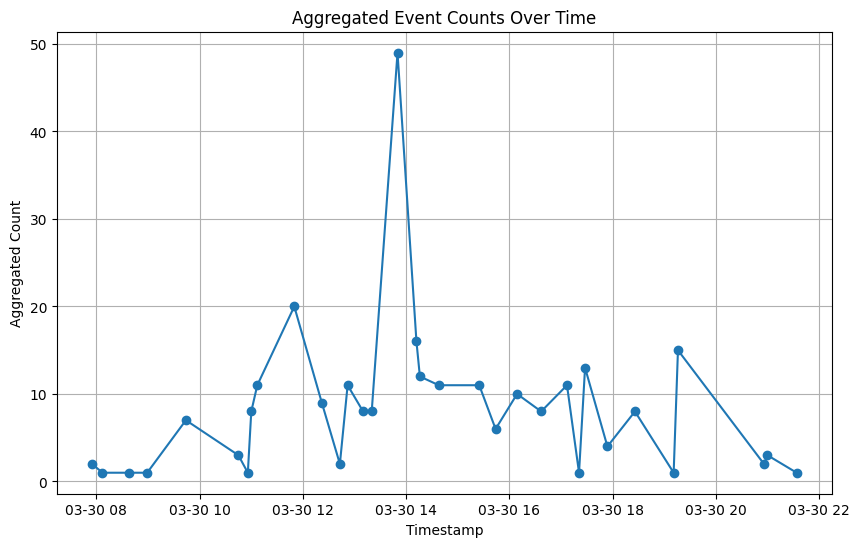

In [160]:
query = '''match (e:Event {Activity:"Carga L+D iniciada"})
where e.timestamp.day = 30 and e.timestamp.month = 3 
return distinct e.timestamp, count(e)
order by e.timestamp asc'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df = df.sort_values(by='e.timestamp')

results = []

start_idx = 0
while start_idx < len(df):
    current_time = df.iloc[start_idx]['e.timestamp']
    end_idx = start_idx
    
    while end_idx + 1 < len(df) and (df.iloc[end_idx + 1]['e.timestamp'] - current_time).total_seconds() <= 180:
        end_idx += 1
    
    aggregated_count = df.iloc[start_idx:end_idx + 1]['count(e)'].sum()
    results.append((current_time, aggregated_count))
    
    start_idx = end_idx + 1

aggregated_df = pd.DataFrame(results, columns=['e.timestamp', 'aggregated_count'])

plt.figure(figsize=(10, 6))
plt.plot(aggregated_df['e.timestamp'], aggregated_df['aggregated_count'], marker='o')
plt.xlabel('Timestamp')
plt.ylabel('Aggregated Count')
plt.title('Aggregated Event Counts Over Time')
plt.grid(True)
plt.show()


In [6]:
query = '''match (e:Event)
return e.Usuario, e.timestamp'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df['date'] = df['e.timestamp'].dt.date

result = df.groupby(['e.Usuario', 'date']).agg(first_event=('e.timestamp', 'min'), last_event=('e.timestamp', 'max')).reset_index()
result.head()


    e.Usuario        date               first_event                last_event
0          AV  2022-01-03 2022-01-03 14:49:00+00:00 2022-01-03 21:15:00+00:00
1          AV  2022-01-04 2022-01-04 14:47:00+00:00 2022-01-04 21:49:00+00:00
2          AV  2022-01-05 2022-01-05 14:55:00+00:00 2022-01-05 21:35:00+00:00
3          AV  2022-01-07 2022-01-07 14:47:00+00:00 2022-01-07 21:51:00+00:00
4          AV  2022-01-10 2022-01-10 13:21:00+00:00 2022-01-10 19:05:00+00:00
..        ...         ...                       ...                       ...
907        VS  2022-03-25 2022-03-25 08:01:00+00:00 2022-03-25 14:25:00+00:00
908        VS  2022-03-28 2022-03-28 12:10:00+00:00 2022-03-28 19:28:00+00:00
909        VS  2022-03-29 2022-03-29 12:47:00+00:00 2022-03-29 19:04:00+00:00
910        VS  2022-03-30 2022-03-30 08:14:00+00:00 2022-03-30 14:01:00+00:00
911        VS  2022-03-31 2022-03-31 12:13:00+00:00 2022-03-31 19:21:00+00:00

[912 rows x 4 columns]


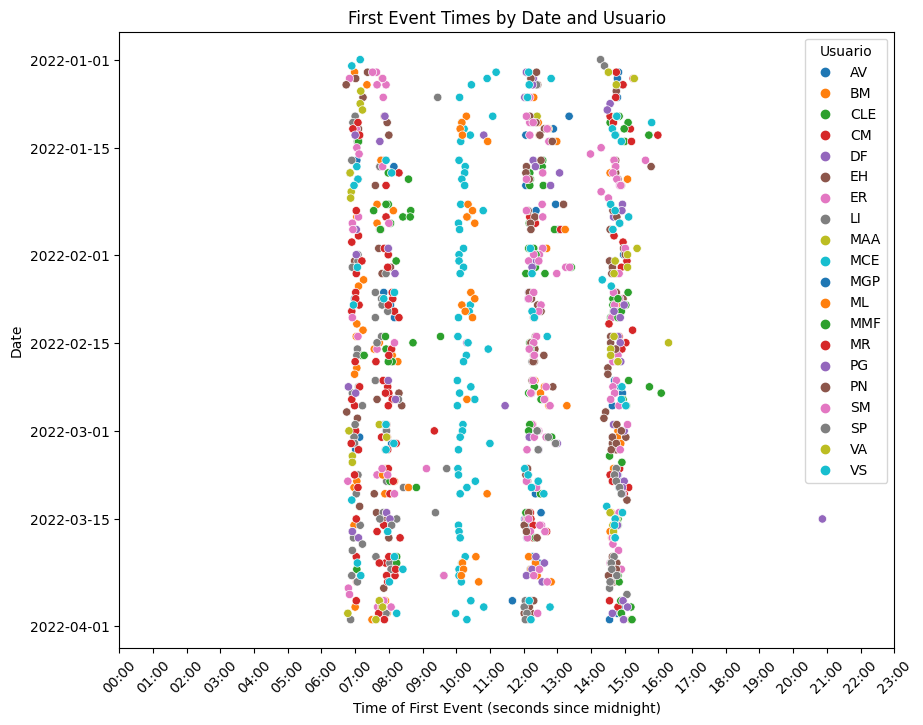

In [162]:
result['first_event_seconds'] = result['first_event'].dt.hour * 3600 + result['first_event'].dt.minute * 60 + result['first_event'].dt.second

plt.figure(figsize=(10, 8))
sns.scatterplot(data=result, x='first_event_seconds', y='date', hue='e.Usuario', palette='tab10')

plt.title('First Event Times by Date and Usuario')
plt.xlabel('Time of First Event (seconds since midnight)')
plt.ylabel('Date')
plt.xticks(
    ticks=np.arange(0, 24*3600, 3600),
    labels=[f"{h:02d}:00" for h in range(24)],
    rotation=45
)
plt.legend(title='Usuario')
plt.show()

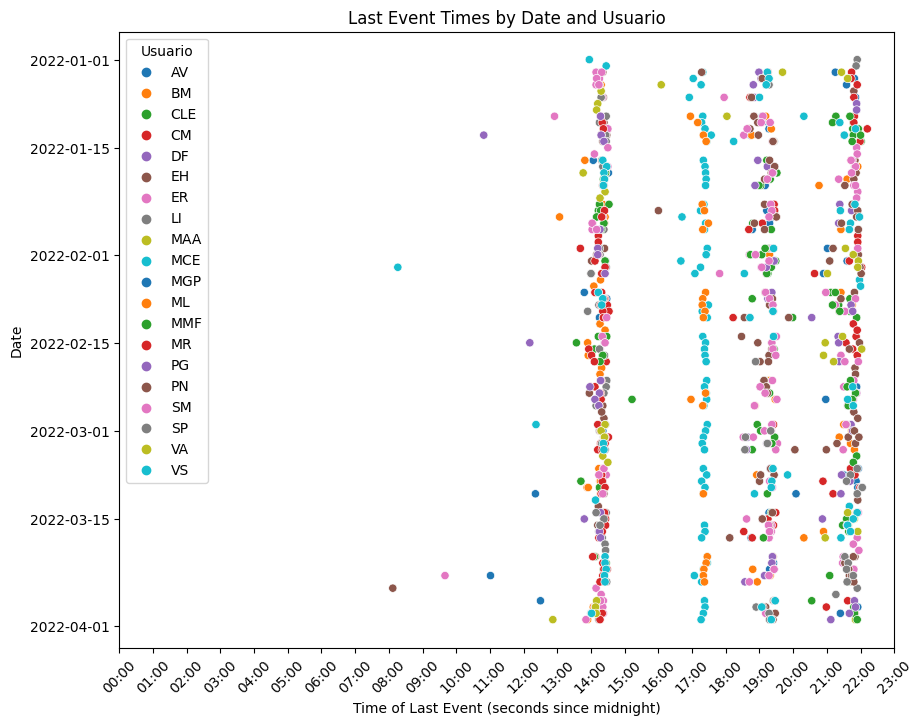

In [163]:
result['last_event_seconds'] = result['last_event'].dt.hour * 3600 + result['last_event'].dt.minute * 60 + result['last_event'].dt.second

plt.figure(figsize=(10, 8))
sns.scatterplot(data=result, x='last_event_seconds', y='date', hue='e.Usuario', palette='tab10')
plt.title('Last Event Times by Date and Usuario')
plt.xlabel('Time of Last Event (seconds since midnight)')
plt.ylabel('Date')
plt.xticks(
    ticks=np.arange(0, 24*3600, 3600),
    labels=[f"{h:02d}:00" for h in range(24)],
    rotation=45
)
plt.legend(title='Usuario')
plt.show()

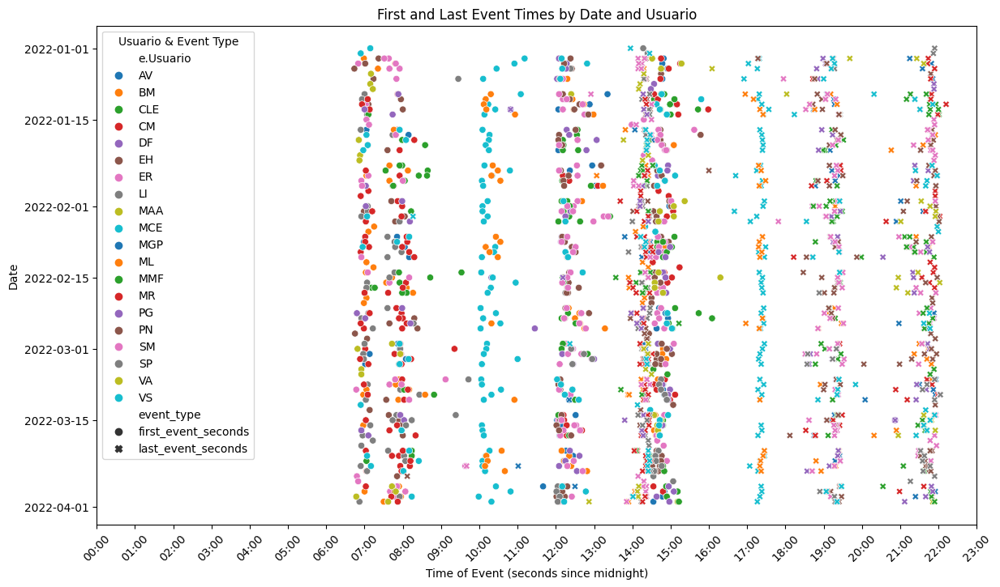

In [164]:
df_melted = pd.melt(result, id_vars=['e.Usuario', 'date'], value_vars=['first_event_seconds', 'last_event_seconds'], 
                    var_name='event_type', value_name='event_time_seconds')

plt.figure(figsize=(14, 8))
sns.scatterplot(data=df_melted, x='event_time_seconds', y='date', hue='e.Usuario', style='event_type', markers={'first_event_seconds': 'o', 'last_event_seconds': 'X'}, palette='tab10')

plt.title('First and Last Event Times by Date and Usuario')
plt.xlabel('Time of Event (seconds since midnight)')
plt.ylabel('Date')
plt.xticks(
    ticks=np.arange(0, 24*3600, 3600),
    labels=[f"{h:02d}:00" for h in range(24)],
    rotation=45
)
plt.legend(title='Usuario & Event Type')
plt.show()

In [165]:
query = '''match (r:Run {EntityType: 'Kit'}) <- [:CORR] - (e:Event)
where not e.KitID contains "CONT"
return e.Usuario, e.timestamp, e.Activity, e.KitID, e.NS, e.Código, r.CaseID'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df['date'] = df['e.timestamp'].dt.date
df['day_of_week'] = df['e.timestamp'].dt.dayofweek

weekdays_df = df[df['day_of_week'] < 5]
weekends_df = df[df['day_of_week'] >= 5]
weekdays_df = weekdays_df.drop(columns=['day_of_week'])
weekends_df = weekends_df.drop(columns=['day_of_week'])
weekends_df = weekends_df.append(weekdays_df[pd.to_datetime(weekdays_df['date']) == pd.to_datetime('2022-01-06', format='%Y-%m-%d')], ignore_index=True)
weekdays_df = weekdays_df[pd.to_datetime(weekdays_df['date']) != pd.to_datetime('2022-01-06', format='%Y-%m-%d')]


In [166]:
grouped2 = df.groupby(['e.Activity', 'e.timestamp']).size().reset_index(name='count')
stats = grouped2.groupby(['e.Activity'])['count'].describe()
print(stats)

                                   count       mean        std  min  25%  \
e.Activity                                                                 
Carga L+D iniciada                2205.0   5.664399   5.106118  1.0  1.0   
Carga L+D liberada                1783.0   6.559731   5.330459  1.0  2.0   
Carga de esterilizador liberada   1487.0  25.016140  28.646516  1.0  9.0   
Cargado en carro L+D              5605.0   2.251204   1.989368  1.0  1.0   
Comisionado                       1494.0  15.340696  26.963293  1.0  2.0   
Composición de cargas             2587.0  14.614612  17.578030  1.0  4.0   
Entrada Material Sucio            1933.0   5.023797   4.544973  1.0  1.0   
Montaje                          14819.0   1.582023   1.005956  1.0  1.0   
Producción montada               14565.0   2.604257   3.078517  1.0  1.0   

                                  50%   75%    max  
e.Activity                                          
Carga L+D iniciada                4.0   9.0   51.0  
Carg

In [167]:
grouped2_filtered = grouped2[grouped2['count'] < 32]
stats = grouped2_filtered.groupby(['e.Activity'])['count'].describe()
print(stats)

                                   count       mean       std  min  25%   50%  \
e.Activity                                                                      
Carga L+D iniciada                2198.0   5.560965  4.759550  1.0  1.0   4.0   
Carga L+D liberada                1776.0   6.442568  4.986638  1.0  2.0   6.0   
Carga de esterilizador liberada   1114.0  12.209156  7.616851  1.0  6.0  12.0   
Cargado en carro L+D              5605.0   2.251204  1.989368  1.0  1.0   2.0   
Comisionado                       1265.0   5.588933  6.214408  1.0  1.0   3.0   
Composición de cargas             2286.0   9.576553  7.444267  1.0  3.0   8.0   
Entrada Material Sucio            1933.0   5.023797  4.544973  1.0  1.0   3.0   
Montaje                          14819.0   1.582023  1.005956  1.0  1.0   1.0   
Producción montada               14556.0   2.581204  2.933583  1.0  1.0   1.0   

                                  75%   max  
e.Activity                                   
Carga L+D inicia

In [168]:
grouped2 = weekdays_df.groupby(['e.Activity', 'e.timestamp']).size().reset_index(name='count')

grouped2_filtered = grouped2[grouped2['count'] > 1]
grouped2_filtered = grouped2_filtered[grouped2_filtered['count'] < 20]
stats = grouped2_filtered.groupby(['e.Activity'])['count'].describe()
print(stats)


#                                  count       mean       std  min  25%   50%  \
# e.Activity                                                                     
# Carga L+D iniciada               1418.0   7.825106  4.456536  2.0  4.0   7.0   
# Carga L+D liberada               1286.0   8.232504  4.614601  2.0  5.0   8.0   
# Carga de esterilizador liberada   879.0  12.889647  6.522983  2.0  9.0  12.0   
# Cargado en carro L+D             2821.0   3.387806  2.230808  2.0  2.0   3.0   
# Comisionado                       709.0   7.427362  6.282375  2.0  3.0   5.0   
# Composición de cargas            1778.0  10.550619  6.621954  2.0  5.0   9.5   
# Entrada Material Sucio           1343.0   6.588235  4.523106  2.0  3.0   5.0   
# Montaje                          4981.0   2.671552  1.060107  2.0  2.0   2.0   
# Producción montada               6259.0   4.400383  3.454647  2.0  2.0   3.0   

#                                   75%   max  
# e.Activity                                   
# Carga L+D iniciada               10.0  29.0  
# Carga L+D liberada               11.0  29.0  
# Carga de esterilizador liberada  17.0  29.0  
# Cargado en carro L+D              4.0  29.0  
# Comisionado                      10.0  29.0  
# Composición de cargas            14.0  29.0  
# Entrada Material Sucio            9.0  26.0  
# Montaje                           3.0  11.0  
# Producción montada                5.0  29.0  


                                  count       mean       std  min  25%   50%  \
e.Activity                                                                     
Carga L+D iniciada               1386.0   7.463203  3.787365  2.0  4.0   7.0   
Carga L+D liberada               1250.0   7.792000  3.836523  2.0  5.0   7.0   
Carga de esterilizador liberada   727.0  10.686382  4.663393  2.0  8.0  11.0   
Cargado en carro L+D             2812.0   3.325747  1.940012  2.0  2.0   3.0   
Comisionado                       654.0   6.077982  4.313699  2.0  3.0   5.0   
Composición de cargas            1582.0   8.881163  4.794292  2.0  5.0   9.0   
Entrada Material Sucio           1326.0   6.384615  4.172131  2.0  3.0   5.0   
Montaje                          4981.0   2.671552  1.060107  2.0  2.0   2.0   
Producción montada               6201.0   4.236575  3.015068  2.0  2.0   3.0   

                                  75%   max  
e.Activity                                   
Carga L+D iniciada         

            date          e.Activity e.Usuario  average_count  max_count
0     2022-01-03  Carga L+D iniciada        BM       1.500000          2
1     2022-01-03  Carga L+D iniciada        EH       3.300000          8
2     2022-01-03  Carga L+D iniciada       MAA       4.170732         11
3     2022-01-03  Carga L+D iniciada        MR       1.500000          2
4     2022-01-03  Carga L+D iniciada        PN       1.000000          1
...          ...                 ...       ...            ...        ...
4566  2022-03-31  Producción montada        PN       7.558140         33
4567  2022-03-31  Producción montada        SM      19.562500         59
4568  2022-03-31  Producción montada        SP       9.222222         32
4569  2022-03-31  Producción montada        VA       2.000000          4
4570  2022-03-31  Producción montada        VS      26.088889         60

[4571 rows x 5 columns]


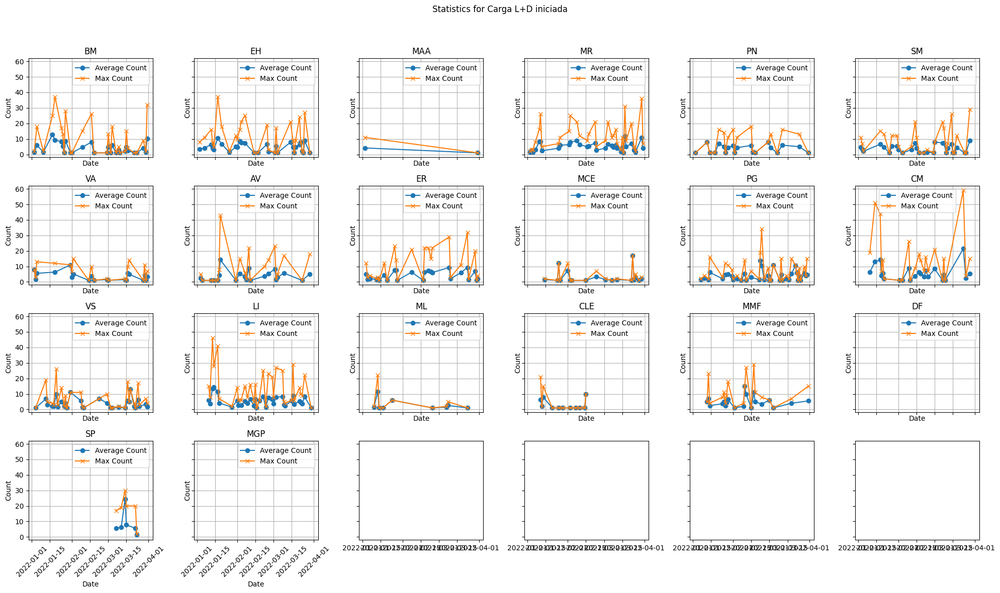

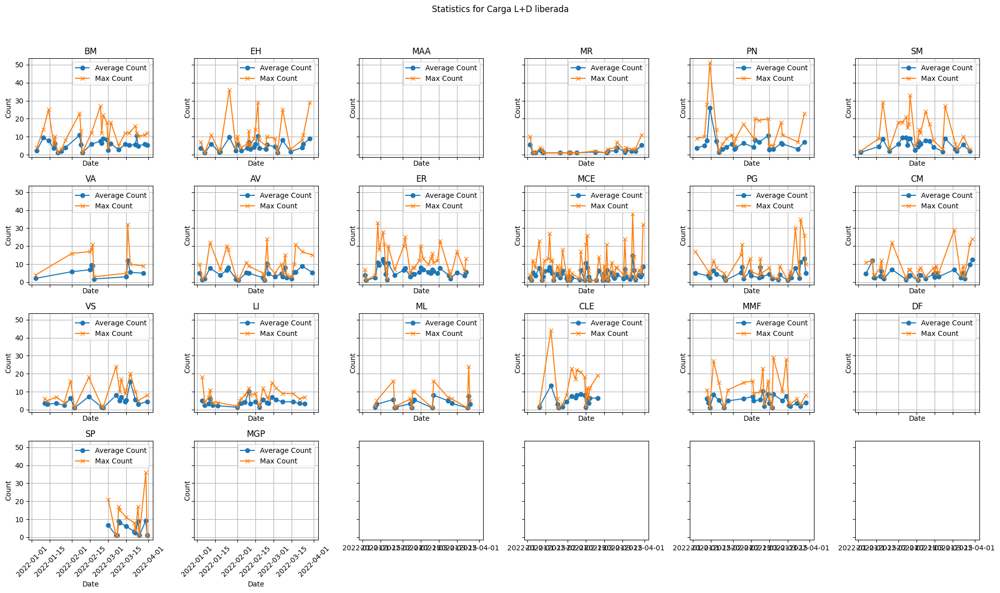

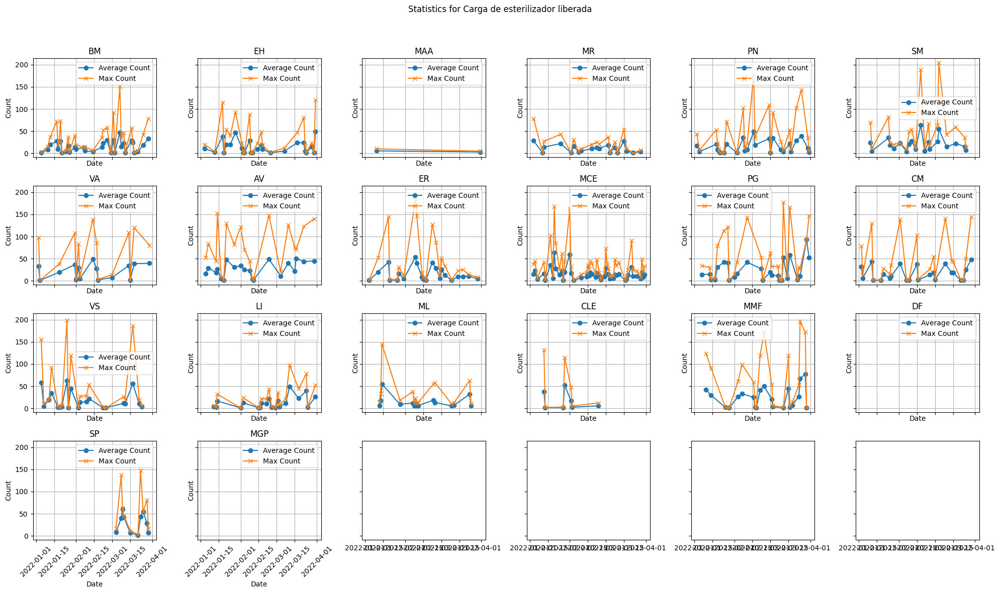

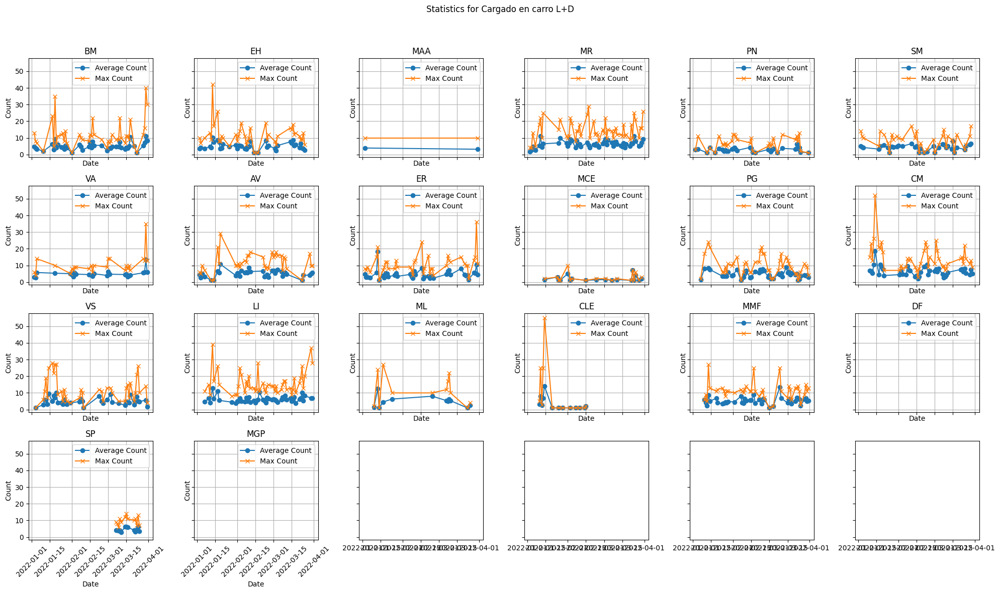

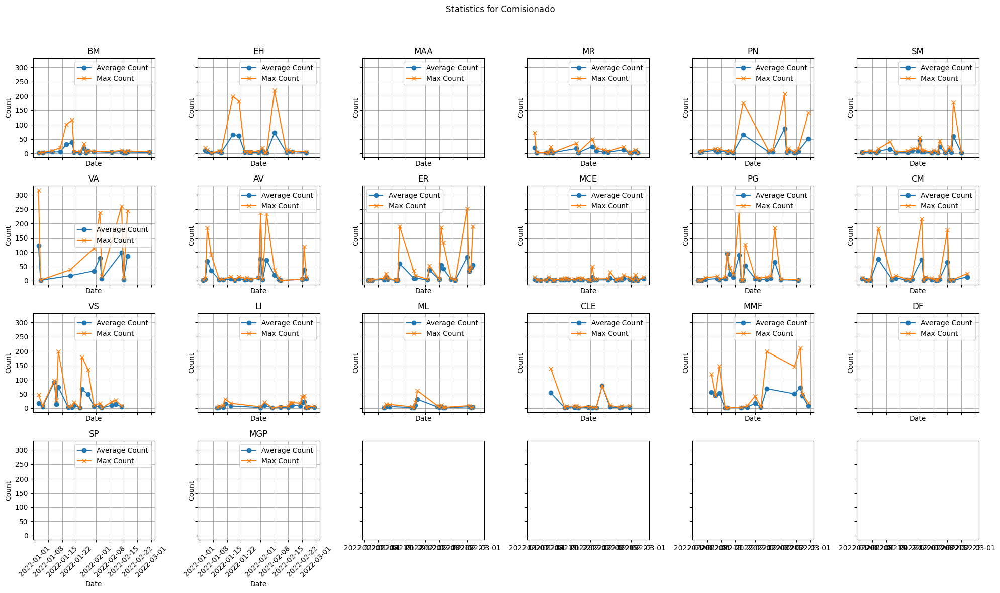

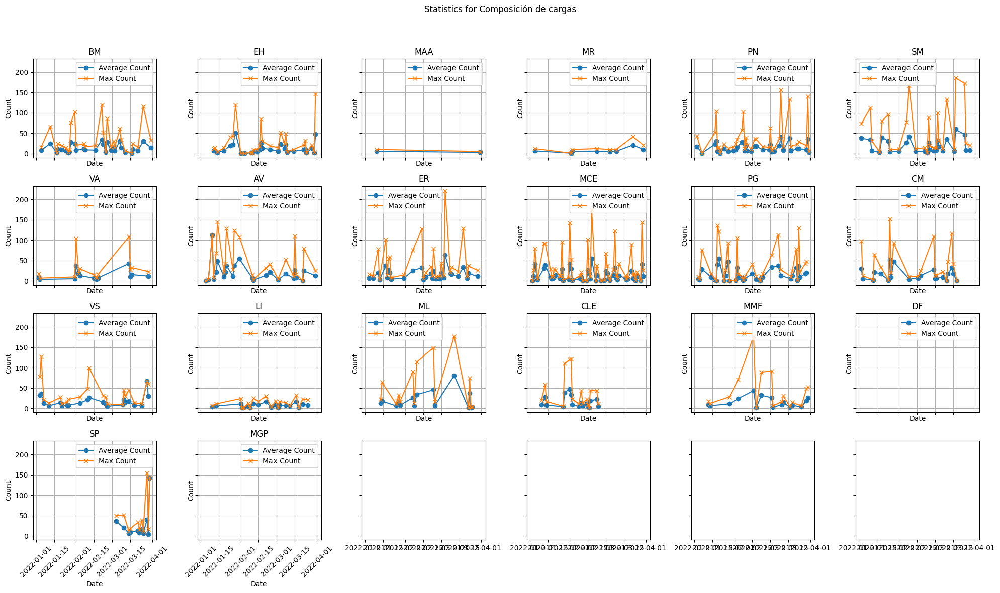

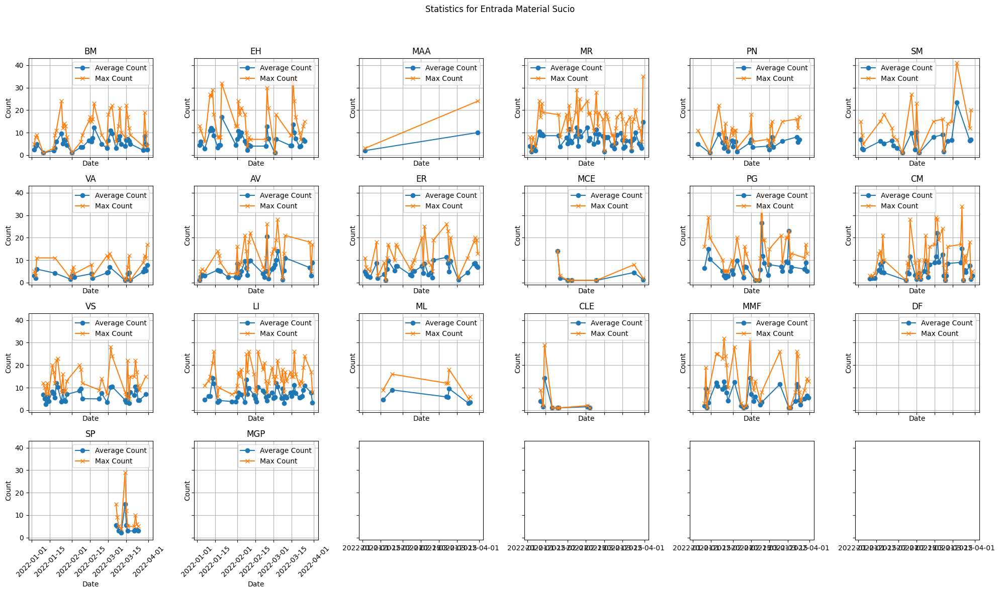

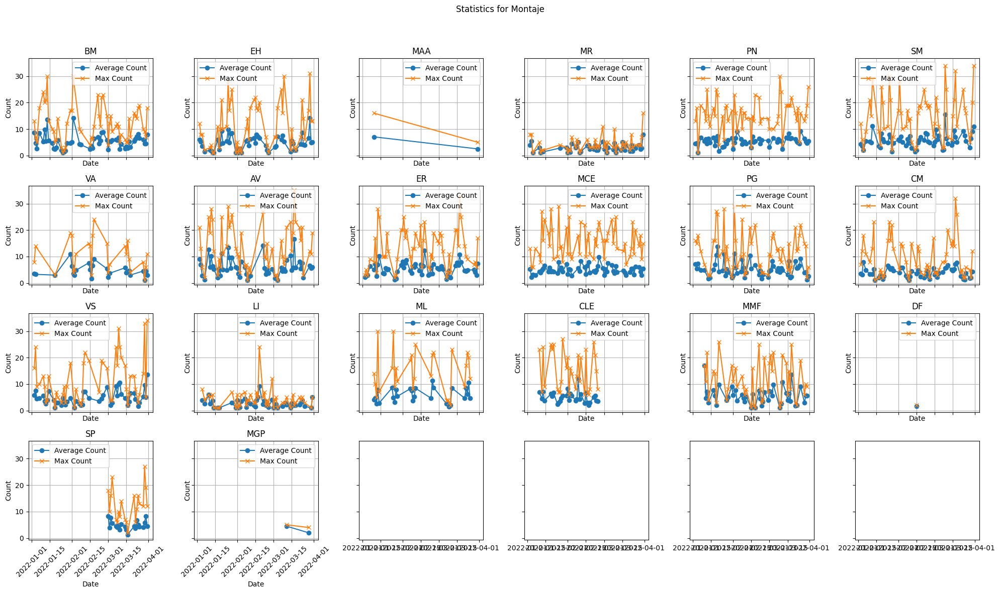

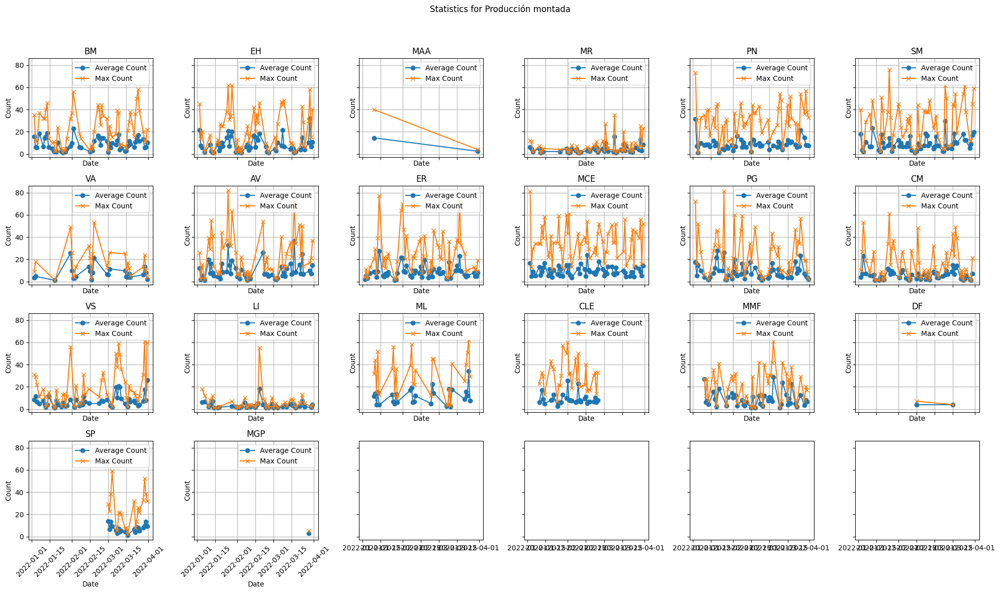

In [169]:
grouped2 = weekdays_df.groupby(['date', 'e.Activity'])
grouped2 = grouped2.apply(count_within_intervals).reset_index(drop=True)

stats = grouped2.groupby(['date', 'e.Activity', 'e.Usuario'])['count'].agg(['mean', 'max']).reset_index()
stats.columns = ['date', 'e.Activity', 'e.Usuario' , 'average_count', 'max_count']
print(stats)

activities = stats['e.Activity'].unique()
usuarios = stats['e.Usuario'].unique()
n_rows = 4  
n_cols = 6  

for activity in activities:
    activity_data = stats[stats['e.Activity'] == activity]
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 12), sharex=True, sharey=True)
    axes = axes.flatten()
    
    for i, usuario in enumerate(usuarios):
        ax = axes[i]
        activity_data2 = activity_data[activity_data['e.Usuario'] == usuario]
        ax.plot(activity_data2['date'], activity_data2['average_count'], marker='o', label='Average Count')
        ax.plot(activity_data2['date'], activity_data2['max_count'], marker='x', label='Max Count')
        ax.set_title(f'{usuario}')
        ax.set_xlabel('Date')
        ax.set_ylabel('Count')
        ax.legend()
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True)
    
    plt.suptitle(f'Statistics for {activity}')
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

In [171]:
grouped2 = weekdays_df.groupby(['date', 'e.Activity'])
grouped2 = grouped2.apply(count_within_intervals)
grouped2.head()

e.Usuario               e.timestamp  \
date       e.Activity                                                     
2022-01-03 Carga L+D iniciada 87824        EH 2022-01-03 07:59:00+00:00   
                              87805        EH 2022-01-03 07:59:00+00:00   
                              87817        EH 2022-01-03 07:59:00+00:00   
                              87834        EH 2022-01-03 07:59:00+00:00   
                              87843        EH 2022-01-03 07:59:00+00:00   

                                             e.Activity         e.KitID  e.NS  \
date       e.Activity                                                           
2022-01-03 Carga L+D iniciada 87824  Carga L+D iniciada   HNB-GIN.009-3     3   
                              87805  Carga L+D iniciada   HNB-GIN.014-8     8   
                              87817  Carga L+D iniciada    HNB-CG.003-1     1   
                              87834  Carga L+D iniciada  HUBU-URG.005-4     4   
                              87843  Carga L+D iniciada  HUBU-URG.005-3     3   

                                         e.Código              r.CaseID  \
date       e.Activity                                                     
2022-01-03 Carga L+D iniciada 87824   HNB-GIN.009   HNB-GIN.009-3-CN259   
                              87805   HNB-GIN.014   HNB-GIN.014-8-CN256   
                              87817    HNB-CG.003    HNB-CG.003-1-CN258   
                              87834  HUBU-URG.005  HUBU-URG.005-4-CN253   
                              87843  HUBU-URG.005  HUBU-URG.005-3-CN254   

                                           date  count  
date       e.Activity                                   
2022-01-03 Carga L+D iniciada 87824  2022-01-03      1  
                              87805  2022-01-03      2  
                              87817  2022-01-03      3  
                              87834  2022-01-03      4  
                              87843  2022-01-03      5

In [172]:
grouped2 = weekends_df.groupby(['e.Activity', 'e.timestamp']).size().reset_index(name='count')
stats = grouped2.groupby(['e.Activity'])['count'].describe()
print(stats)

                                  count       mean        std  min  25%   50%  \
e.Activity                                                                      
Carga L+D iniciada                306.0   2.133987   1.721138  1.0  1.0   1.0   
Carga L+D liberada                255.0   2.317647   1.806888  1.0  1.0   2.0   
Carga de esterilizador liberada   158.0  17.481013  16.648759  1.0  5.0  12.0   
Cargado en carro L+D              344.0   1.805233   1.335707  1.0  1.0   1.0   
Comisionado                       275.0   7.821818  13.117419  1.0  2.0   3.0   
Composición de cargas             211.0  12.995261  12.014871  1.0  4.0   9.0   
Entrada Material Sucio            177.0   2.372881   1.811249  1.0  1.0   2.0   
Montaje                          1064.0   1.281015   0.626310  1.0  1.0   1.0   
Producción montada               1033.0   2.621491   3.143377  1.0  1.0   1.0   

                                  75%   max  
e.Activity                                   
Carga L+D inicia

           date                       e.Activity  average_count  max_count
0    2022-01-01               Carga L+D iniciada       1.583333          5
1    2022-01-01               Carga L+D liberada       1.727273          5
2    2022-01-01  Carga de esterilizador liberada      17.500000         33
3    2022-01-01             Cargado en carro L+D       1.466667          5
4    2022-01-01                      Comisionado       5.785714         47
..          ...                              ...            ...        ...
230  2022-03-27             Cargado en carro L+D       1.538462          3
231  2022-03-27            Composición de cargas      13.500000         43
232  2022-03-27           Entrada Material Sucio       1.875000          5
233  2022-03-27                          Montaje       1.428571          3
234  2022-03-27               Producción montada       2.942857         16

[235 rows x 4 columns]


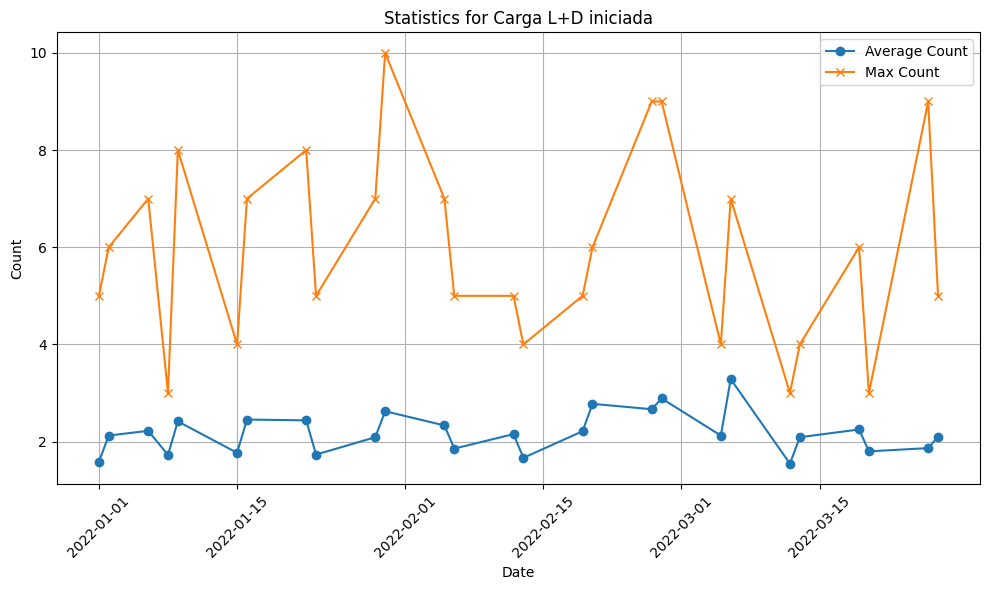

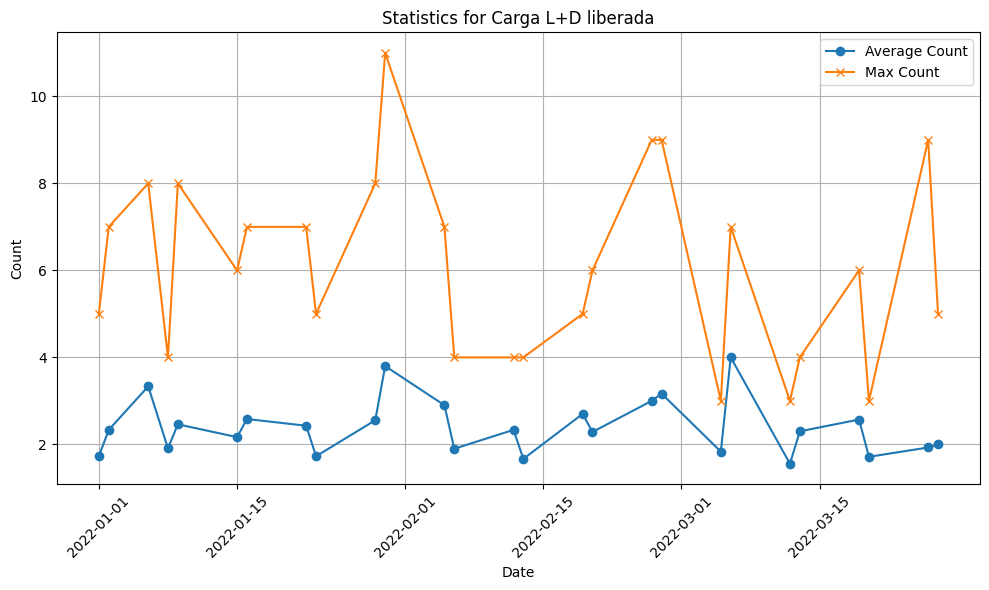

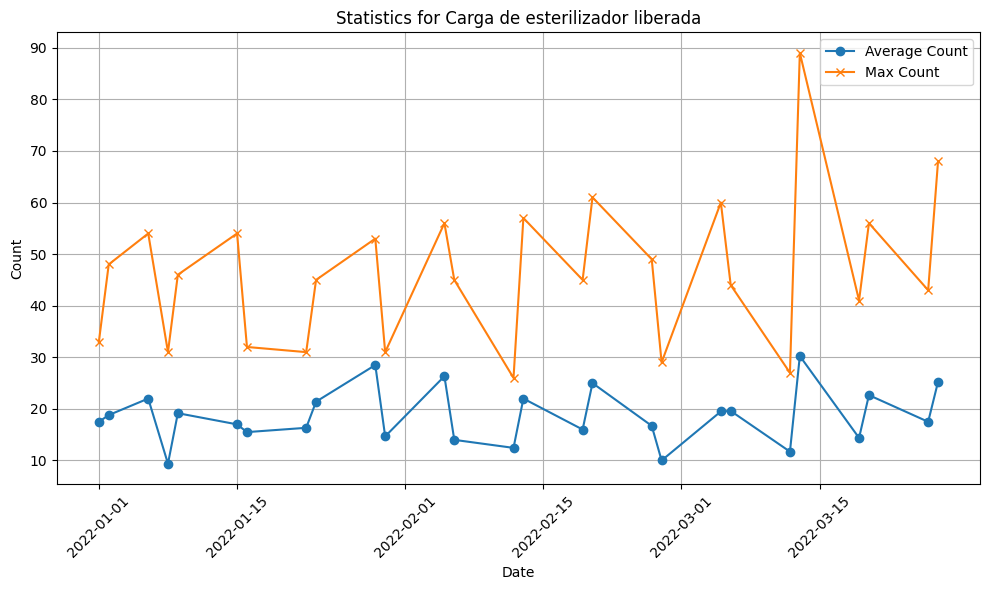

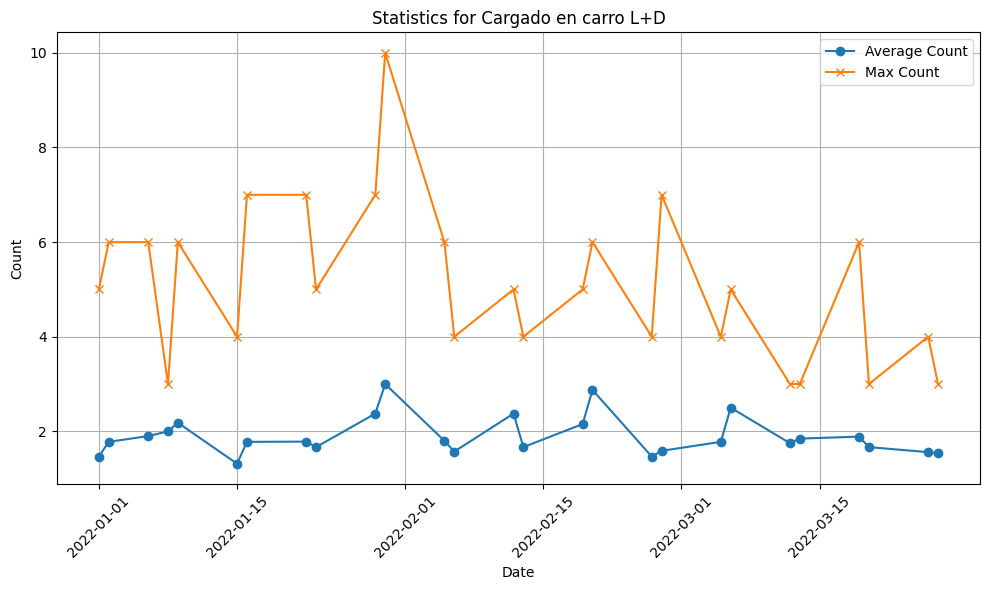

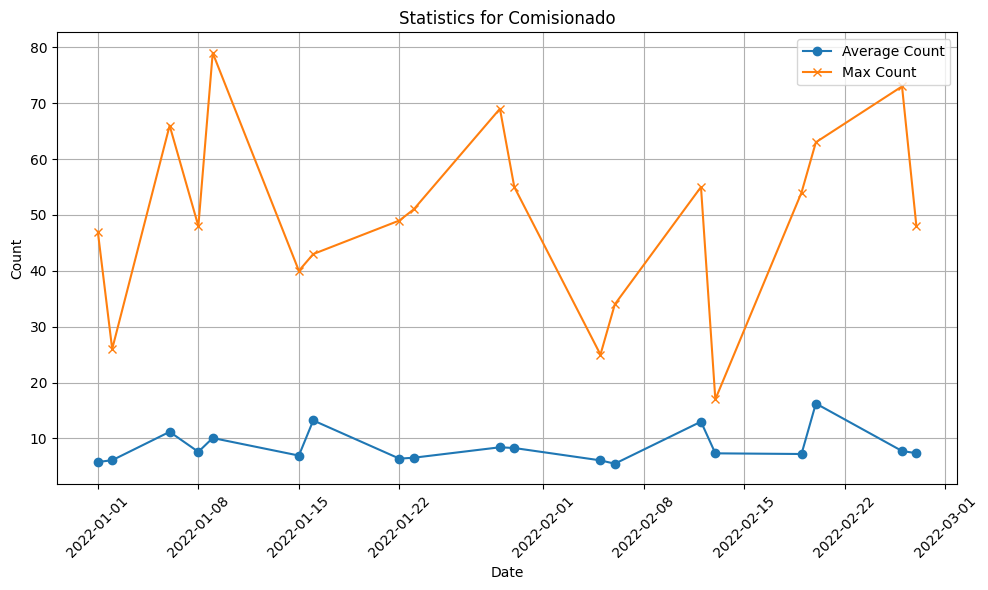

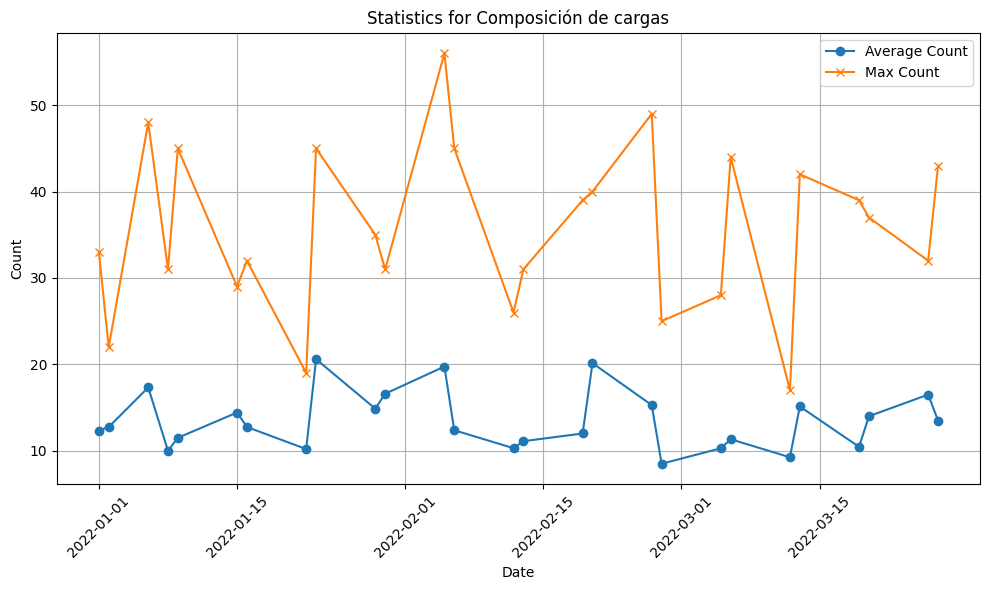

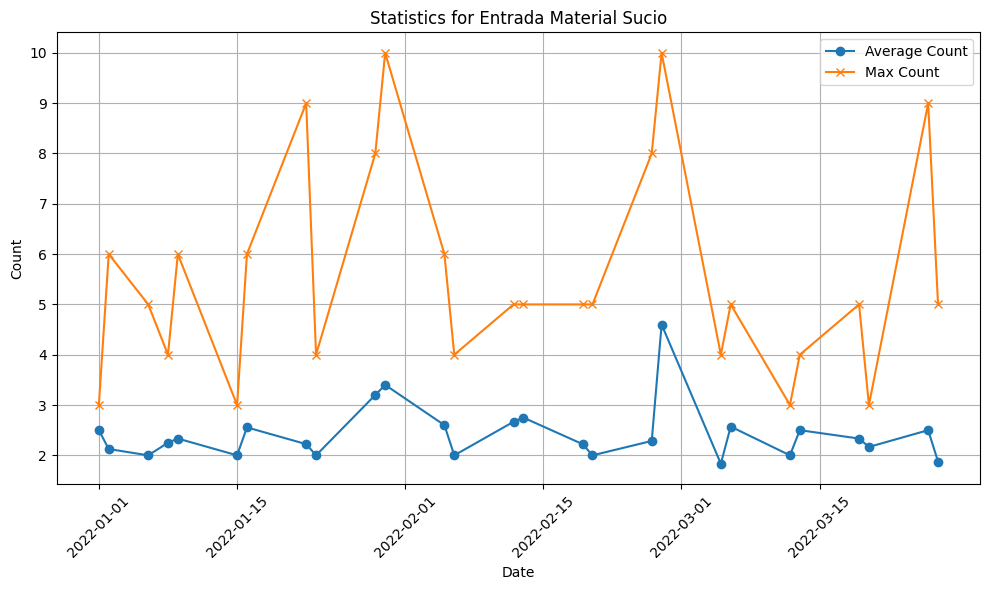

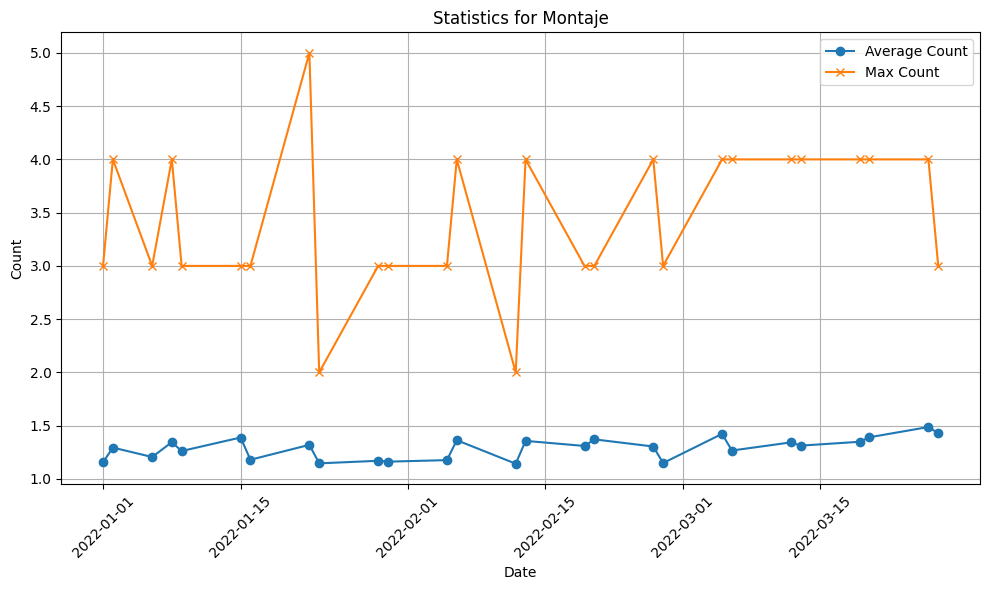

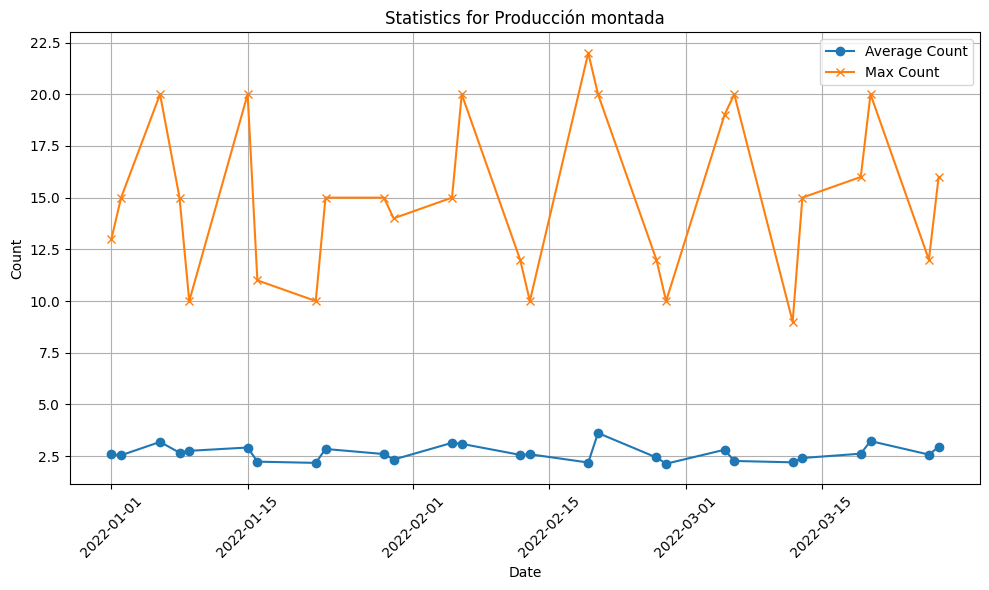

In [173]:
grouped2 = weekends_df.groupby(['date', 'e.Activity', 'e.timestamp']).size().reset_index(name='count')

stats = grouped2.groupby(['date', 'e.Activity'])['count'].agg(['mean', 'max']).reset_index()
stats.columns = ['date', 'e.Activity', 'average_count', 'max_count']
print(stats)

activities = stats['e.Activity'].unique()
for activity in activities:
    activity_data = stats[stats['e.Activity'] == activity]
    plt.figure(figsize=(10, 6))
    plt.plot(activity_data['date'], activity_data['average_count'], marker='o', label='Average Count')
    plt.plot(activity_data['date'], activity_data['max_count'], marker='x', label='Max Count')
    plt.title(f'Statistics for {activity}')
    plt.xlabel('Date')
    plt.ylabel('Count')
    plt.legend()
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [174]:
entrada_material_df = weekdays_df[weekdays_df['e.Activity'] == 'Entrada Material Sucio']
entrada_material_df = entrada_material_df.sort_values(by='e.timestamp')

grouped = entrada_material_df.groupby('date')

stats = []

for date, group in grouped:
    group = group.sort_values(by='e.timestamp')
    group['time_diff'] = group['e.timestamp'].diff()
    group['time_diff_minutes'] = group['time_diff'].dt.total_seconds() / 60
    average_diff = group['time_diff_minutes'].mean()
    std_diff = group['time_diff_minutes'].std()
    stats.append({'date': date, 'average_time_diff_minutes': average_diff, 'std_time_diff_minutes': std_diff})

stats_df = pd.DataFrame(stats)
print(stats_df)

          date  average_time_diff_minutes  std_time_diff_minutes
0   2022-01-03                   8.181818              22.393834
1   2022-01-04                  10.818182              26.808643
2   2022-01-05                   8.903614              26.794891
3   2022-01-07                  10.868421              32.047191
4   2022-01-10                   7.598131              28.321223
..         ...                        ...                    ...
58  2022-03-25                   5.818841              21.168850
59  2022-03-28                   3.804020              14.094443
60  2022-03-29                   4.426230              14.995742
61  2022-03-30                   4.549708              14.459747
62  2022-03-31                   3.904040              16.021429

[63 rows x 3 columns]


In [175]:
entrada_material_df = weekends_df[weekends_df['e.Activity'] == 'Entrada Material Sucio']
entrada_material_df = entrada_material_df.sort_values(by='e.timestamp')

grouped = entrada_material_df.groupby('date')

stats = []

for date, group in grouped:
    group = group.sort_values(by='e.timestamp')
    group['time_diff'] = group['e.timestamp'].diff()
    group['time_diff_minutes'] = group['time_diff'].dt.total_seconds() / 60
    average_diff = group['time_diff_minutes'].mean()
    std_diff = group['time_diff_minutes'].std()
    stats.append({'date': date, 'average_time_diff_minutes': average_diff, 'std_time_diff_minutes': std_diff})

stats_df = pd.DataFrame(stats)
print(stats_df)

          date  average_time_diff_minutes  std_time_diff_minutes
0   2022-01-01                  85.555556             217.578785
1   2022-01-02                  52.187500             102.302309
2   2022-01-06                  34.363636              88.581344
3   2022-01-08                  97.125000             140.728145
4   2022-01-09                  49.846154             105.188597
5   2022-01-15                  63.384615             118.879868
6   2022-01-16                  33.136364              69.927374
7   2022-01-22                  37.000000              85.366530
8   2022-01-23                  72.909091             133.428973
9   2022-01-29                  52.066667             114.353129
10  2022-01-30                  48.937500             110.525695
11  2022-02-05                  63.333333             141.837508
12  2022-02-06                  55.933333              92.539155
13  2022-02-12                  51.733333             114.412454
14  2022-02-13           

In [176]:
print(stats_df['average_time_diff_minutes'].describe())
print(stats_df['std_time_diff_minutes'].describe())

count    27.000000
mean     55.762468
std      15.940859
min      33.136364
25%      45.167183
50%      52.187500
75%      63.358974
max      97.125000
Name: average_time_diff_minutes, dtype: float64
count     27.000000
mean     109.186963
std       30.448755
min       68.053900
25%       90.289941
50%      105.188597
75%      119.513908
max      217.578785
Name: std_time_diff_minutes, dtype: float64


No handles with labels found to put in legend.


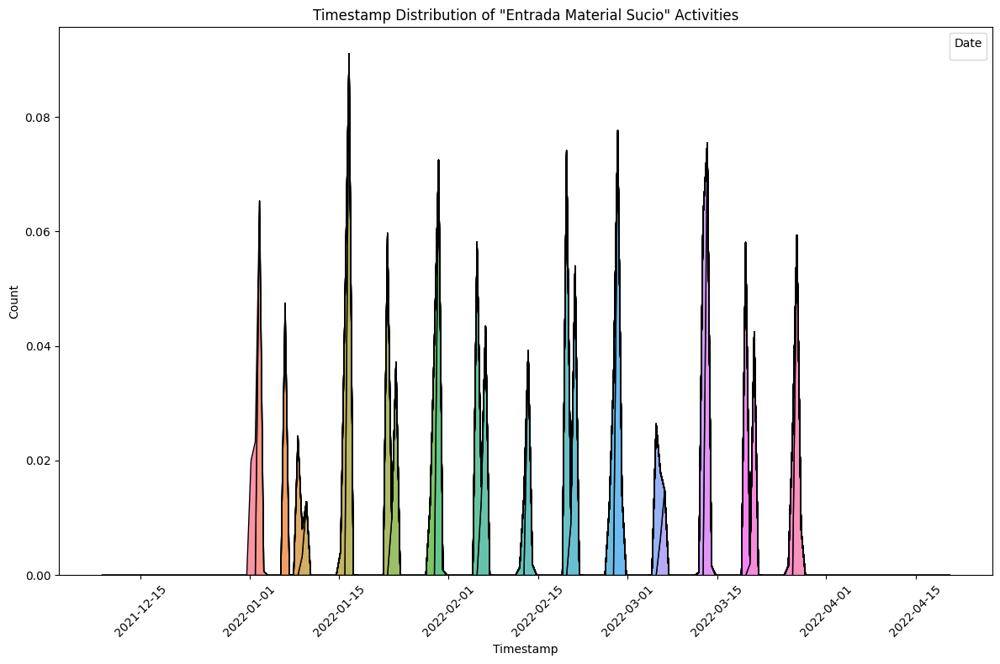

In [177]:
plt.figure(figsize=(12, 8))
sns.kdeplot(data=entrada_material_df, x='e.timestamp', hue='date', multiple='stack')
plt.title('Timestamp Distribution of "Entrada Material Sucio" Activities')
plt.xlabel('Timestamp')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

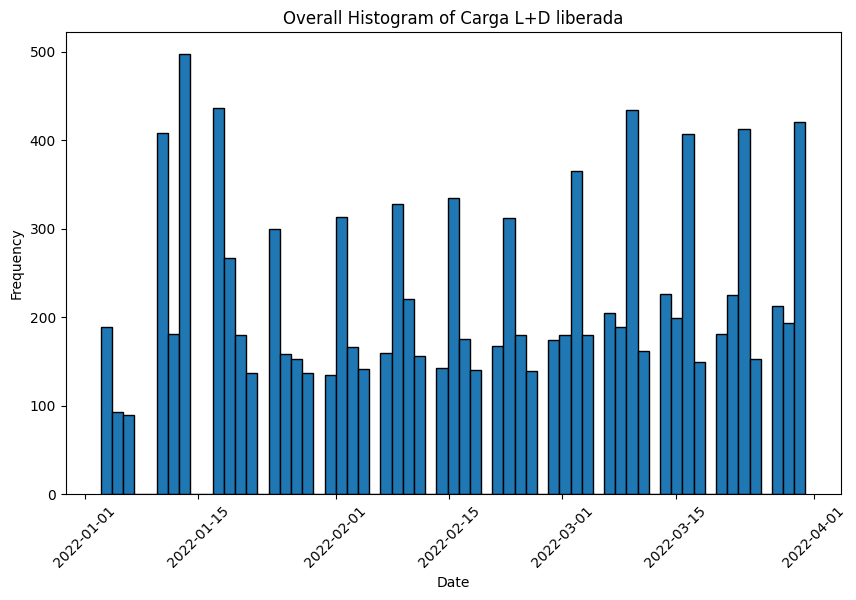

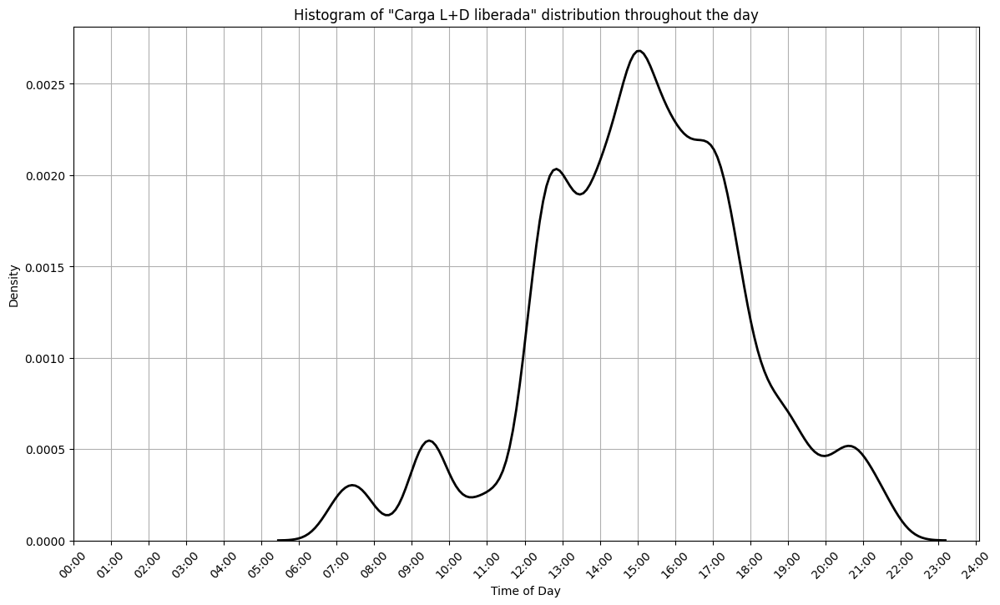

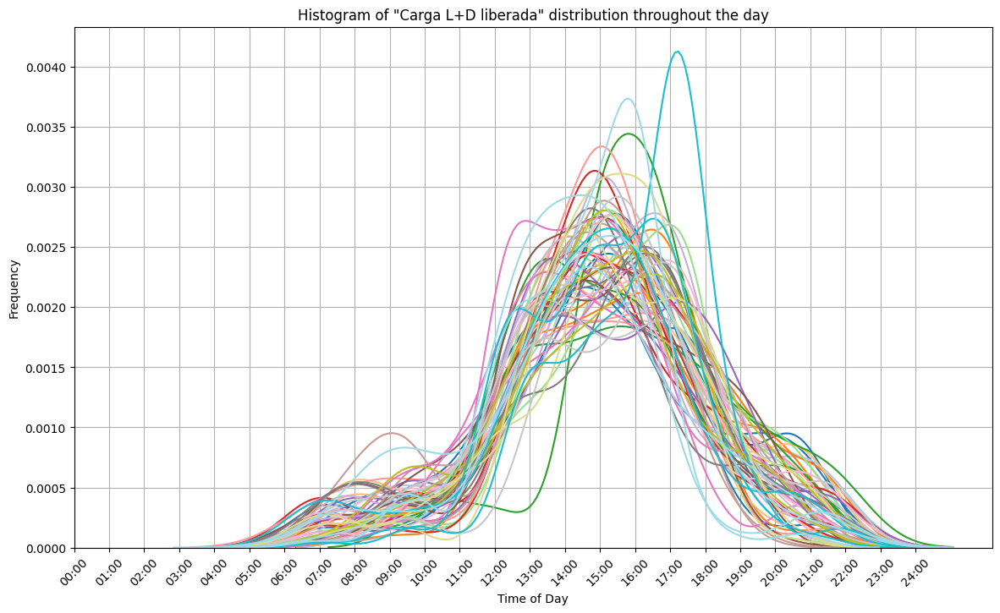

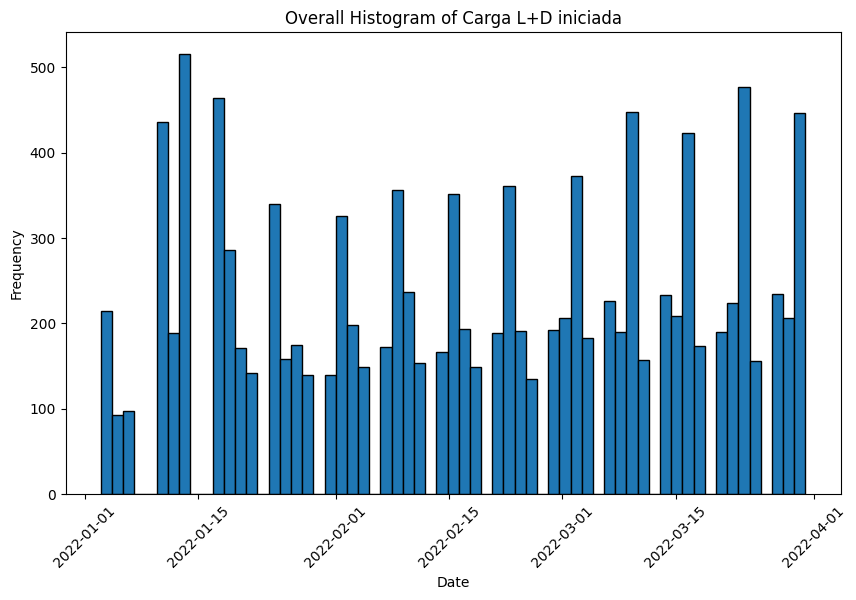

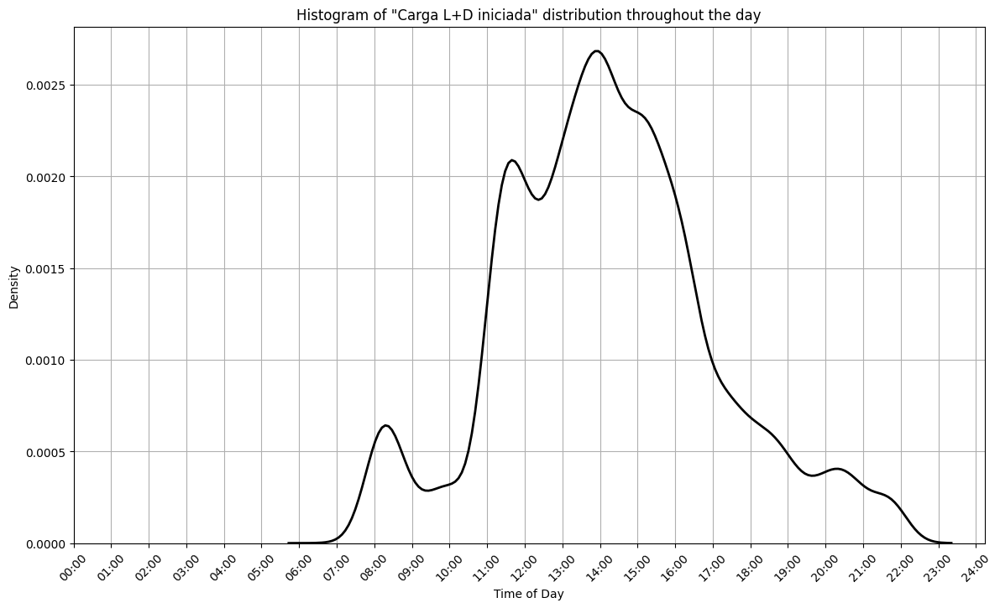

...

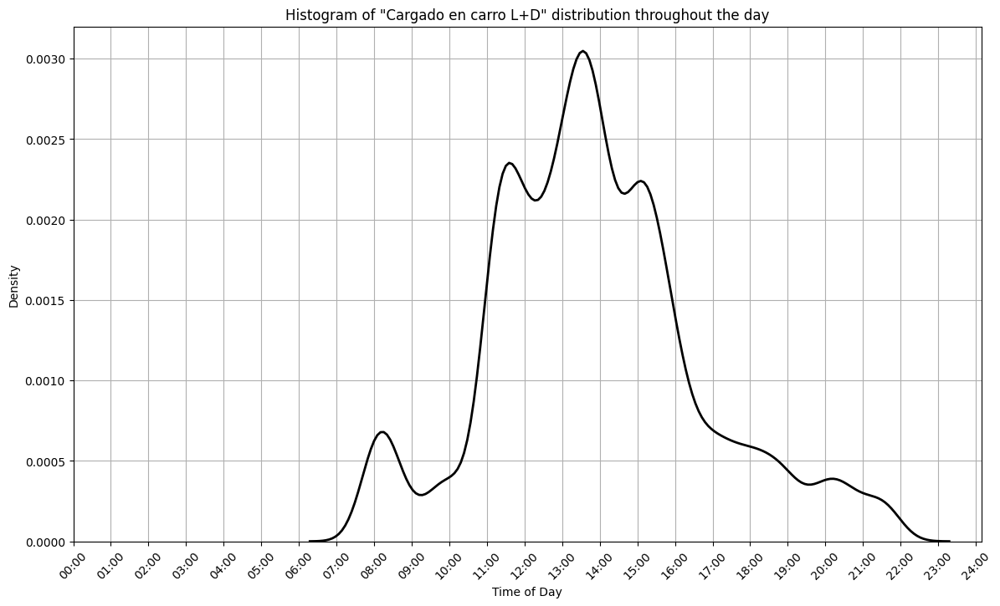

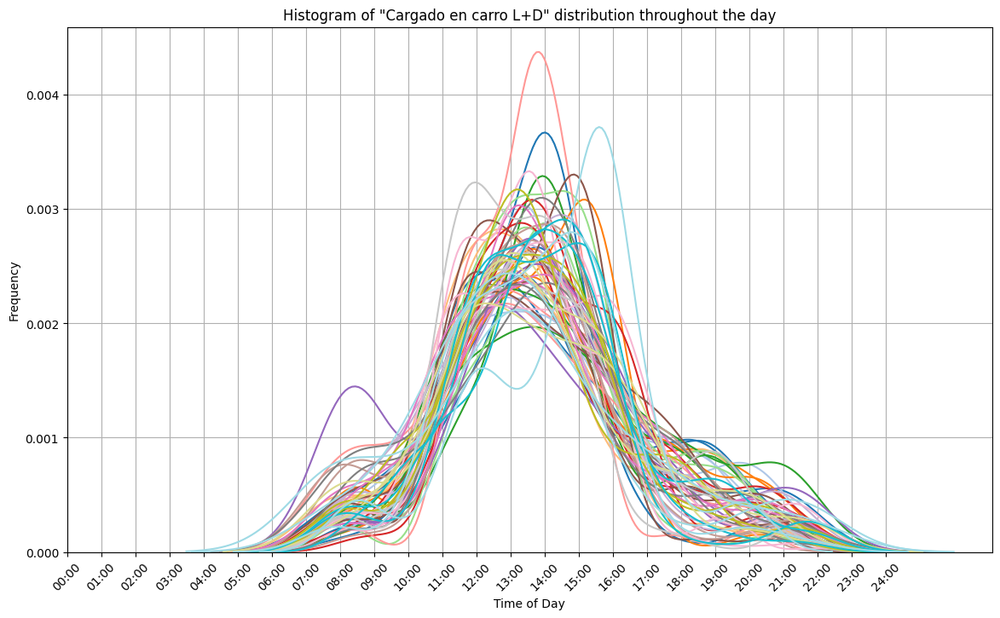

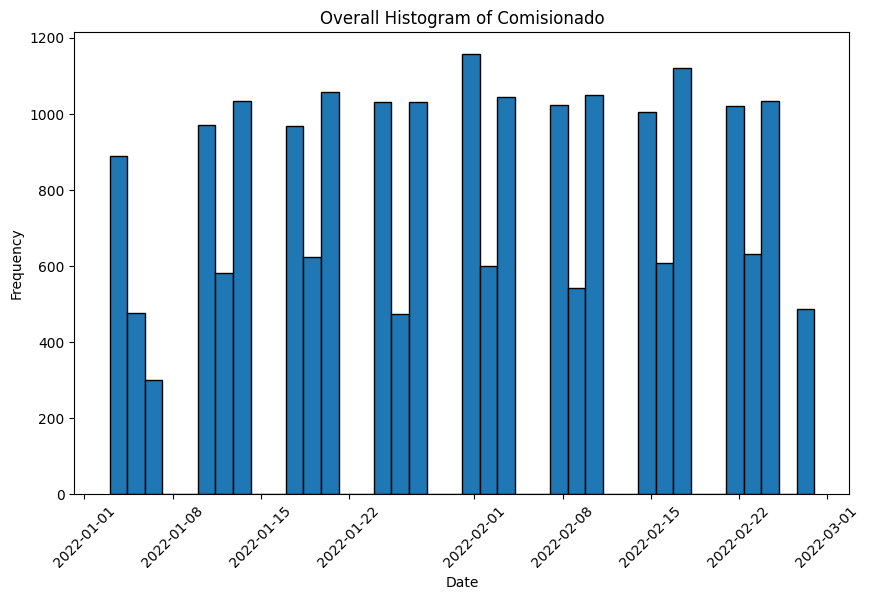

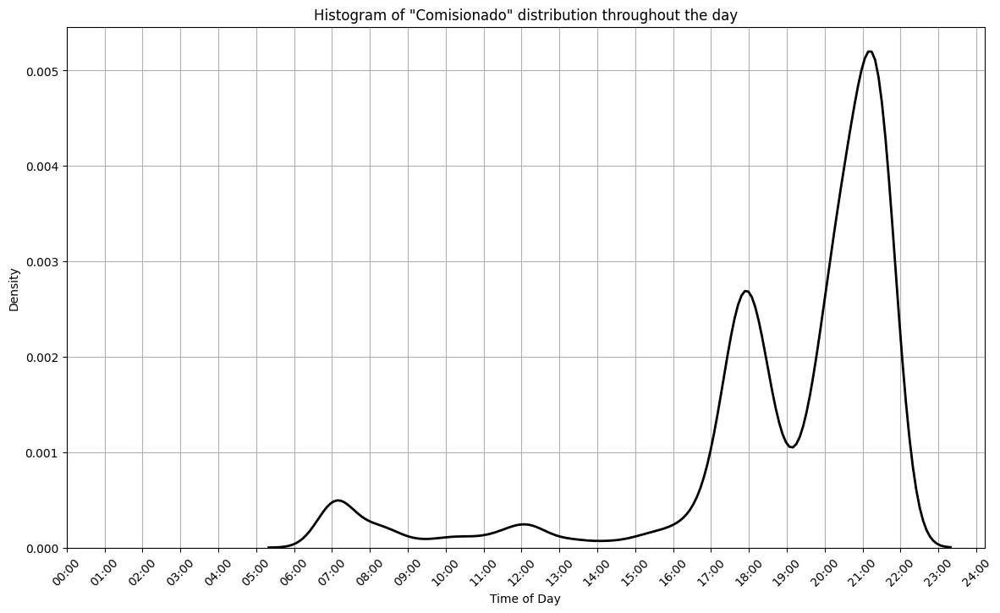

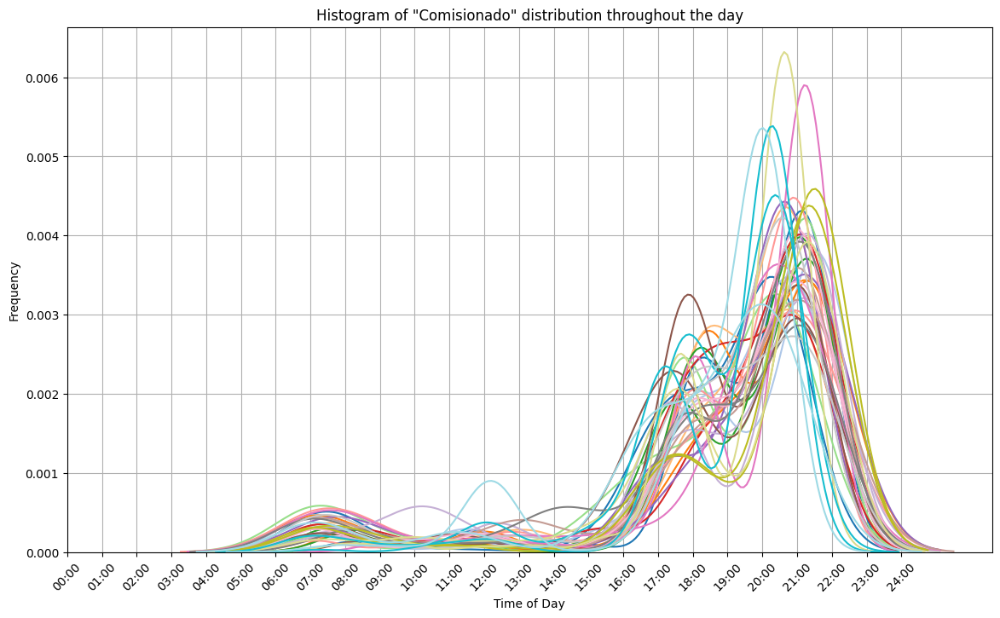

In [200]:
for activity in weekdays_df['e.Activity'].unique():

    filtered_df = weekdays_df[weekdays_df['e.Activity'] == activity]
    date_counts = filtered_df['date'].value_counts().sort_index()

    plt.figure(figsize=(10, 6))
    plt.hist(filtered_df['date'], bins=len(date_counts), edgecolor='black')
    plt.xlabel('Date')
    plt.ylabel('Frequency')
    plt.title(f'Overall Histogram of {activity}')
    plt.xticks(rotation=45)
    plt.show()

    filtered_df['time_in_minutes'] = filtered_df['e.timestamp'].dt.hour * 60 + filtered_df['e.timestamp'].dt.minute

    plt.figure(figsize=(14, 8))
    sns.kdeplot(filtered_df['time_in_minutes'], color='black', linewidth=2)
    plt.xlabel('Time of Day')
    plt.ylabel('Density')
    plt.title(f'Histogram of "{activity}" distribution throughout the day')
    plt.xticks(range(0, 1441, 60), [f'{i//60:02d}:{i%60:02d}' for i in range(0, 1441, 60)], rotation=45)
    plt.grid(True)
    plt.show()

    colors = plt.cm.get_cmap('tab20', len(filtered_df['date'].unique()))

    plt.figure(figsize=(14, 8))
    for i, date in enumerate(filtered_df['date'].unique()):
        date_data = filtered_df[filtered_df['date'] == date]
        times_in_minutes = date_data['time_in_minutes']
        sns.kdeplot(times_in_minutes, color=colors(i), alpha=1, label=str(date))

    plt.xlabel('Time of Day')
    plt.ylabel('Frequency')
    plt.title(f'Histogram of "{activity}" distribution throughout the day')
    plt.xticks(range(0, 1441, 60), [f'{i//60:02d}:{i%60:02d}' for i in range(0, 1441, 60)], rotation=45)
    plt.grid(True)
    plt.show()

In [179]:
for activity in weekdays_df['e.Activity'].unique():

    filtered_df = weekdays_df[weekdays_df['e.Activity'] == activity]
    print(activity)
    print(filtered_df.describe())


Carga L+D liberada
               e.NS
count  11105.000000
mean       5.646376
std        8.846760
min        0.000000
25%        1.000000
50%        3.000000
75%        6.000000
max       65.000000
Carga L+D iniciada
               e.NS
count  11837.000000
mean       5.625158
std        8.884885
min        0.000000
25%        1.000000
50%        3.000000
75%        6.000000
max       65.000000
Composición de cargas
               e.NS
count  35066.000000
mean       1.768237
std        5.683685
min        0.000000
25%        0.000000
50%        0.000000
75%        1.000000
max       65.000000
Montaje
               e.NS
count  22081.000000
mean       2.873375
std        6.948679
min        0.000000
25%        0.000000
50%        0.000000
75%        3.000000
max       65.000000
Producción montada
               e.NS
count  35223.000000
mean       1.753315
std        5.640679
min        0.000000
25%        0.000000
50%        0.000000
75%        1.000000
max       65.000000
Carga de este

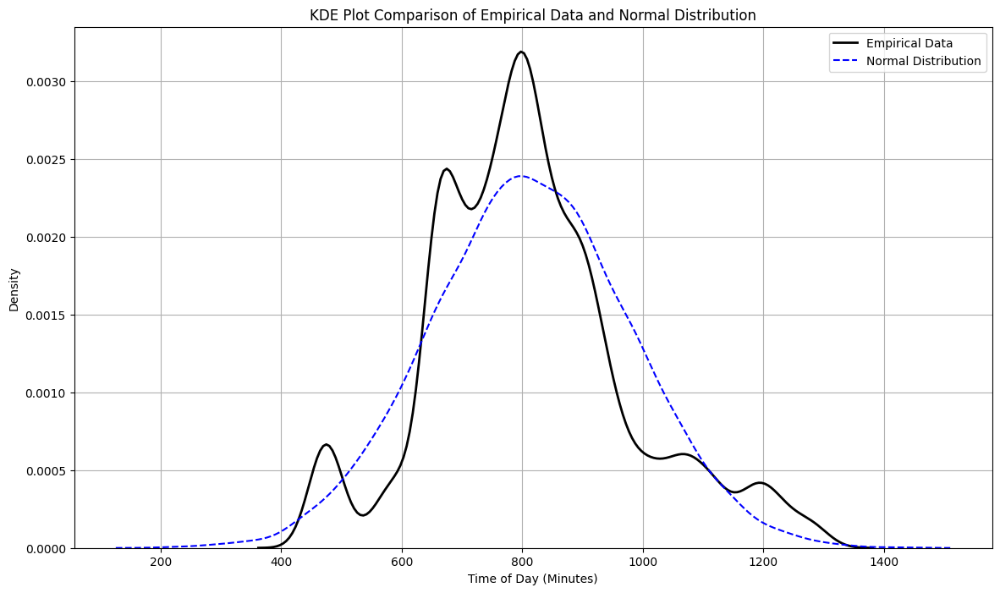

Calculated mean: 812.2096652674632
Calculated standard deviation: 165.65258221603278


In [180]:
filtered_df = weekdays_df[weekdays_df['e.Activity'] == 'Entrada Material Sucio']

filtered_df['time_in_minutes'] = filtered_df['e.timestamp'].dt.hour * 60 + filtered_df['e.timestamp'].dt.minute

empirical_data = filtered_df['time_in_minutes']

mean = empirical_data.mean()
std = empirical_data.std()

normal_data = np.random.normal(mean, std, len(empirical_data))

plt.figure(figsize=(14, 8))
sns.kdeplot(empirical_data, label='Empirical Data', color='black', linewidth=2)
sns.kdeplot(normal_data, label='Normal Distribution', color='blue', linestyle='--')

plt.xlabel('Time of Day (Minutes)')
plt.ylabel('Density')
plt.title('KDE Plot Comparison of Empirical Data and Normal Distribution')
plt.legend()
plt.grid(True)
plt.show()

print(f"Calculated mean: {mean}")
print(f"Calculated standard deviation: {std}")

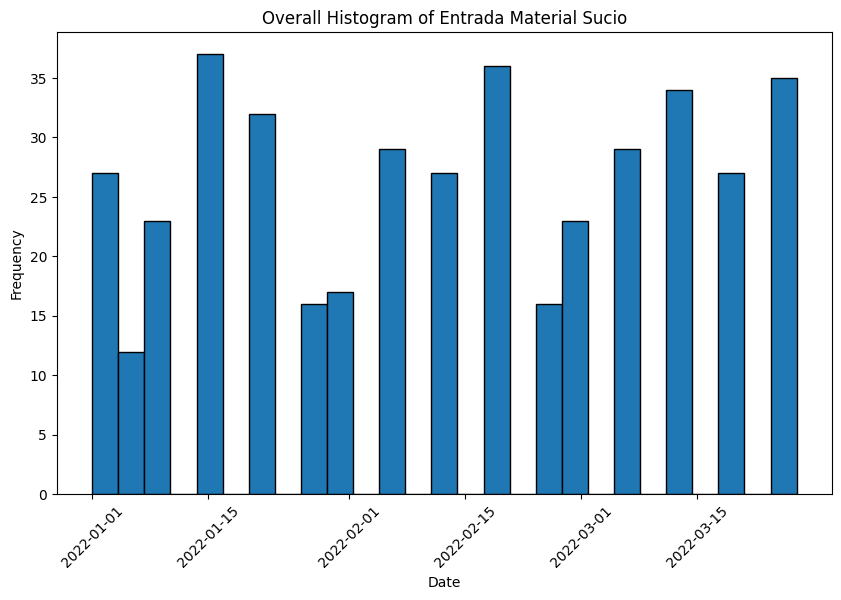

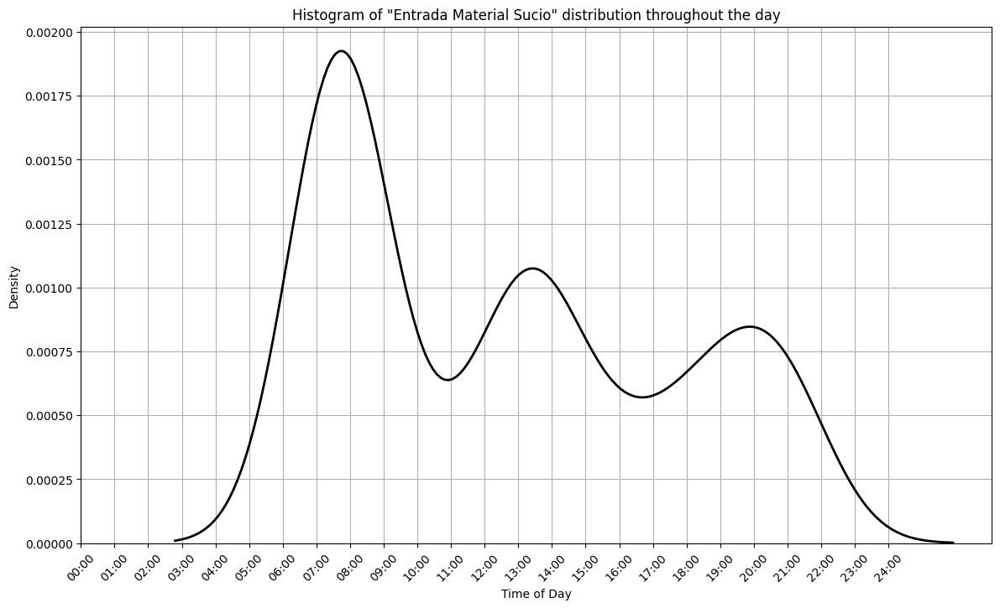

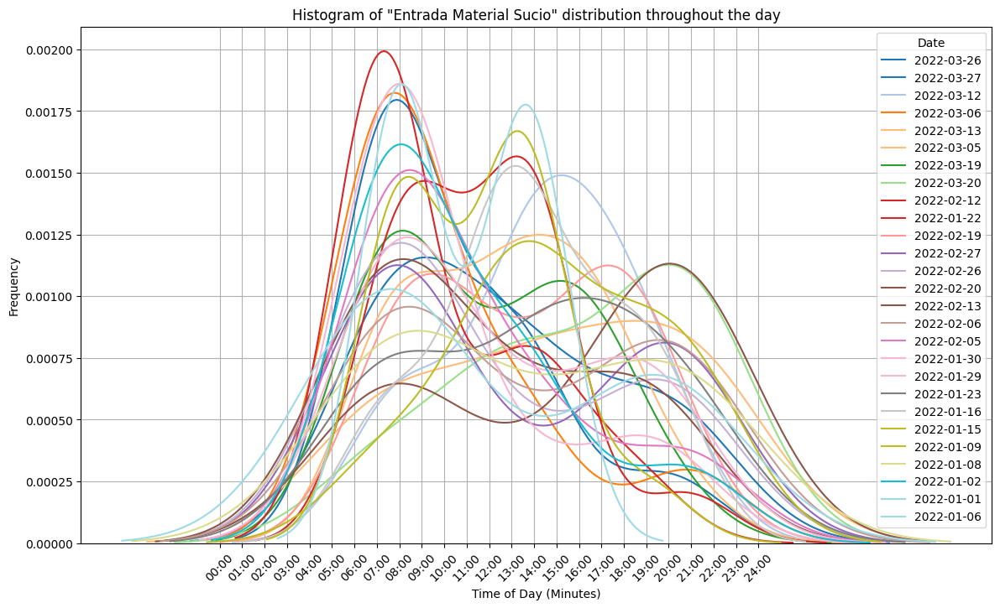

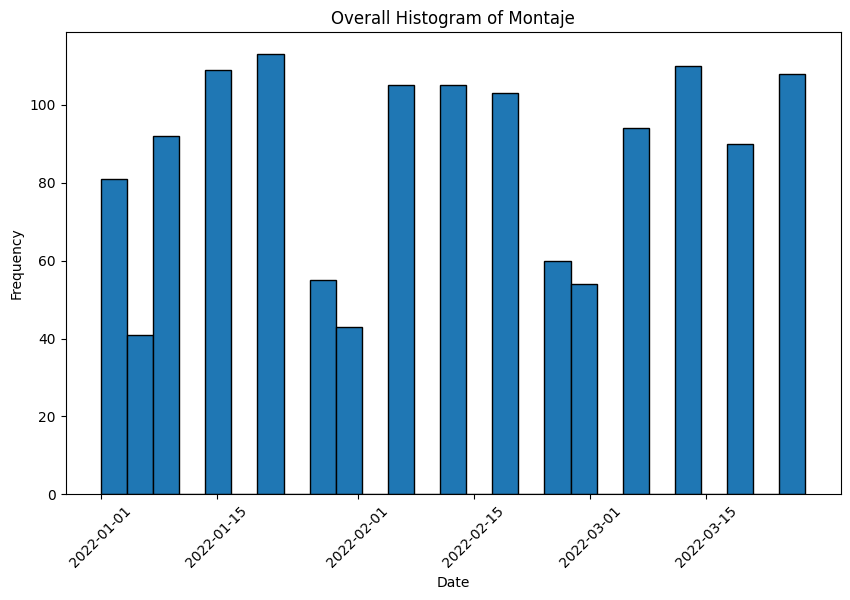

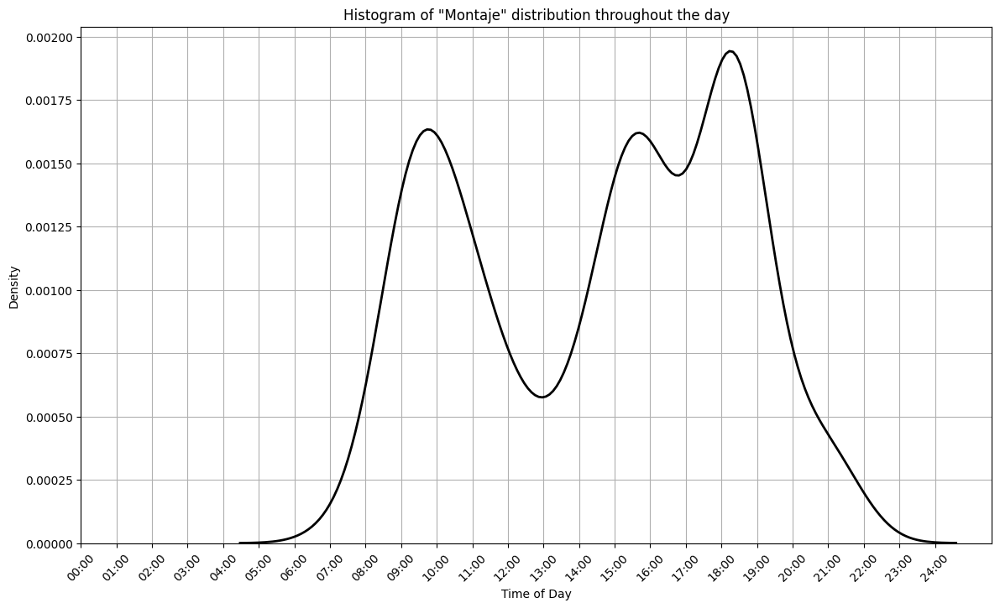

...

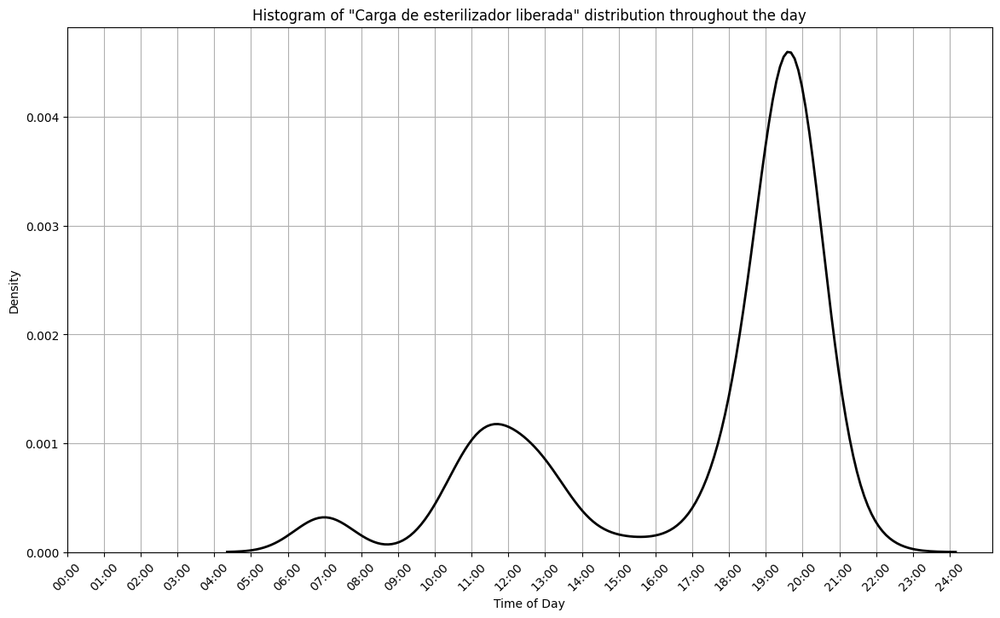

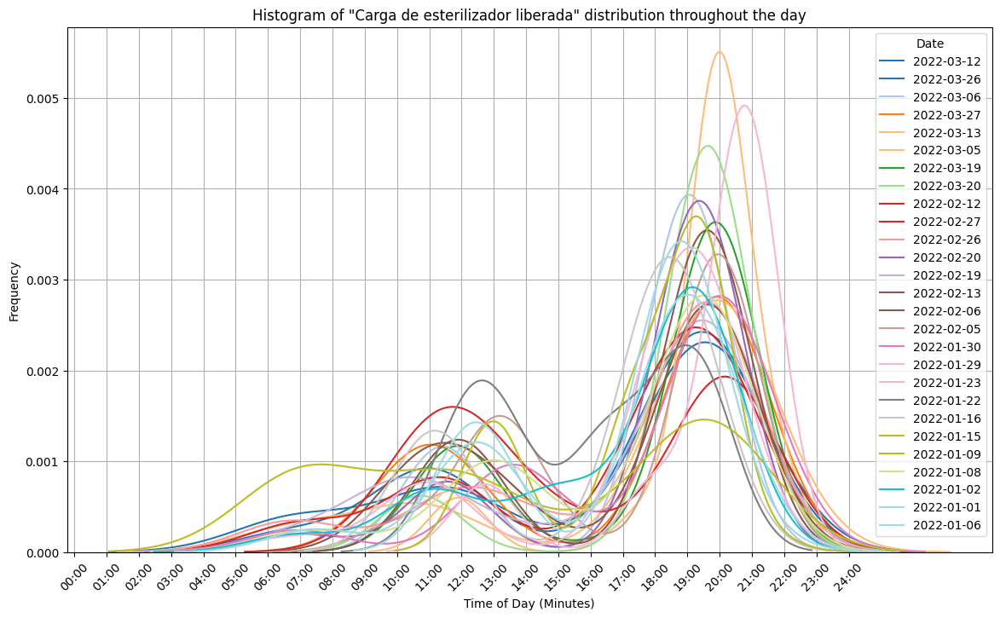

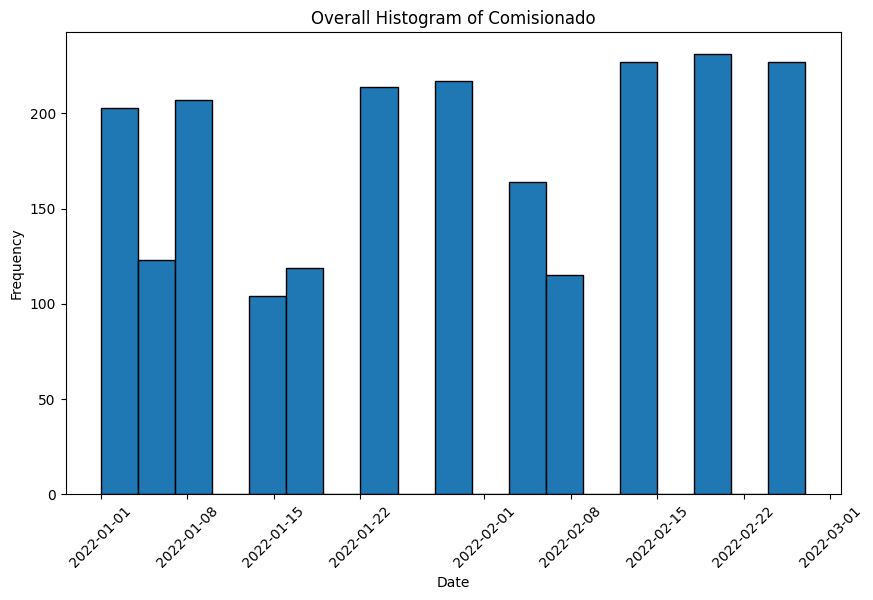

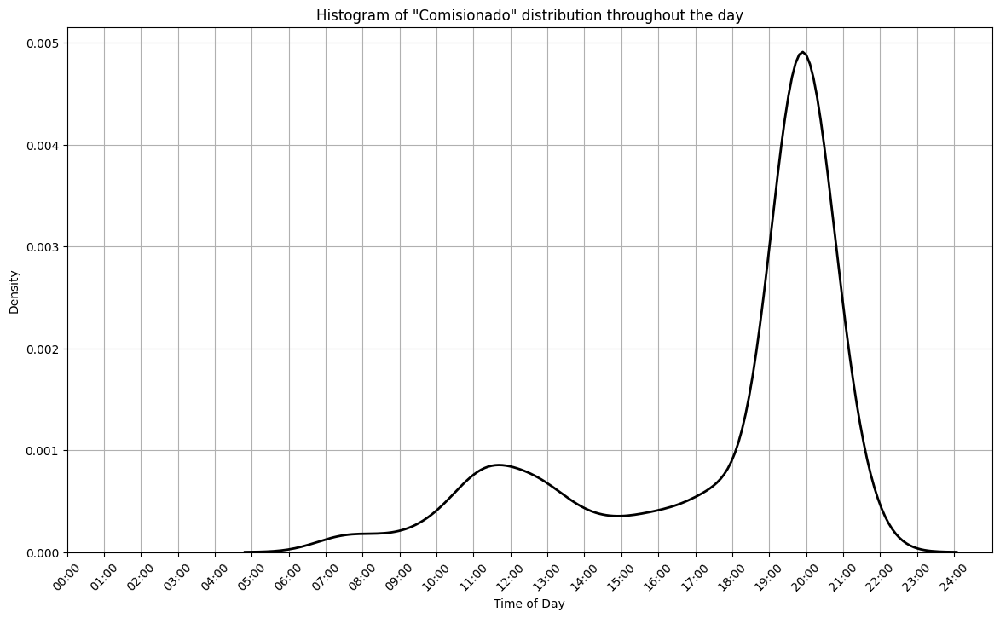

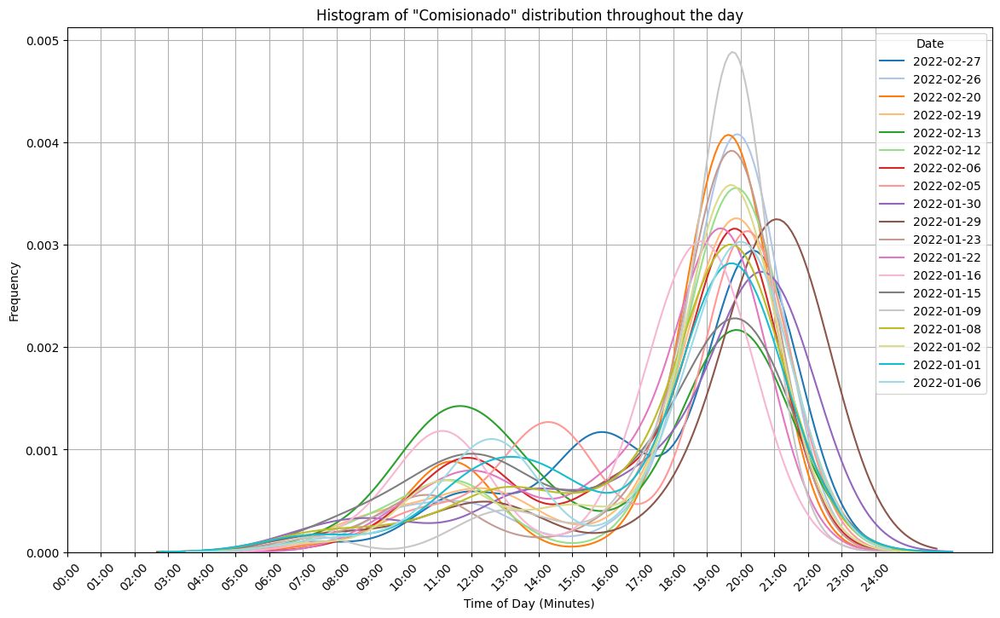

In [199]:
for activity in weekends_df['e.Activity'].unique():

    filtered_df = weekends_df[weekends_df['e.Activity'] == activity]
    date_counts = filtered_df['date'].value_counts().sort_index()

    plt.figure(figsize=(10, 6))
    plt.hist(filtered_df['date'], bins=len(date_counts), edgecolor='black')
    plt.xlabel('Date')
    plt.ylabel('Frequency')
    plt.title(f'Overall Histogram of {activity}')
    plt.xticks(rotation=45)
    plt.show()

    filtered_df['time_in_minutes'] = filtered_df['e.timestamp'].dt.hour * 60 + filtered_df['e.timestamp'].dt.minute

    plt.figure(figsize=(14, 8))
    sns.kdeplot(filtered_df['time_in_minutes'], color='black', linewidth=2)
    plt.xlabel('Time of Day')
    plt.ylabel('Density')
    plt.title(f'Histogram of "{activity}" distribution throughout the day')
    plt.xticks(range(0, 1441, 60), [f'{i//60:02d}:{i%60:02d}' for i in range(0, 1441, 60)], rotation=45)
    plt.grid(True)
    plt.show()

    colors = plt.cm.get_cmap('tab20', len(filtered_df['date'].unique()))

    plt.figure(figsize=(14, 8))
    for i, date in enumerate(filtered_df['date'].unique()):
        date_data = filtered_df[filtered_df['date'] == date]
        times_in_minutes = date_data['time_in_minutes']
        sns.kdeplot(times_in_minutes, color=colors(i), alpha=1, label=str(date))

    plt.xlabel('Time of Day (Minutes)')
    plt.ylabel('Frequency')
    plt.title(f'Histogram of "{activity}" distribution throughout the day')
    plt.xticks(range(0, 1441, 60), [f'{i//60:02d}:{i%60:02d}' for i in range(0, 1441, 60)], rotation=45)
    plt.legend(title='Date')
    plt.grid(True)
    plt.show()

In [182]:
for activity in weekends_df['e.Activity'].unique():

    filtered_weekends_df = weekends_df[weekends_df['e.Activity'] == activity]
    filtered_weekdays_df = weekdays_df[weekdays_df['e.Activity'] == activity]

    print(activity)
    combined_desc = pd.concat([filtered_weekends_df.describe(), filtered_weekdays_df.describe()], axis=1, keys=['Weekends', 'Weekdays'])
    print(combined_desc)



Entrada Material Sucio
         Weekends     Weekdays
             e.NS         e.NS
count  420.000000  9291.000000
mean     6.340476     6.182758
std      6.974264     9.158135
min      0.000000     0.000000
25%      2.000000     2.000000
50%      4.000000     3.000000
75%      8.000000     7.000000
max     50.000000    65.000000
Montaje
          Weekends      Weekdays
              e.NS          e.NS
count  1363.000000  22081.000000
mean      2.093910      2.873375
std       4.891178      6.948679
min       0.000000      0.000000
25%       0.000000      0.000000
50%       0.000000      0.000000
75%       2.000000      3.000000
max      50.000000     65.000000
Producción montada
          Weekends      Weekdays
              e.NS          e.NS
count  2708.000000  35223.000000
mean      0.990399      1.753315
std       3.470161      5.640679
min       0.000000      0.000000
25%       0.000000      0.000000
50%       0.000000      0.000000
75%       0.000000      1.000000
max      50.0

In [183]:
segments = []
wedf = weekends_df.sort_values(['r.CaseID', 'e.timestamp', 'e.Activity', 'e.Usuario'])

result_wedf = pd.concat([wedf, wedf.shift(-1)], axis=1)
result_wedf.columns = [str(i) + str(k // (len(wedf.columns))) for k, i in enumerate(result_wedf.columns)]
result_wedf = result_wedf[result_wedf['r.CaseID0'] == result_wedf['r.CaseID1']]

result_wedf['segment_name'] = result_wedf['e.Activity0'] + ' - ' + result_wedf['e.Activity1']
result_wedf.drop(['e.Activity0', 'r.CaseID1', 'e.Activity1'], axis=1, inplace=True)
result_wedf.columns = ['start_' + i.split('0')[0] if '0' in i else ('end_' + i.split('1')[0] if '1' in i else i) for i in result_wedf.columns]

segments = result_wedf['segment_name'].unique()
result_wedf['durationMinutes'] = result_wedf.apply(
    lambda row: (row['end_e.timestamp'] - row['start_e.timestamp']).total_seconds() / 60 
    if row['start_date'] == row['end_date'] 
    else None, 
    axis=1
)
filtered_result_wedf = result_wedf[result_wedf['durationMinutes'] != None]

Q1_wedf = filtered_result_wedf.groupby('segment_name')['durationMinutes'].quantile(0.25)
Q3_wedf = filtered_result_wedf.groupby('segment_name')['durationMinutes'].quantile(0.75)
IQR_wedf = Q3_wedf - Q1_wedf

lower_bound_wedf = Q1_wedf - 1.5 * IQR_wedf
upper_bound_wedf = Q3_wedf + 1.5 * IQR_wedf

result_filtered_wedf = filtered_result_wedf[~filtered_result_wedf.apply(lambda x: (x['durationMinutes'] < lower_bound_wedf[x['segment_name']]) or 
                                              (x['durationMinutes'] > upper_bound_wedf[x['segment_name']]), axis=1)]


segments = []
wddf = weekdays_df.sort_values(['r.CaseID', 'e.timestamp', 'e.Activity', 'e.Usuario'])

result_wddf = pd.concat([wddf, wddf.shift(-1)], axis=1)
result_wddf.columns = [str(i) + str(k // (len(wddf.columns))) for k, i in enumerate(result_wddf.columns)]
result_wddf = result_wddf[result_wddf['r.CaseID0'] == result_wddf['r.CaseID1']]

result_wddf['segment_name'] = result_wddf['e.Activity0'] + ' - ' + result_wddf['e.Activity1']
result_wddf.drop(['e.Activity0', 'r.CaseID1', 'e.Activity1'], axis=1, inplace=True)
result_wddf.columns = ['start_' + i.split('0')[0] if '0' in i else ('end_' + i.split('1')[0] if '1' in i else i) for i in result_wddf.columns]

segments = result_wddf['segment_name'].unique()

result_wddf['durationMinutes'] = result_wddf.apply(
    lambda row: (row['end_e.timestamp'] - row['start_e.timestamp']).total_seconds() / 60 
    if row['start_date'] == row['end_date'] 
    else None, 
    axis=1
)
filtered_result_wddf = result_wddf[result_wddf['durationMinutes'] != None]

Q1_wddf = filtered_result_wddf.groupby('segment_name')['durationMinutes'].quantile(0.25)
Q3_wddf = filtered_result_wddf.groupby('segment_name')['durationMinutes'].quantile(0.75)
IQR_wddf = Q3_wddf - Q1_wddf

lower_bound_wddf = Q1_wddf - 1.5 * IQR_wddf
upper_bound_wddf = Q3_wddf + 1.5 * IQR_wddf

result_filtered_wddf = filtered_result_wddf[~filtered_result_wddf.apply(lambda x: (x['durationMinutes'] < lower_bound_wddf[x['segment_name']]) or 
                                              (x['durationMinutes'] > upper_bound_wddf[x['segment_name']]), axis=1)]

grouped = pd.concat([result_filtered_wedf.groupby('segment_name')['durationMinutes'].describe(), result_filtered_wddf.groupby('segment_name')['durationMinutes'].describe()], axis=1, keys=['Weekends', 'Weekdays'])

grouped.head()

Weekends                        \
                                             count       mean        std   
segment_name                                                               
Carga L+D iniciada - Carga L+D iniciada       23.0   2.521739   2.889944   
Carga L+D iniciada - Carga L+D liberada      322.0  73.928571  13.003158   
Carga L+D iniciada - Cargado en carro L+D    169.0   0.000000   0.000000   
Carga L+D iniciada - Comisionado               4.0  47.250000  32.014320   
Carga L+D iniciada - Montaje                   8.0  30.625000  31.341153   

                                                                           \
                                            min   25%   50%    75%    max   
segment_name                                                                
Carga L+D iniciada - Carga L+D iniciada     0.0   0.0   1.0   5.50    7.0   
Carga L+D iniciada - Carga L+D liberada    41.0  65.0  73.0  80.75  110.0   
Carga L+D iniciada - Cargado en carro L+D   0.0   0.0   0.0   0.00    0.0   
Carga L+D iniciada - Comisionado            4.0  32.5  56.5  71.25   72.0   
Carga L+D iniciada - Montaje                8.0  10.0  13.0  42.00   87.0   

                                          Weekdays                        \
                                             count       mean        std   
segment_name                                                               
Carga L+D iniciada - Carga L+D iniciada      463.0  20.498920  23.198361   
Carga L+D iniciada - Carga L+D liberada     8386.0  69.304436  10.109111   
Carga L+D iniciada - Cargado en carro L+D    976.0   0.311475   1.129244   
Carga L+D iniciada - Comisionado               9.0  24.444444  18.842181   
Carga L+D iniciada - Montaje                 216.0  22.231481  19.663971   

                                                                         
                                            min   25%   50%   75%   max  
segment_name                                                             
Carga L+D iniciada - Carga L+D iniciada     0.0   2.0  12.0  31.0  88.0  
Carga L+D iniciada - Carga L+D liberada    41.0  63.0  69.0  75.0  97.0  
Carga L+D iniciada - Cargado en carro L+D   0.0   0.0   0.0   0.0   7.0  
Carga L+D iniciada - Comisionado            1.0  10.0  22.0  32.0  52.0  
Carga L+D iniciada - Montaje                0.0   7.0  16.0  33.0  84.0

In [184]:
segments = []
wedf = weekends_df.sort_values(['r.CaseID', 'e.timestamp', 'e.Activity', 'e.Usuario'])

result_wedf = pd.concat([wedf, wedf.shift(-1)], axis=1)
result_wedf.columns = [str(i) + str(k // (len(wedf.columns))) for k, i in enumerate(result_wedf.columns)]
result_wedf = result_wedf[result_wedf['r.CaseID0'] == result_wedf['r.CaseID1']]

result_wedf['segment_name'] = result_wedf['e.Activity0'] + ' - ' + result_wedf['e.Activity1']
result_wedf.drop(['e.Activity0', 'r.CaseID1', 'e.Activity1'], axis=1, inplace=True)
result_wedf.columns = ['start_' + i.split('0')[0] if '0' in i else ('end_' + i.split('1')[0] if '1' in i else i) for i in result_wedf.columns]

segments = result_wedf['segment_name'].unique()

result_wedf['durationMinutes'] = result_wedf.apply(
    lambda row: (row['end_e.timestamp'] - row['start_e.timestamp']).total_seconds() / 60 
    if row['start_date'] == row['end_date'] 
    else None, 
    axis=1
)
filtered_result_wedf = result_wedf[result_wedf['durationMinutes'] != None]
filtered_result_wedf.head()


,start_e.Usuario,start_e.timestamp,start_e.KitID,start_e.NS,start_e.Código,start_r.CaseID,start_date,end_e.Usuario,end_e.timestamp,end_e.KitID,end_e.NS,end_e.Código,end_date,segment_name,durationMinutes
2615,ML,2022-02-19 07:11:00+00:00,DEP-QUI.CPL.STRYK-2,2,DEP-QUI.CPL.STRYK,DEP-QUI.CPL.STRYK-2-CN22350,2022-02-19,ML,2022-02-19 08:06:00+00:00,DEP-QUI.CPL.STRYK-2,2.0,DEP-QUI.CPL.STRYK,2022-02-19,Carga L+D liberada - Montaje,55.0
2616,ML,2022-02-19 08:06:00+00:00,DEP-QUI.CPL.STRYK-2,2,DEP-QUI.CPL.STRYK,DEP-QUI.CPL.STRYK-2-CN22350,2022-02-19,ML,2022-02-19 08:15:00+00:00,DEP-QUI.CPL.STRYK-2,2.0,DEP-QUI.CPL.STRYK,2022-02-19,Montaje - Montaje,9.0
2612,ML,2022-02-19 08:15:00+00:00,DEP-QUI.CPL.STRYK-2,2,DEP-QUI.CPL.STRYK,DEP-QUI.CPL.STRYK-2-CN22350,2022-02-19,ML,2022-02-19 08:17:00+00:00,DEP-QUI.CPL.STRYK-2,2.0,DEP-QUI.CPL.STRYK,2022-02-19,Montaje - Producción montada,2.0
2614,ML,2022-02-19 08:17:00+00:00,DEP-QUI.CPL.STRYK-2,2,DEP-QUI.CPL.STRYK,DEP-QUI.CPL.STRYK-2-CN22350,2022-02-19,ML,2022-02-19 08:49:00+00:00,DEP-QUI.CPL.STRYK-2,2.0,DEP-QUI.CPL.STRYK,2022-02-19,Producción montada - Composición de cargas,32.0
2611,ML,2022-02-19 08:49:00+00:00,DEP-QUI.CPL.STRYK-2,2,DEP-QUI.CPL.STRYK,DEP-QUI.CPL.STRYK-2-CN22350,2022-02-19,ML,2022-02-19 10:13:00+00:00,DEP-QUI.CPL.STRYK-2,2.0,DEP-QUI.CPL.STRYK,2022-02-19,Composición de cargas - Carga de esterilizador...,84.0


In [233]:
segments = []
total_df = df.sort_values(['r.CaseID', 'e.timestamp', 'e.Activity', 'e.Usuario'])

result_total_df = pd.concat([total_df, total_df.shift(-1)], axis=1)
result_total_df.columns = [str(i) + str(k // (len(total_df.columns))) for k, i in enumerate(result_total_df.columns)]
result_total_df = result_total_df[result_total_df['r.CaseID0'] == result_total_df['r.CaseID1']]

result_total_df['segment_name'] = result_total_df['e.Activity0'] + ' - ' + result_total_df['e.Activity1']
result_total_df.drop(['e.Activity0', 'r.CaseID1', 'e.Activity1'], axis=1, inplace=True)
result_total_df.columns = ['start_' + i.split('0')[0] if '0' in i else ('end_' + i.split('1')[0] if '1' in i else i) for i in result_total_df.columns]

segments = result_total_df['segment_name'].unique()

result_total_df['durationMinutes'] = result_total_df.apply(
    lambda row: (row['end_e.timestamp'] - row['start_e.timestamp']).total_seconds() / 60 
    if row['start_date'] == row['end_date'] 
    else None, 
    axis=1
)
filtered_result_total_df = result_total_df[result_total_df['durationMinutes'] != None]
filtered_result_total_df.head()

,start_e.Usuario,start_e.timestamp,start_e.KitID,start_e.NS,start_e.Código,start_r.CaseID,start_date,end_e.Usuario,end_e.timestamp,end_e.KitID,end_e.NS,end_e.Código,end_date,segment_name,durationMinutes
167414,CM,2022-01-26 17:31:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN10738,2022-01-26,SM,2022-01-28 08:16:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-01-28,Montaje - Montaje,NaN
188165,CM,2022-01-04 16:00:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN1080,2022-01-04,CM,2022-01-05 14:04:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-01-05,Montaje - Montaje,NaN
188164,CM,2022-01-05 14:04:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN1080,2022-01-05,CM,2022-01-05 14:04:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-01-05,Montaje - Producción montada,0.0
188166,CM,2022-01-05 14:04:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN1080,2022-01-05,CM,2022-01-07 13:06:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-01-07,Producción montada - Montaje,NaN
188163,CM,2022-01-07 13:06:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN1080,2022-01-07,CM,2022-01-07 13:06:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-01-07,Montaje - Producción montada,0.0


In [236]:
filtered_result_total_df = result_total_df[~result_total_df['durationMinutes'].isna()]
filtered_result_total_df.head()

,start_e.Usuario,start_e.timestamp,start_e.KitID,start_e.NS,start_e.Código,start_r.CaseID,start_date,end_e.Usuario,end_e.timestamp,end_e.KitID,end_e.NS,end_e.Código,end_date,segment_name,durationMinutes
188164,CM,2022-01-05 14:04:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN1080,2022-01-05,CM,2022-01-05 14:04:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-01-05,Montaje - Producción montada,0.0
188163,CM,2022-01-07 13:06:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN1080,2022-01-07,CM,2022-01-07 13:06:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-01-07,Montaje - Producción montada,0.0
156494,CM,2022-02-07 08:30:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN15811,2022-02-07,CM,2022-02-07 08:30:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-02-07,Montaje - Producción montada,0.0
156496,AV,2022-02-10 09:58:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN15811,2022-02-10,AV,2022-02-10 09:58:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-02-10,Montaje - Producción montada,0.0
156495,AV,2022-02-10 09:58:00+00:00,012047 L2901-0,0,012047 L2901,012047 L2901-0-CN15811,2022-02-10,MCE,2022-02-10 10:23:00+00:00,012047 L2901-0,0.0,012047 L2901,2022-02-10,Producción montada - Montaje,25.0


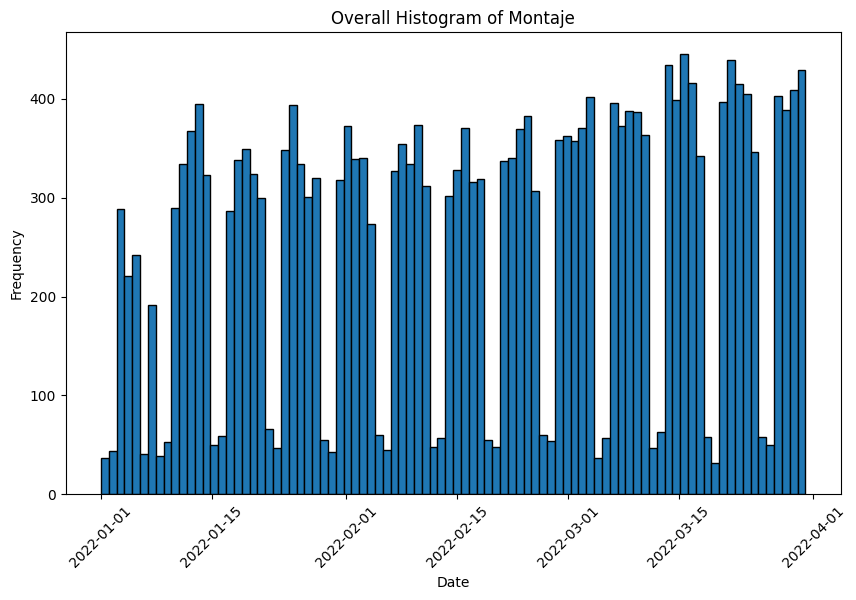

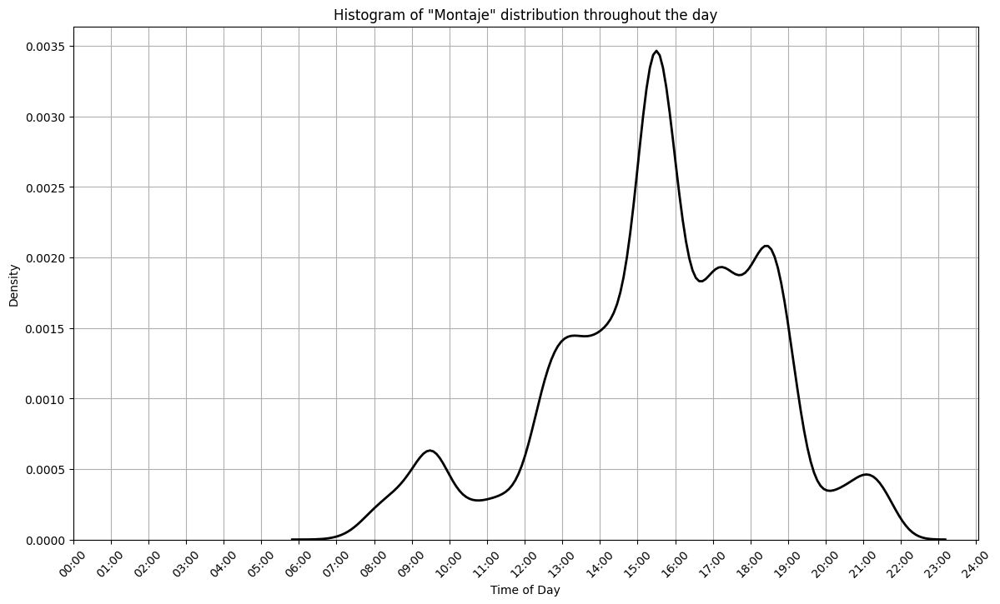

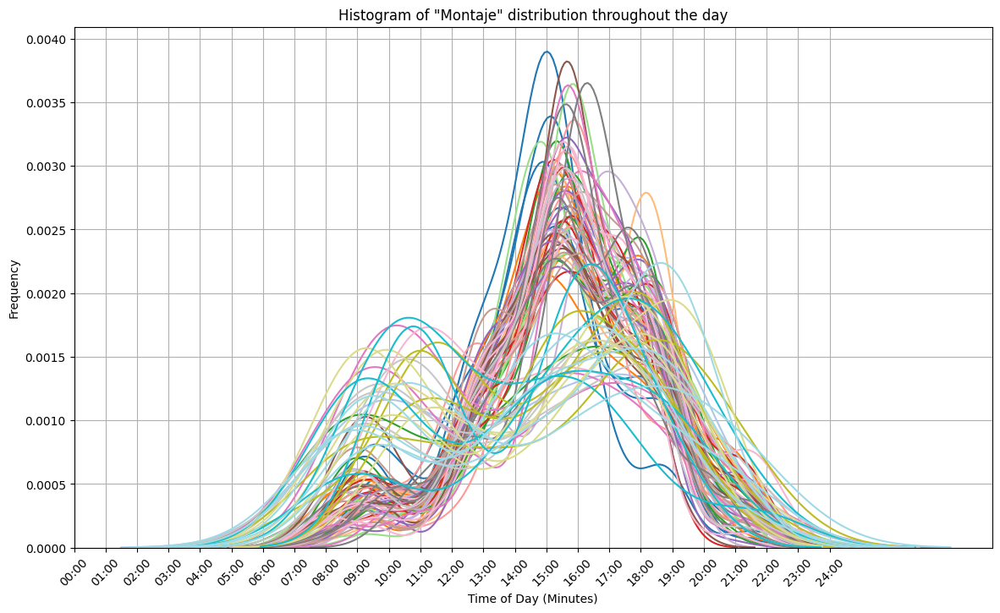

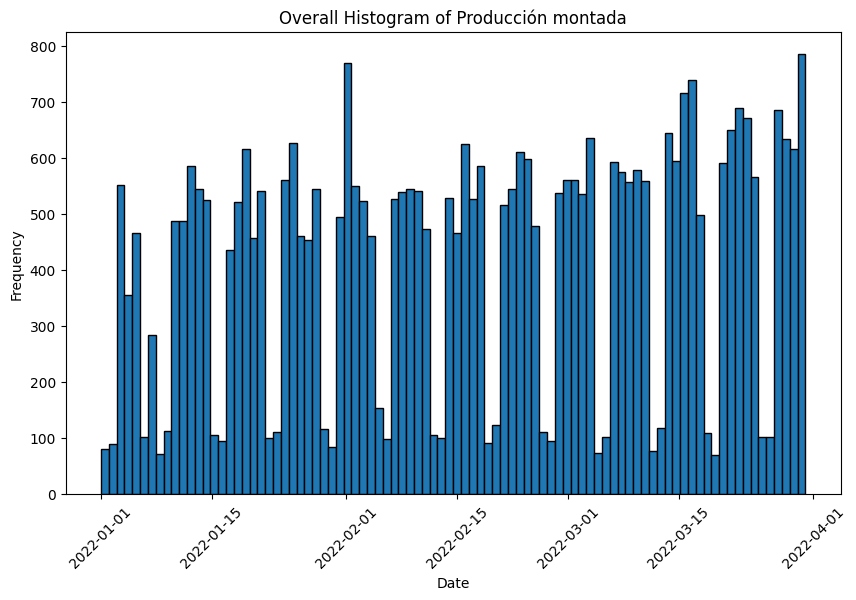

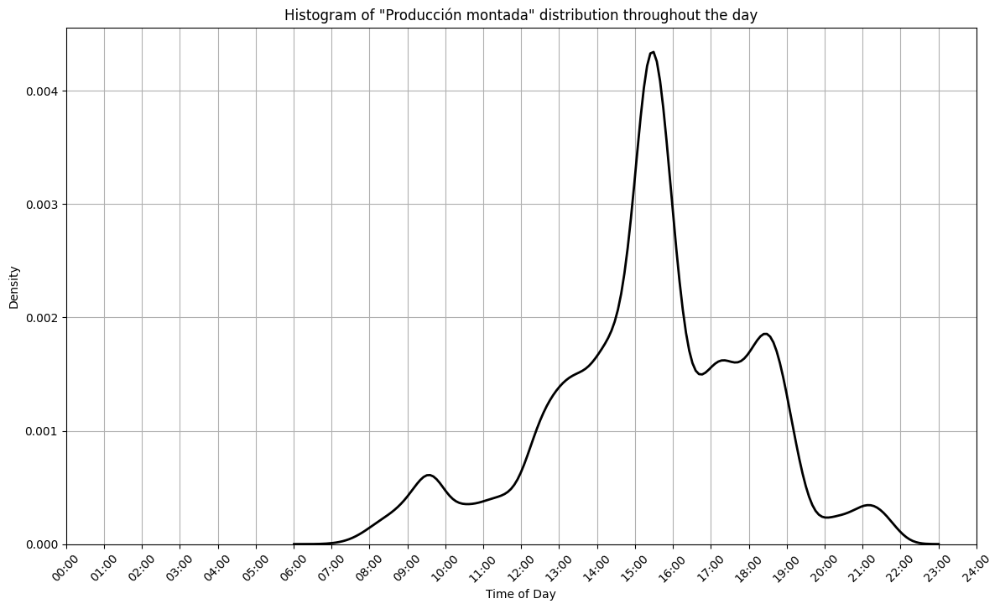

...

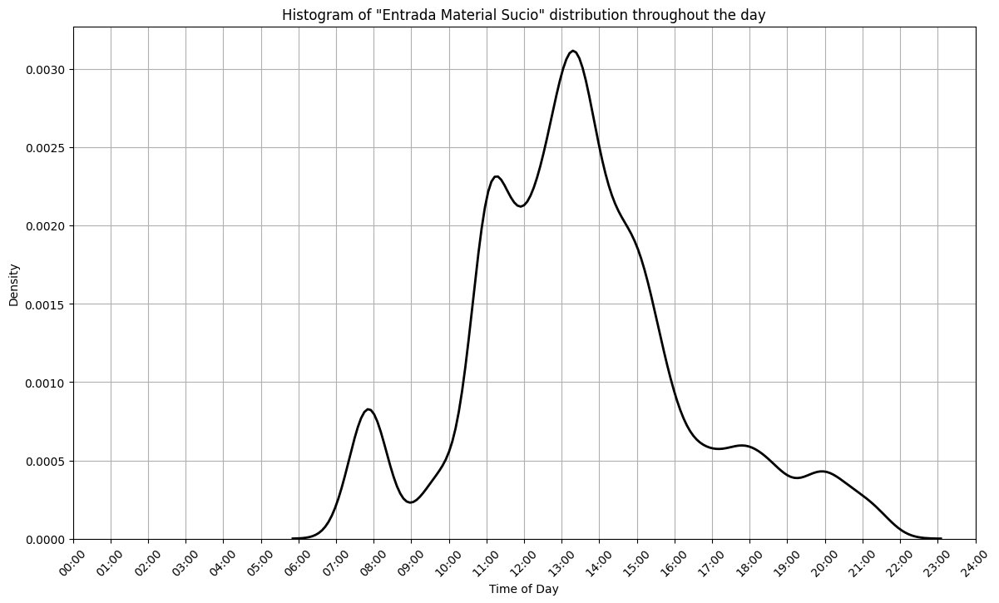

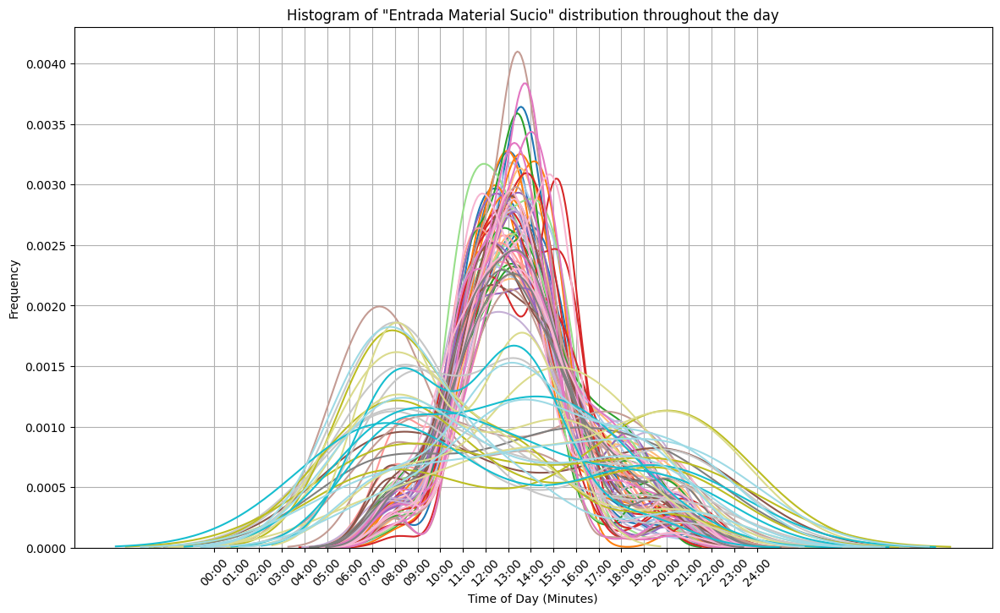

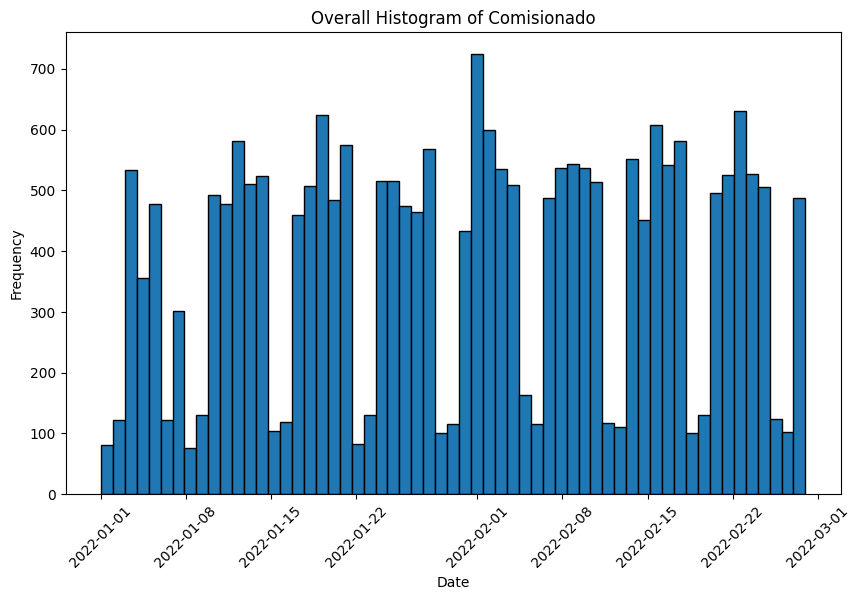

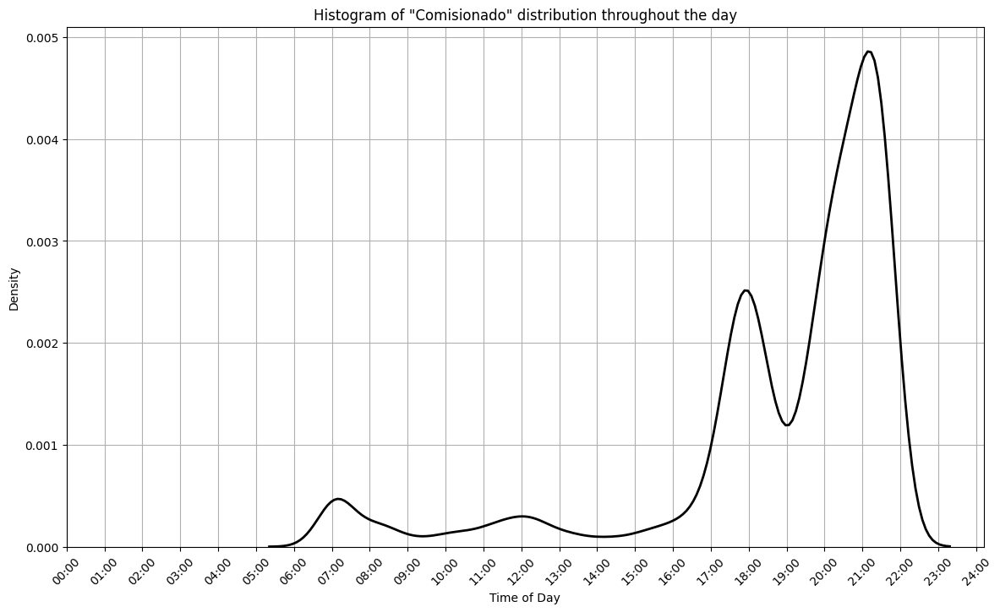

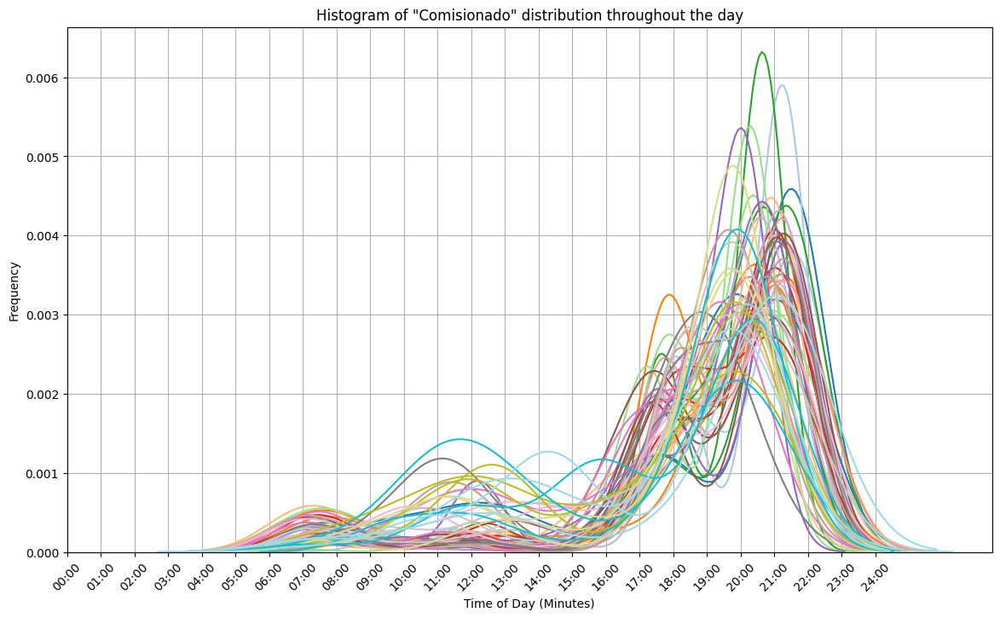

In [238]:
for activity in total_df['e.Activity'].unique():

    filtered_df = total_df[total_df['e.Activity'] == activity]
    date_counts = filtered_df['date'].value_counts().sort_index()

    plt.figure(figsize=(10, 6))
    plt.hist(filtered_df['date'], bins=len(date_counts), edgecolor='black')
    plt.xlabel('Date')
    plt.ylabel('Frequency')
    plt.title(f'Overall Histogram of {activity}')
    plt.xticks(rotation=45)
    plt.show()

    filtered_df['time_in_minutes'] = filtered_df['e.timestamp'].dt.hour * 60 + filtered_df['e.timestamp'].dt.minute

    plt.figure(figsize=(14, 8))
    sns.kdeplot(filtered_df['time_in_minutes'], color='black', linewidth=2)

    plt.xlabel('Time of Day')
    plt.ylabel('Density')
    plt.title(f'Histogram of "{activity}" distribution throughout the day')
    plt.xticks(range(0, 1441, 60), [f'{i//60:02d}:{i%60:02d}' for i in range(0, 1441, 60)], rotation=45)
    plt.grid(True)
    plt.show()

    colors = plt.cm.get_cmap('tab20', len(filtered_df['date'].unique()))

    plt.figure(figsize=(14, 8))
    for i, date in enumerate(filtered_df['date'].unique()):
        date_data = filtered_df[filtered_df['date'] == date]
        times_in_minutes = date_data['time_in_minutes']
        sns.kdeplot(times_in_minutes, color=colors(i), alpha=1, label=str(date))

    plt.xlabel('Time of Day (Minutes)')
    plt.ylabel('Frequency')
    plt.title(f'Histogram of "{activity}" distribution throughout the day')
    plt.xticks(range(0, 1441, 60), [f'{i//60:02d}:{i%60:02d}' for i in range(0, 1441, 60)], rotation=45)
    plt.grid(True)
    plt.show()

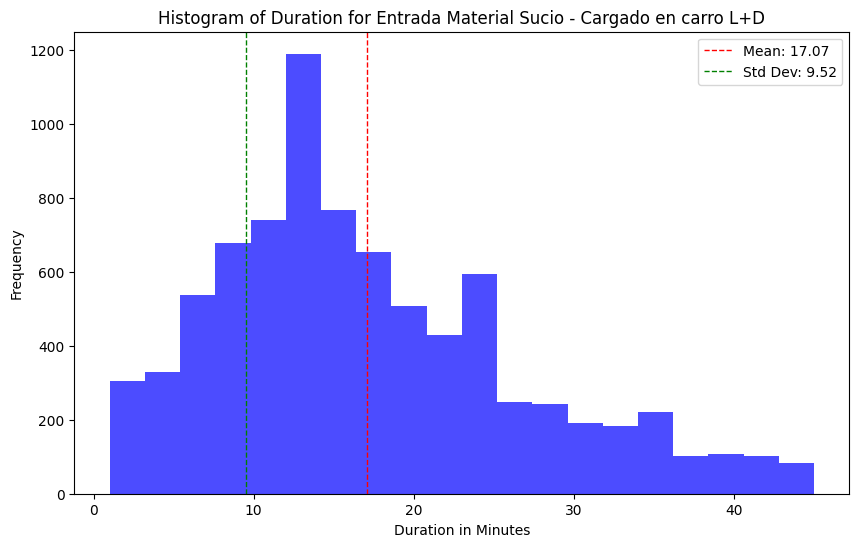

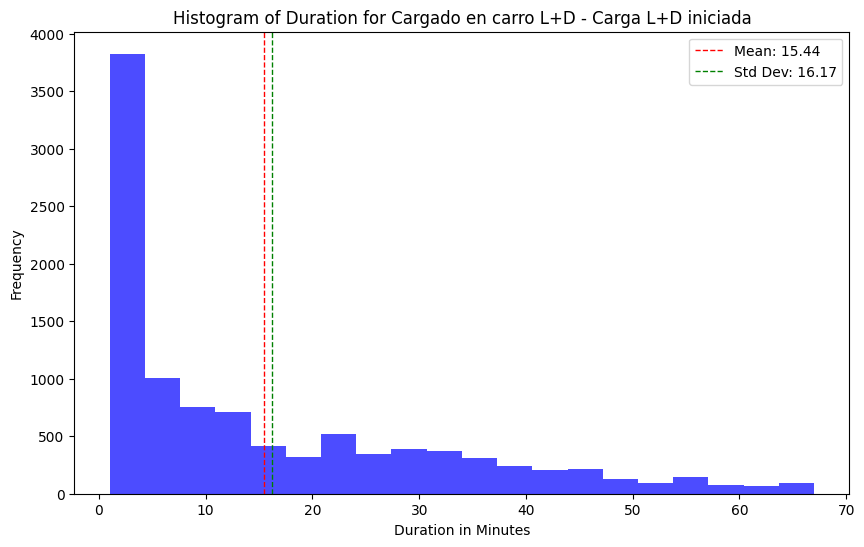

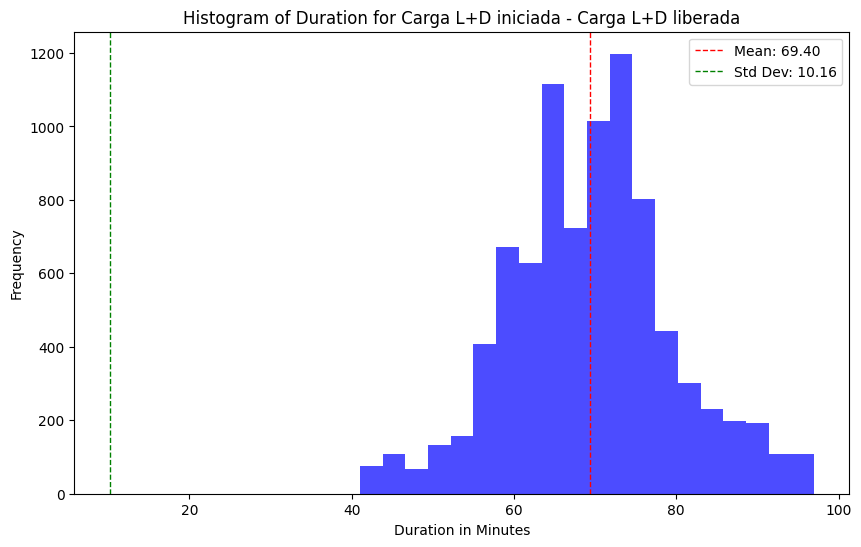

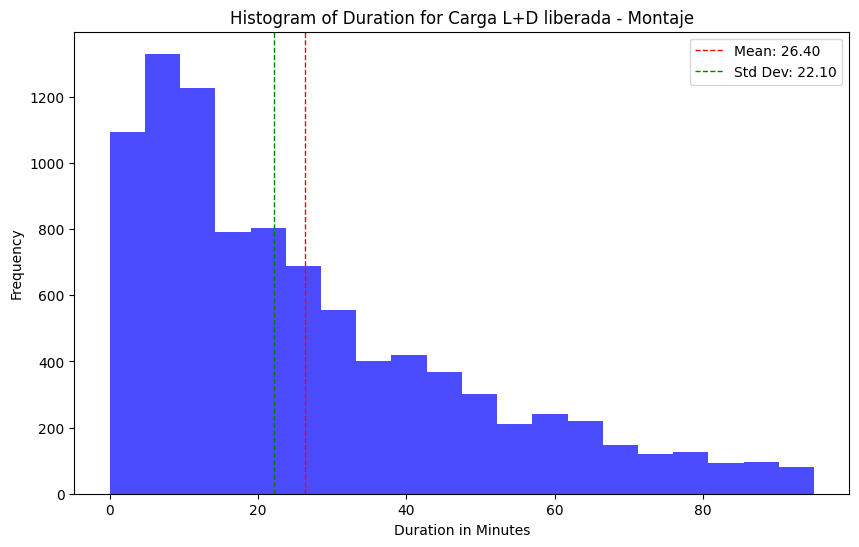

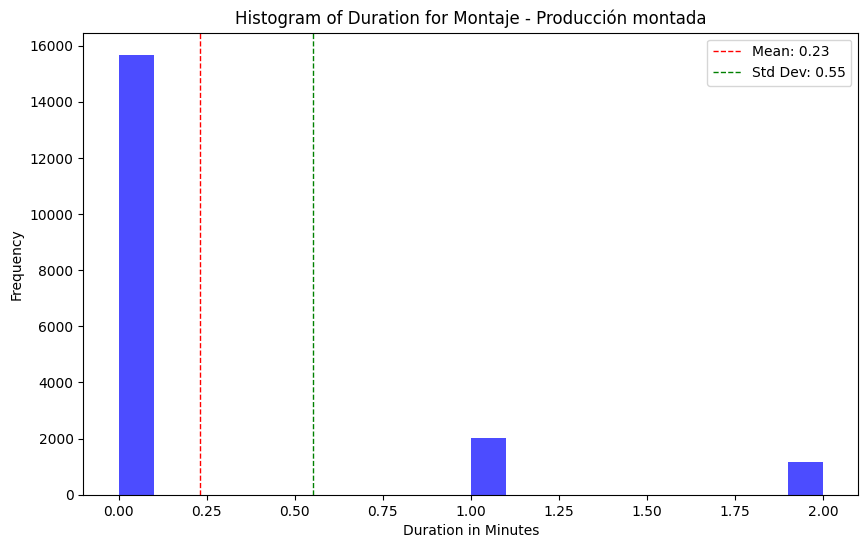

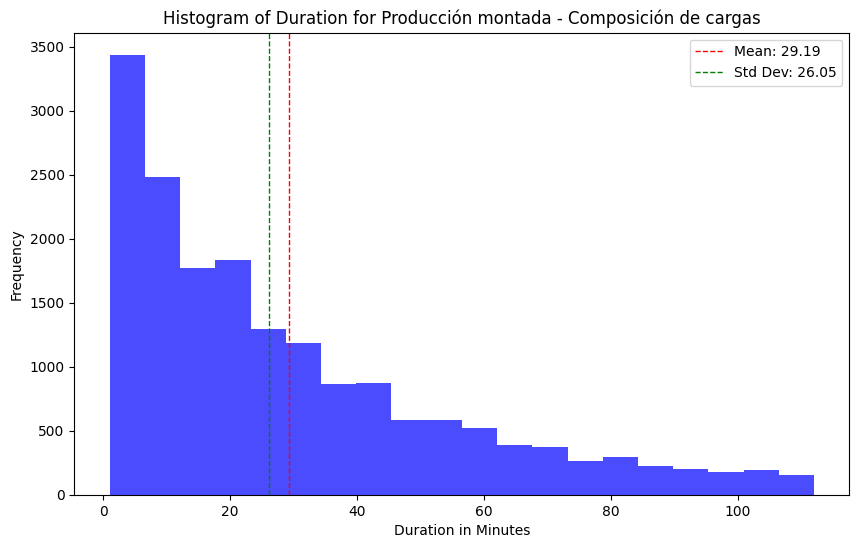

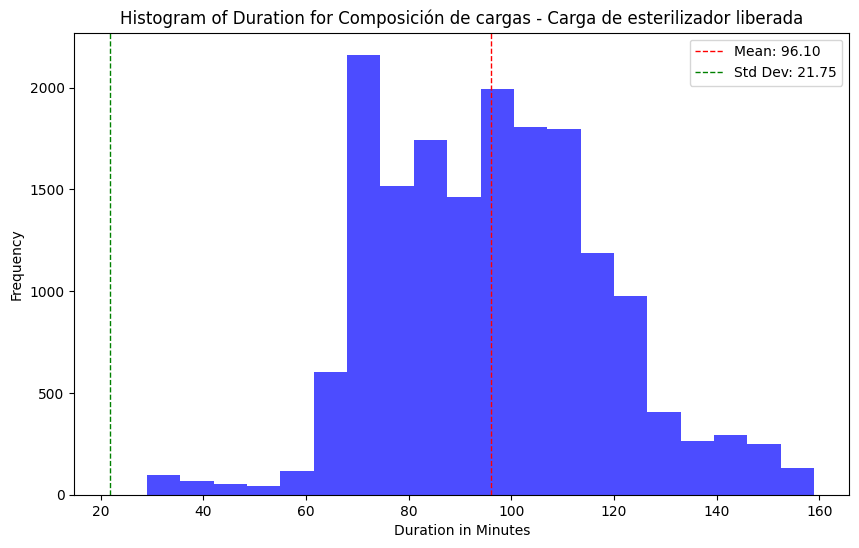

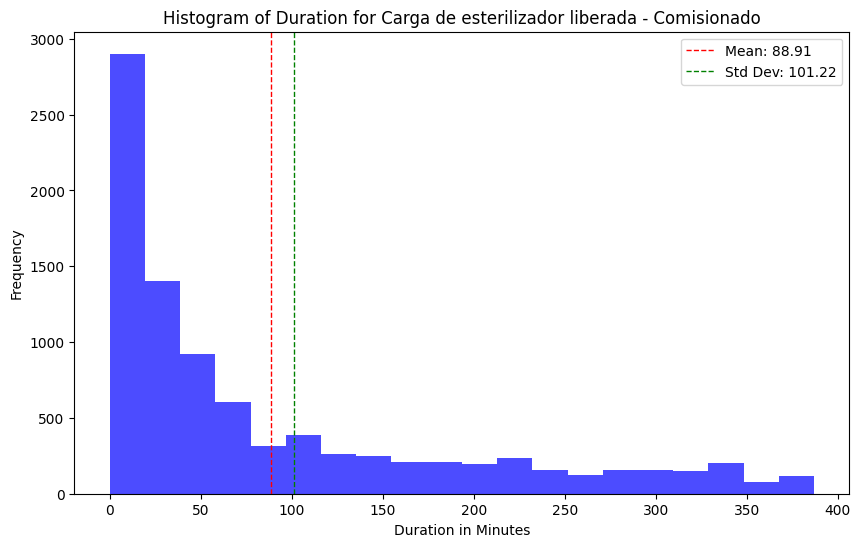

In [239]:
news_df = filtered_result_total_df.copy()

segments = ['Entrada Material Sucio - Cargado en carro L+D',
            'Cargado en carro L+D - Carga L+D iniciada',
            'Carga L+D iniciada - Carga L+D liberada',
            'Carga L+D liberada - Montaje',
            'Montaje - Producción montada',
            'Producción montada - Composición de cargas',
            'Composición de cargas - Carga de esterilizador liberada',
            'Carga de esterilizador liberada - Comisionado'
           ]

for segment in segments:
    segment_df = news_df[news_df['segment_name'] == segment]
    
    if not segment_df.empty:

        Q1 = segment_df['durationMinutes'].quantile(0.25)
        Q3 = segment_df['durationMinutes'].quantile(0.75)
        IQR = Q3 - Q1
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        filtered_segment_df = segment_df[(segment_df['durationMinutes'] >= lower_bound) & 
                                         (segment_df['durationMinutes'] <= upper_bound)]
        
        if not filtered_segment_df.empty:
            plt.figure(figsize=(10, 6))
            plt.hist(filtered_segment_df['durationMinutes'], bins=20, color='blue', alpha=0.7)
            plt.title(f'Histogram of Duration for {segment}')
            plt.xlabel('Duration in Minutes')
            plt.ylabel('Frequency')
            plt.axvline(filtered_segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {filtered_segment_df["durationMinutes"].mean():.2f}')
            plt.axvline(filtered_segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {filtered_segment_df["durationMinutes"].std():.2f}')
            plt.legend()
            plt.show()

In [240]:
test = filtered_result_total_df[filtered_result_total_df["durationMinutes"] != 0]

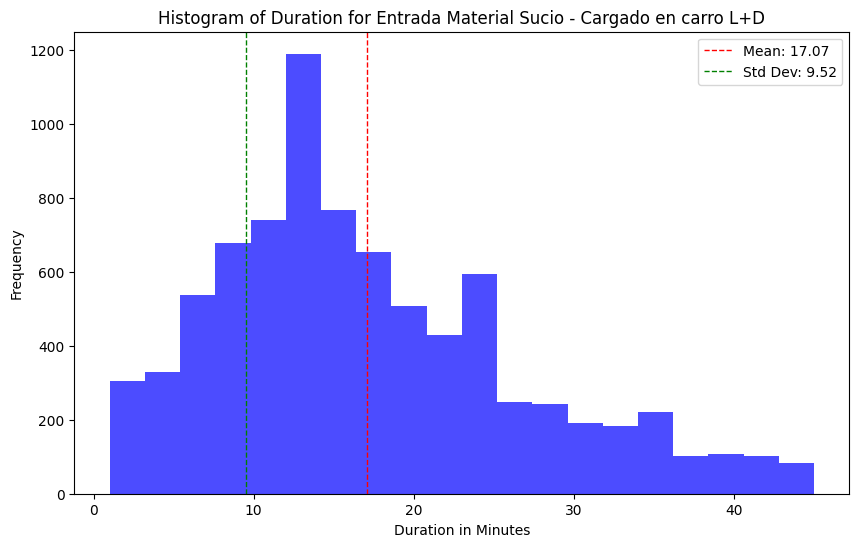

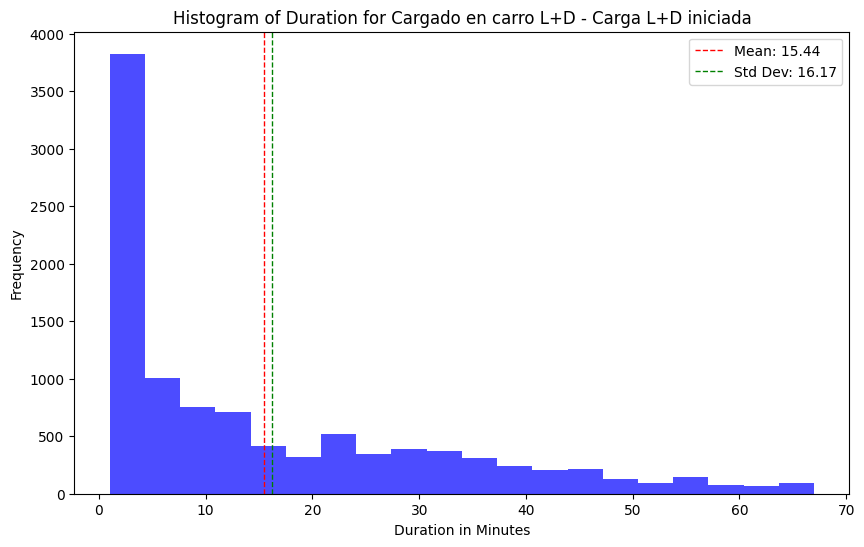

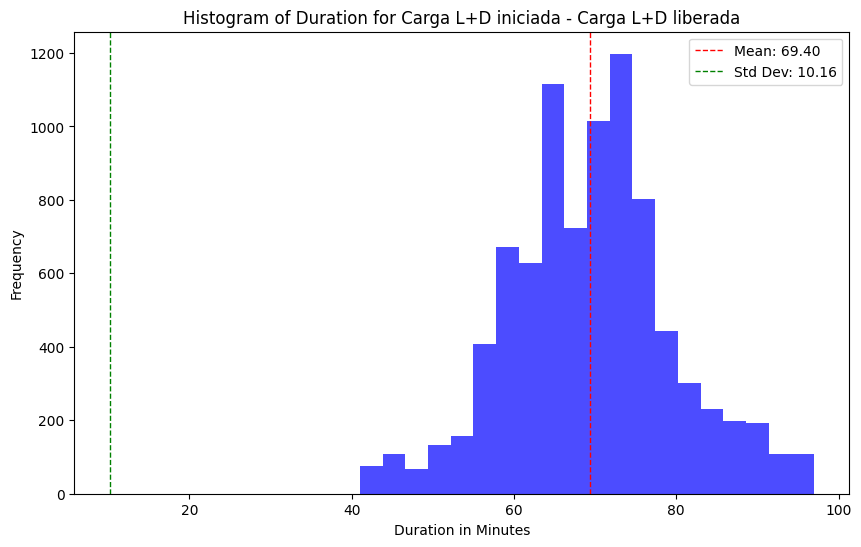

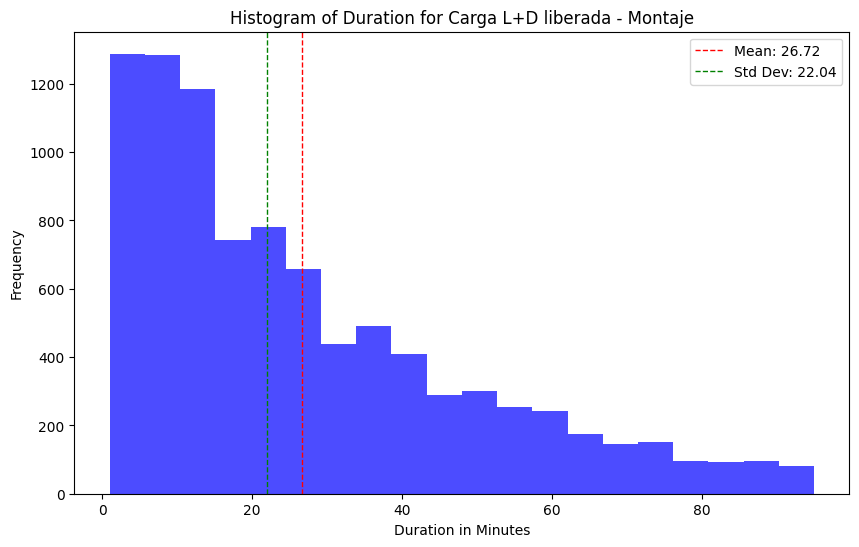

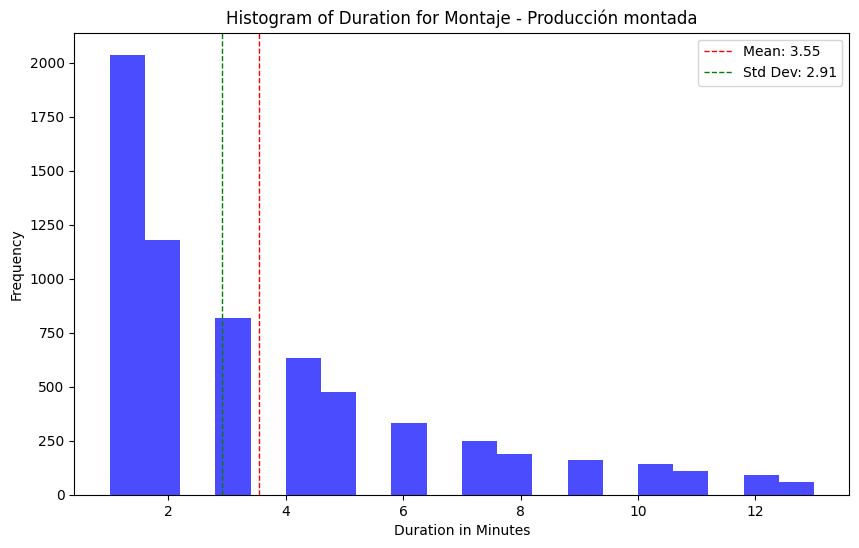

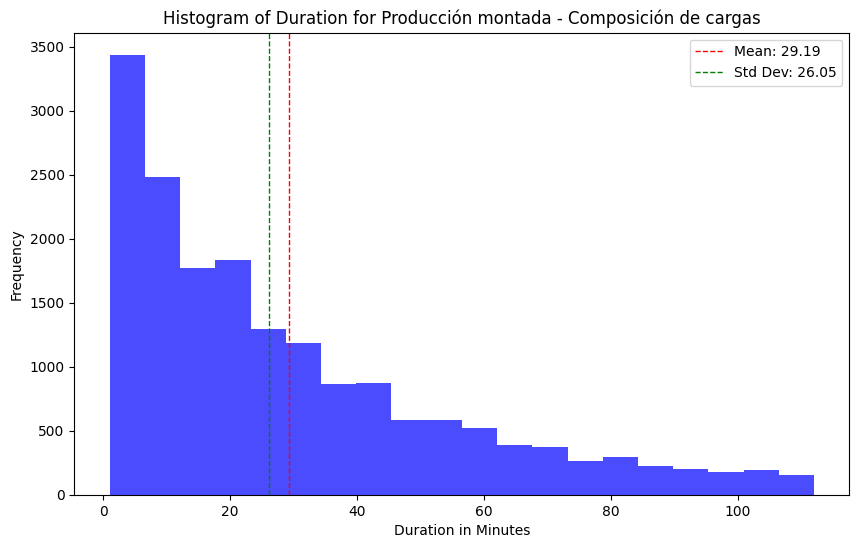

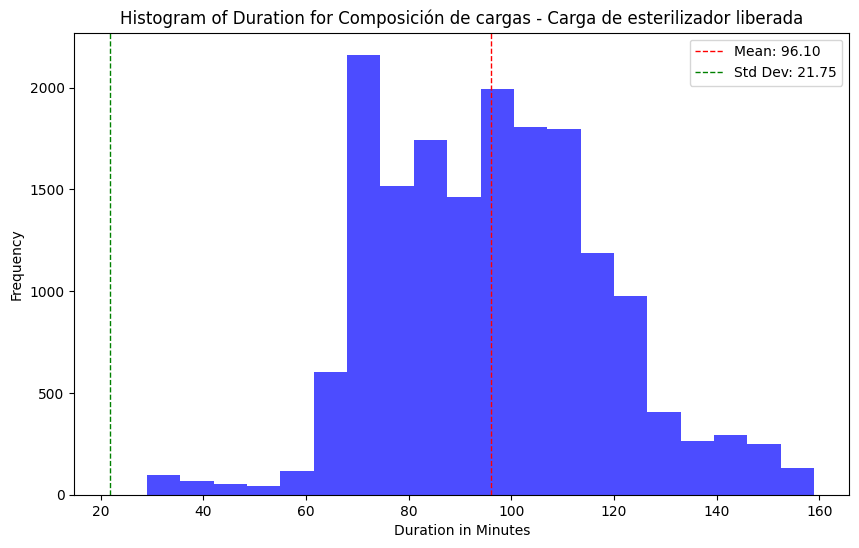

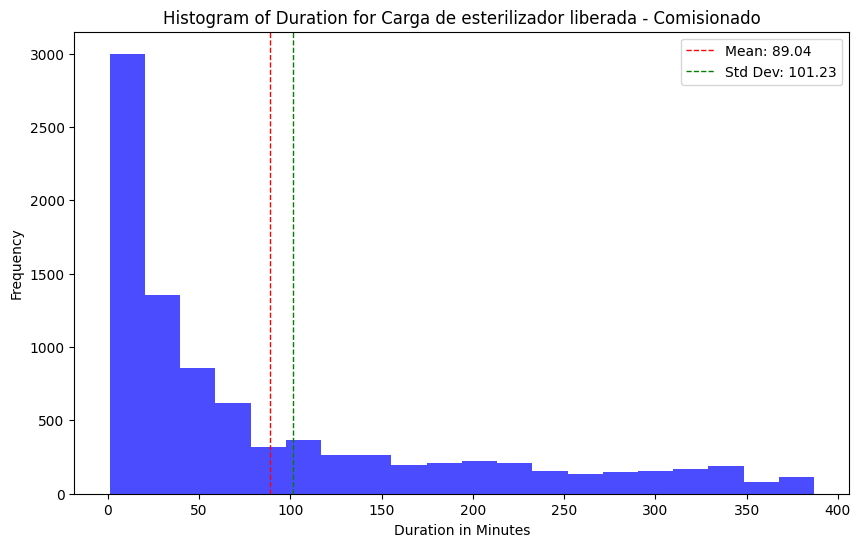

In [241]:
news_df = test.copy()

segments = ['Entrada Material Sucio - Cargado en carro L+D',
            'Cargado en carro L+D - Carga L+D iniciada',
            'Carga L+D iniciada - Carga L+D liberada',
            'Carga L+D liberada - Montaje',
            'Montaje - Producción montada',
            'Producción montada - Composición de cargas',
            'Composición de cargas - Carga de esterilizador liberada',
            'Carga de esterilizador liberada - Comisionado'
           ]

for segment in segments:
    segment_df = news_df[news_df['segment_name'] == segment]
    
    if not segment_df.empty:

        Q1 = segment_df['durationMinutes'].quantile(0.25)
        Q3 = segment_df['durationMinutes'].quantile(0.75)
        IQR = Q3 - Q1
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        filtered_segment_df = segment_df[(segment_df['durationMinutes'] >= lower_bound) & 
                                         (segment_df['durationMinutes'] <= upper_bound)]
        
        if not filtered_segment_df.empty:
            plt.figure(figsize=(10, 6))
            plt.hist(filtered_segment_df['durationMinutes'], bins=20, color='blue', alpha=0.7)
            plt.title(f'Histogram of Duration for {segment}')
            plt.xlabel('Duration in Minutes')
            plt.ylabel('Frequency')
            plt.axvline(filtered_segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {filtered_segment_df["durationMinutes"].mean():.2f}')
            plt.axvline(filtered_segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {filtered_segment_df["durationMinutes"].std():.2f}')
            plt.legend()
            plt.show()

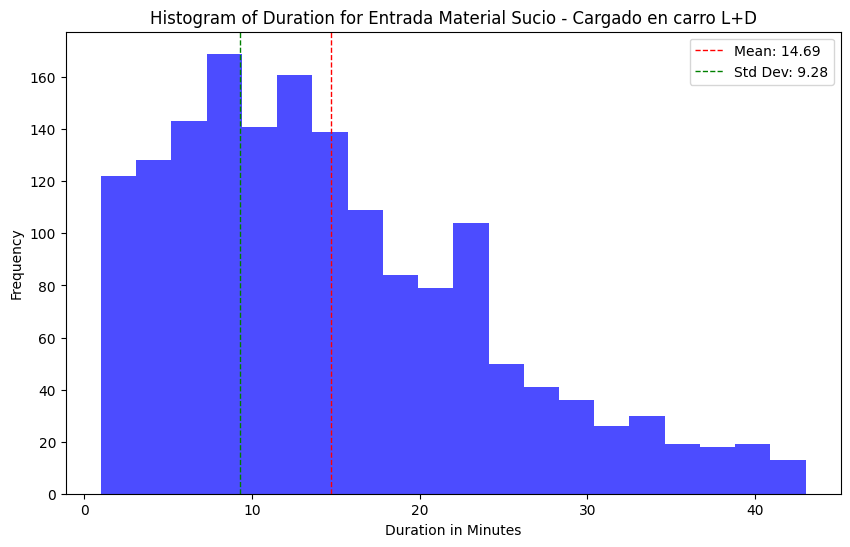

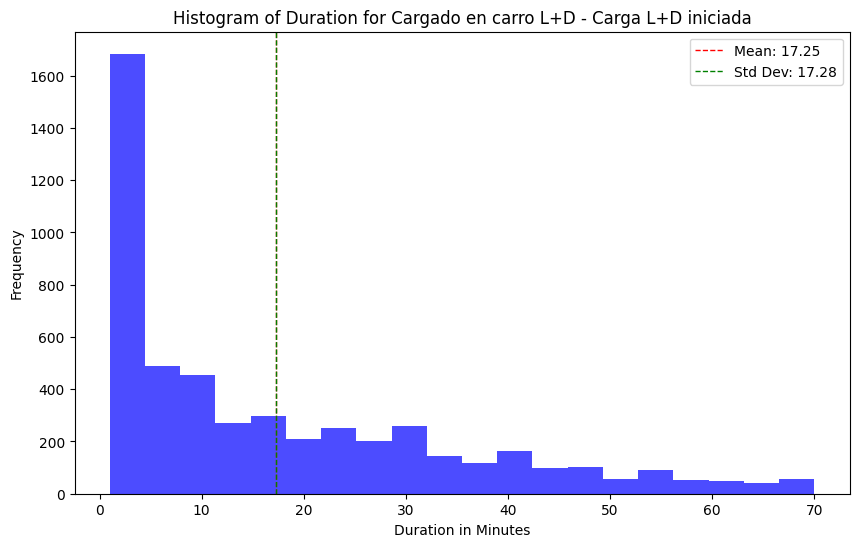

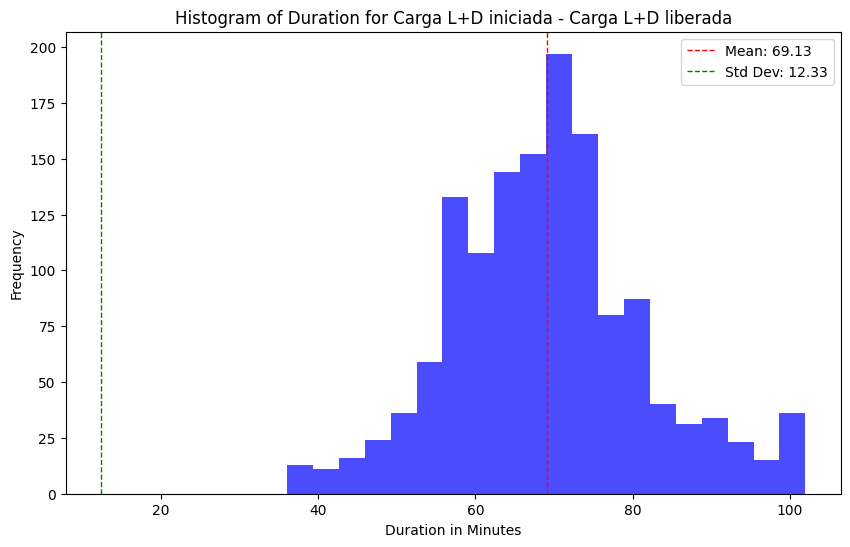

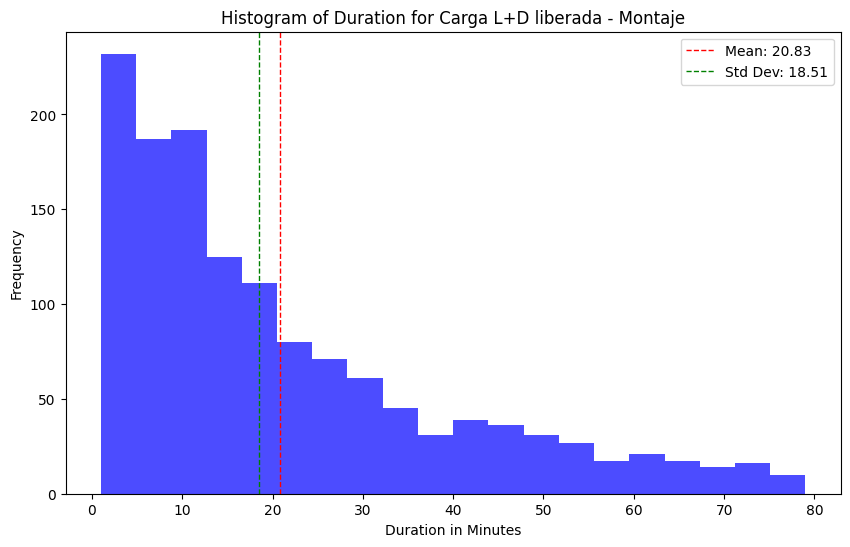

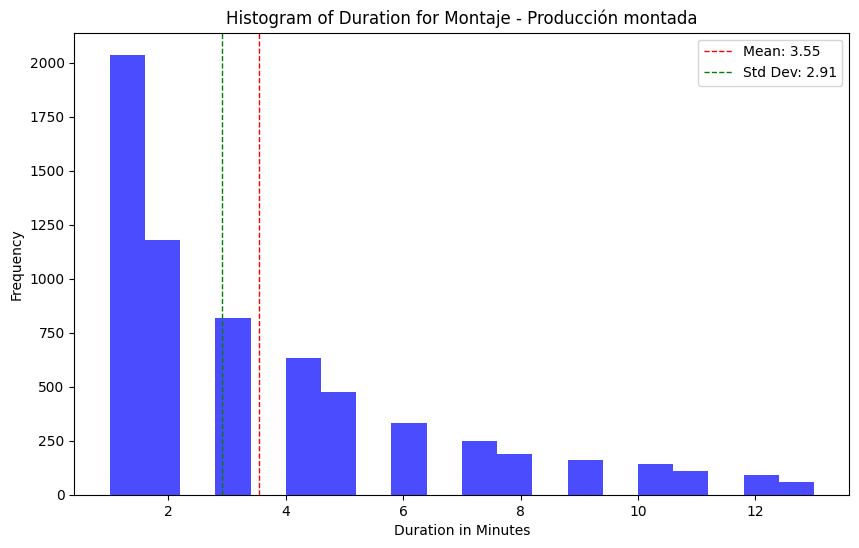

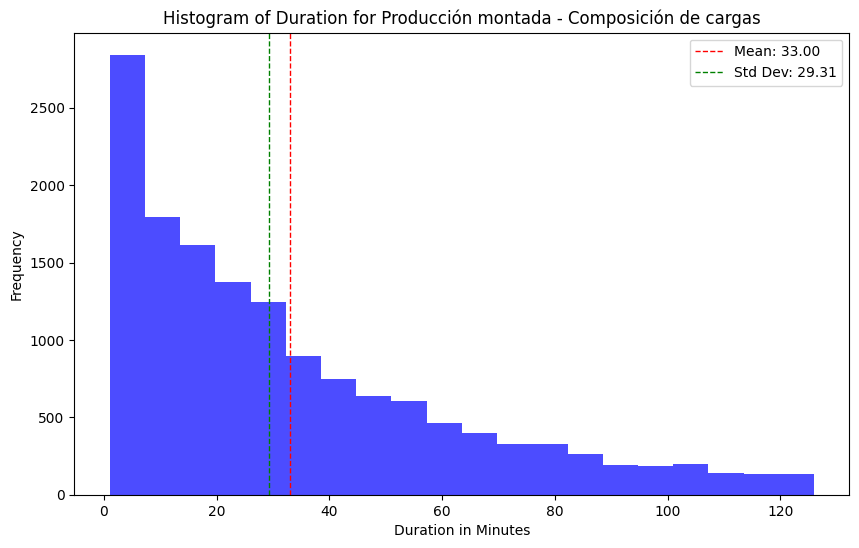

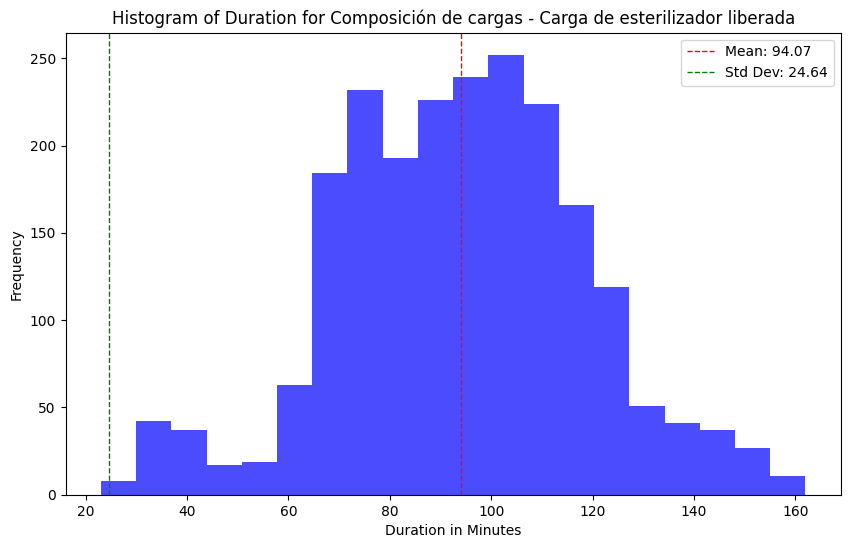

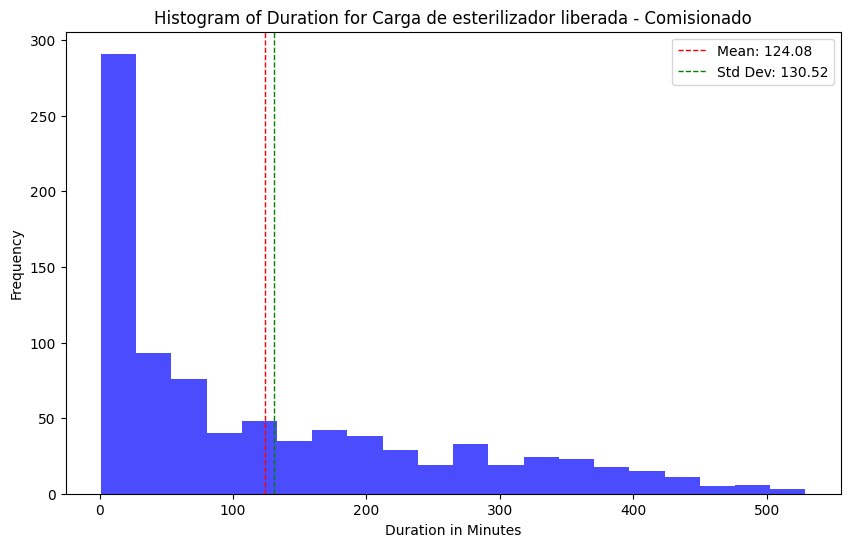

In [242]:
news_df = test.copy()

segments = ['Entrada Material Sucio - Cargado en carro L+D',
            'Cargado en carro L+D - Carga L+D iniciada',
            'Carga L+D iniciada - Carga L+D liberada',
            'Carga L+D liberada - Montaje',
            'Montaje - Producción montada',
            'Producción montada - Composición de cargas',
            'Composición de cargas - Carga de esterilizador liberada',
            'Carga de esterilizador liberada - Comisionado'
           ]

for segment in segments:
    segment_df = news_df[news_df['segment_name'] == segment]
    
    if not segment_df.empty:

        segment_df = segment_df.drop_duplicates(subset=['start_e.timestamp', 'start_e.Usuario', 'segment_name'])
        
        Q1 = segment_df['durationMinutes'].quantile(0.25)
        Q3 = segment_df['durationMinutes'].quantile(0.75)
        IQR = Q3 - Q1
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        filtered_segment_df = segment_df[(segment_df['durationMinutes'] >= lower_bound) & 
                                         (segment_df['durationMinutes'] <= upper_bound)]
        
        if not filtered_segment_df.empty:
            plt.figure(figsize=(10, 6))
            plt.hist(filtered_segment_df['durationMinutes'], bins=20, color='blue', alpha=0.7)
            plt.title(f'Histogram of Duration for {segment}')
            plt.xlabel('Duration in Minutes')
            plt.ylabel('Frequency')
            plt.axvline(filtered_segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {filtered_segment_df["durationMinutes"].mean():.2f}')
            plt.axvline(filtered_segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {filtered_segment_df["durationMinutes"].std():.2f}')
            plt.legend()
            plt.show()


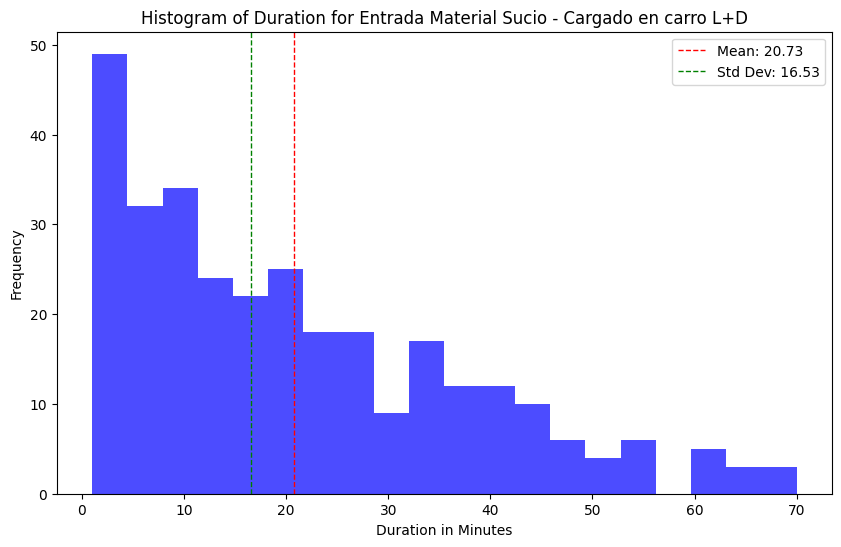

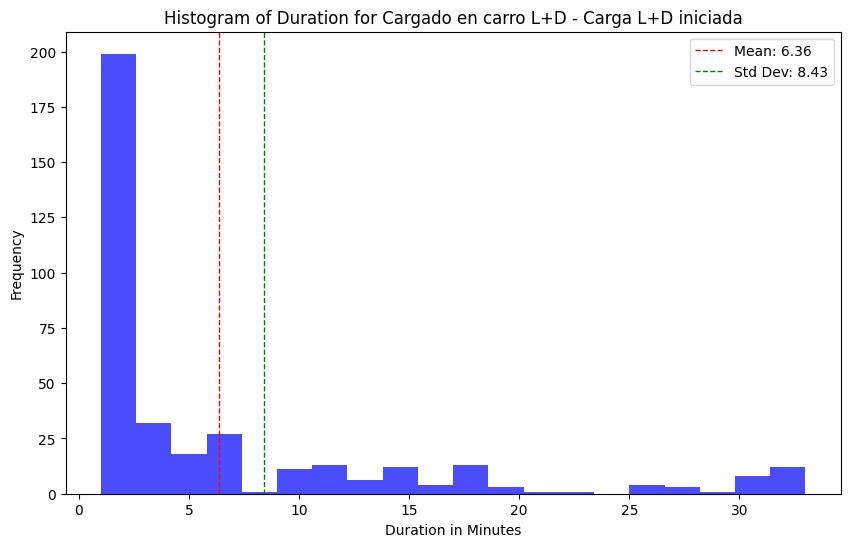

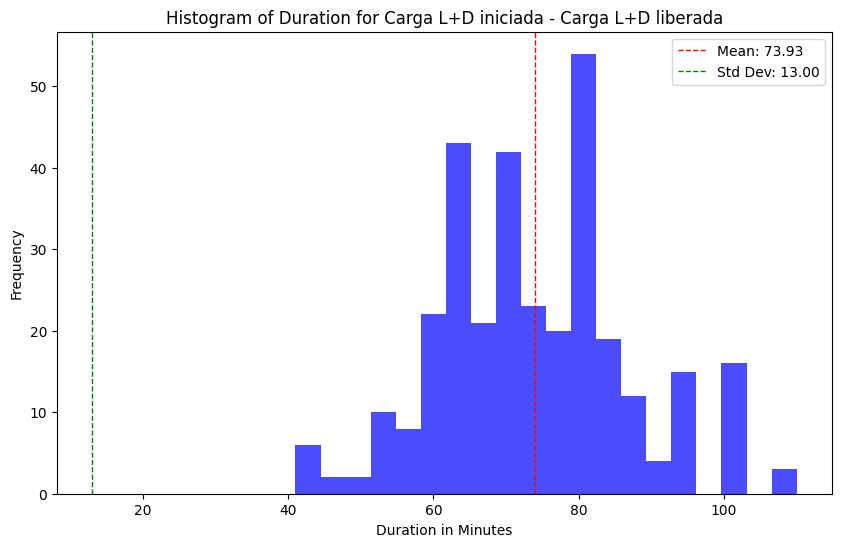

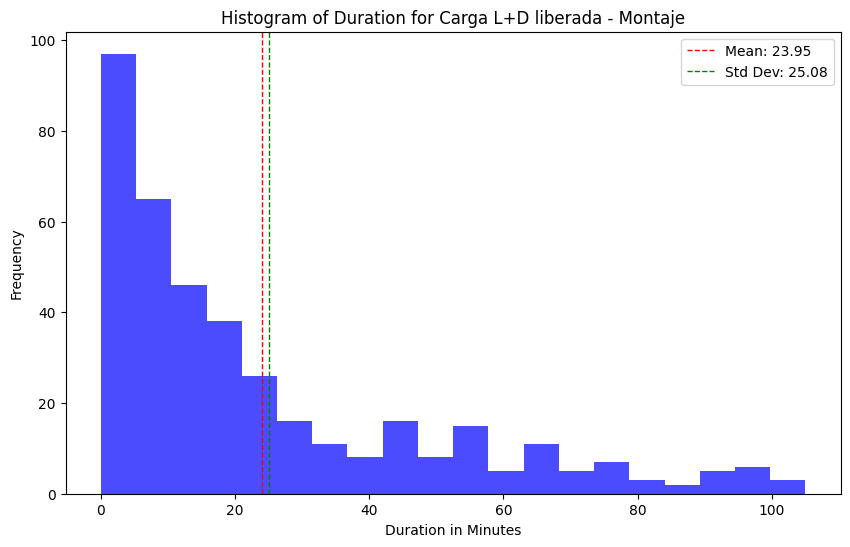

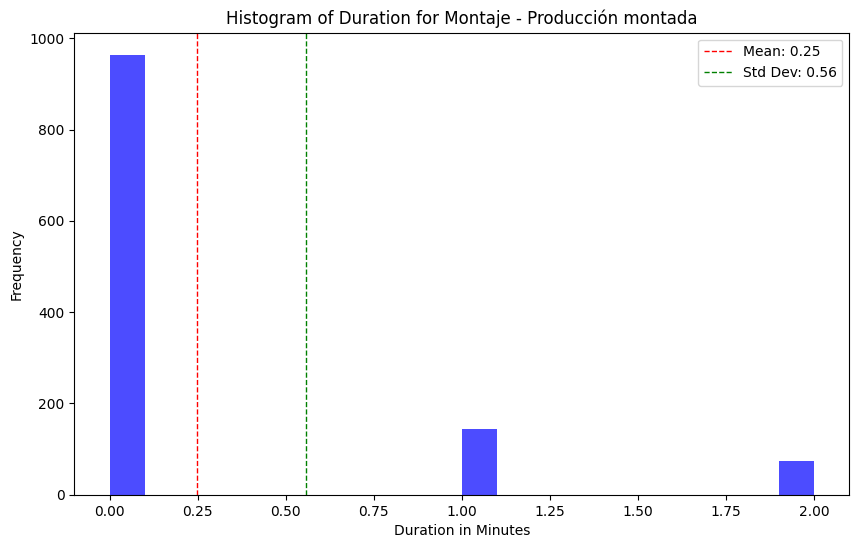

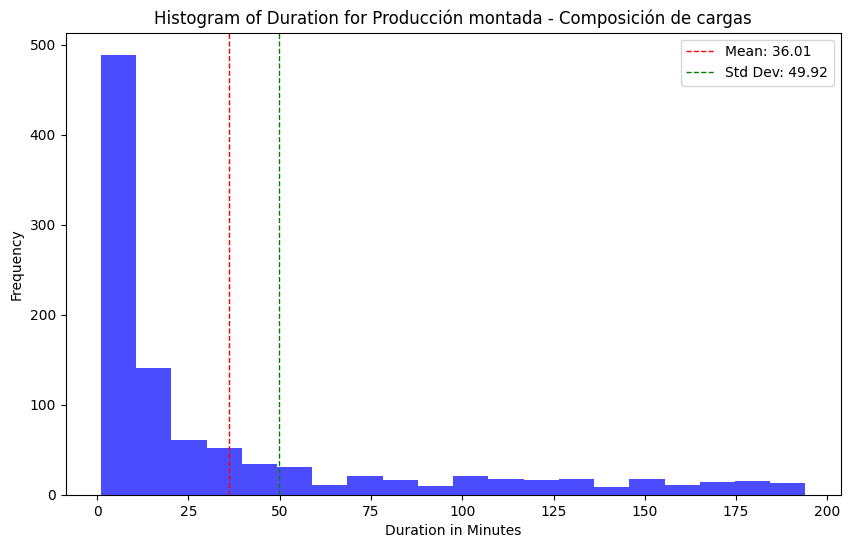

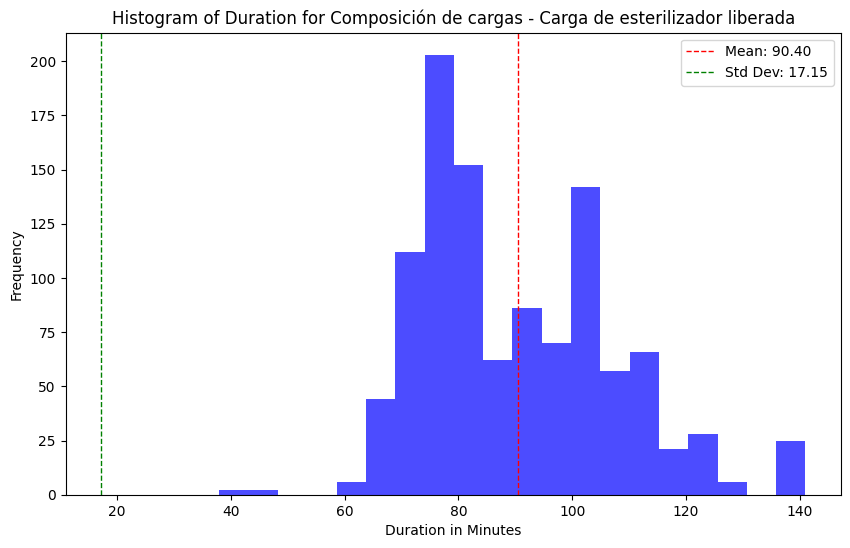

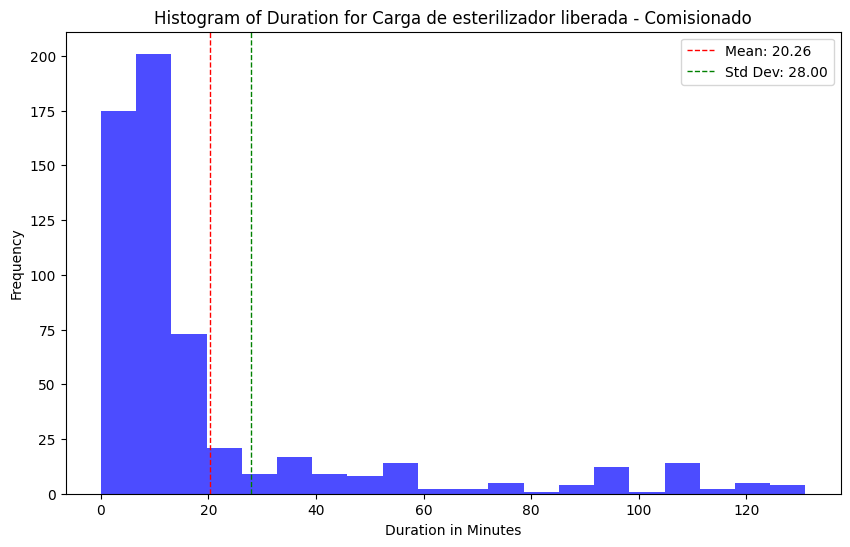

In [229]:
news_df = filtered_result_wedf.copy()

segments = ['Entrada Material Sucio - Cargado en carro L+D',
            'Cargado en carro L+D - Carga L+D iniciada',
            'Carga L+D iniciada - Carga L+D liberada',
            'Carga L+D liberada - Montaje',
            'Montaje - Producción montada',
            'Producción montada - Composición de cargas',
            'Composición de cargas - Carga de esterilizador liberada',
            'Carga de esterilizador liberada - Comisionado'
           ]

for segment in segments:
    segment_df = news_df[news_df['segment_name'] == segment]
    
    if not segment_df.empty:

        Q1 = segment_df['durationMinutes'].quantile(0.25)
        Q3 = segment_df['durationMinutes'].quantile(0.75)
        IQR = Q3 - Q1
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        filtered_segment_df = segment_df[(segment_df['durationMinutes'] >= lower_bound) & 
                                         (segment_df['durationMinutes'] <= upper_bound)]
        
        if not filtered_segment_df.empty:
            plt.figure(figsize=(10, 6))
            plt.hist(filtered_segment_df['durationMinutes'], bins=20, color='blue', alpha=0.7)
            plt.title(f'Histogram of Duration for {segment}')
            plt.xlabel('Duration in Minutes')
            plt.ylabel('Frequency')
            plt.axvline(filtered_segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {filtered_segment_df["durationMinutes"].mean():.2f}')
            plt.axvline(filtered_segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {filtered_segment_df["durationMinutes"].std():.2f}')
            plt.legend()
            plt.show()

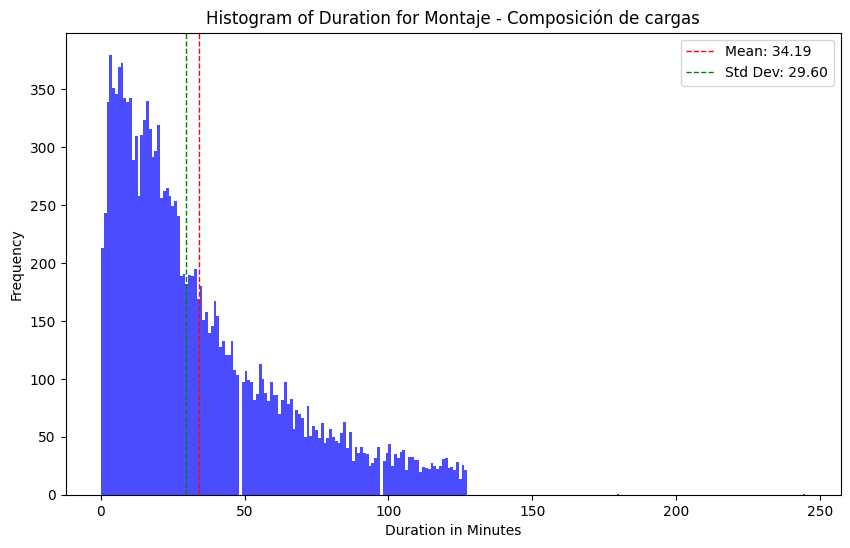

In [225]:
newss_df = filtered_result_wddf.copy()

segments_to_sum = {'Montaje - Producción montada', 
                   'Producción montada - Producción montada', 
                   'Producción montada - Composición de cargas'}

filtered_newss_df = newss_df[newss_df['segment_name'].isin(segments_to_sum)]

summed_durations = filtered_newss_df.groupby('start_r.CaseID').agg({
    'durationMinutes': 'sum',
    'start_e.Usuario': 'first',
    'start_e.timestamp': 'first',
    'start_e.KitID': 'first',
    'start_e.NS': 'first',
    'start_e.Código': 'first',
    'end_e.Usuario': 'last',
    'end_e.timestamp': 'last',
    'end_e.KitID': 'last',
    'end_e.NS': 'last',
    'end_e.Código': 'last',
    'start_date': 'first',
    'end_date': 'last'
}).reset_index()

Q1 = summed_durations['durationMinutes'].quantile(0.25)
Q3 = summed_durations['durationMinutes'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

filtered_summed_durations = summed_durations[
    (summed_durations['durationMinutes'] >= lower_bound) & 
    (summed_durations['durationMinutes'] <= upper_bound)
]

filtered_summed_durations['segment_name'] = 'Montaje - Composición de cargas'

newss_df = newss_df.append(filtered_summed_durations, ignore_index=True)

newss_df = newss_df[~newss_df['segment_name'].isin(segments_to_sum)]

segments = [
            'Montaje - Composición de cargas'
           ]

for segment in segments:
    segment_df = newss_df[newss_df['segment_name'] == segment]
    
    if not segment_df.empty:
        plt.figure(figsize=(10, 6))
        plt.hist(segment_df['durationMinutes'], bins=250, color='blue', alpha=.7)
        plt.title(f'Histogram of Duration for {segment}')
        plt.xlabel('Duration in Minutes')
        plt.ylabel('Frequency')
        plt.axvline(segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {segment_df["durationMinutes"].mean():.2f}')
        plt.axvline(segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {segment_df["durationMinutes"].std():.2f}')
        plt.legend()
        plt.show()


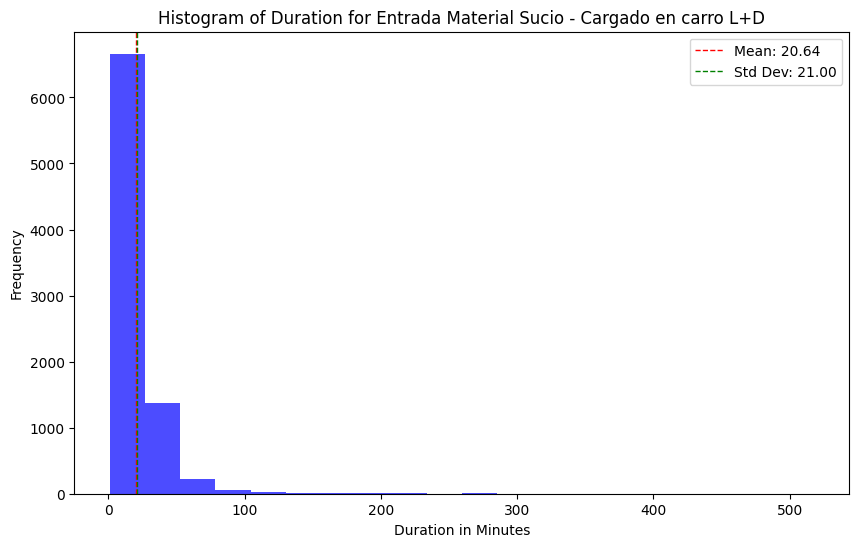

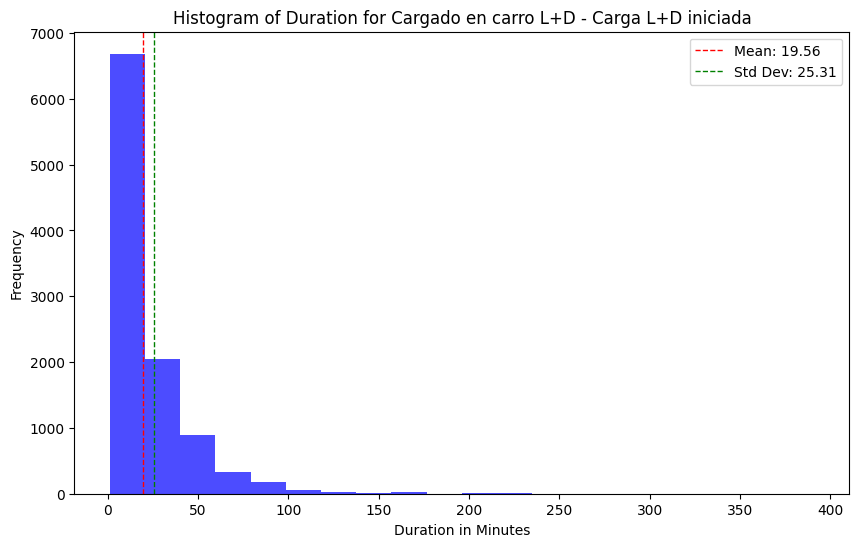

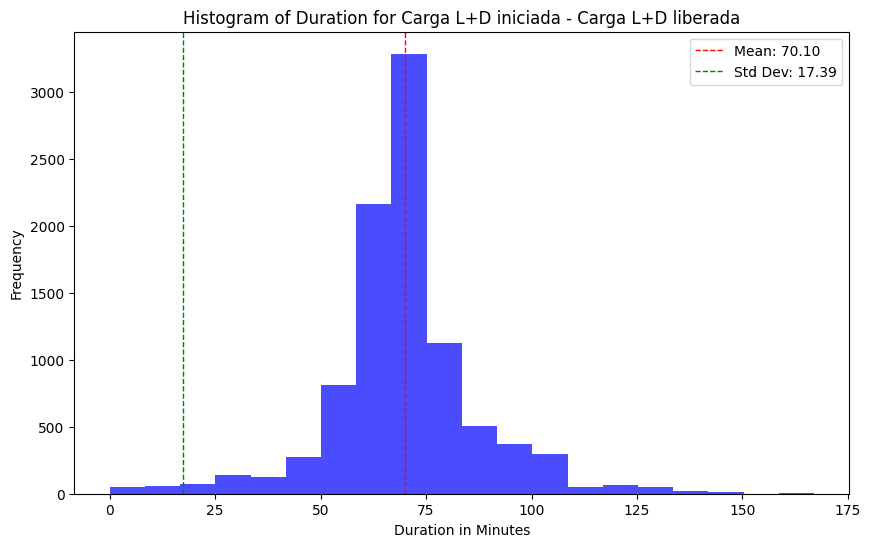

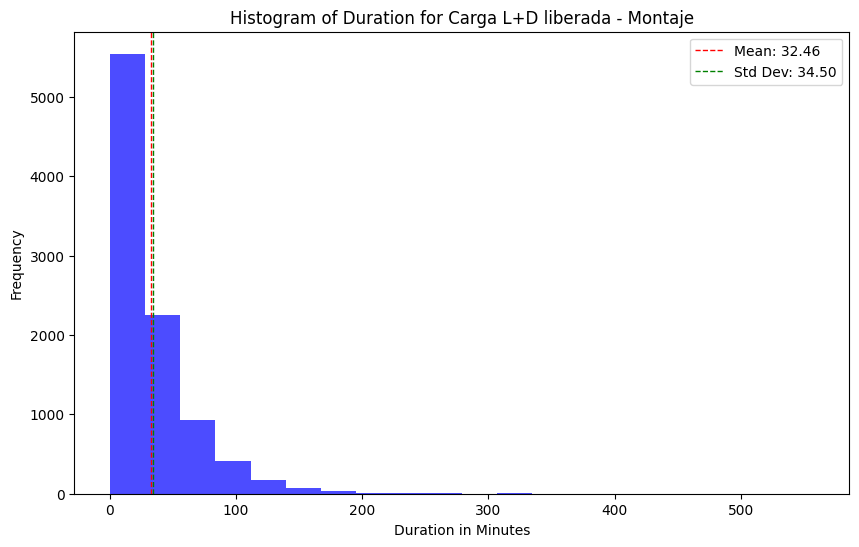

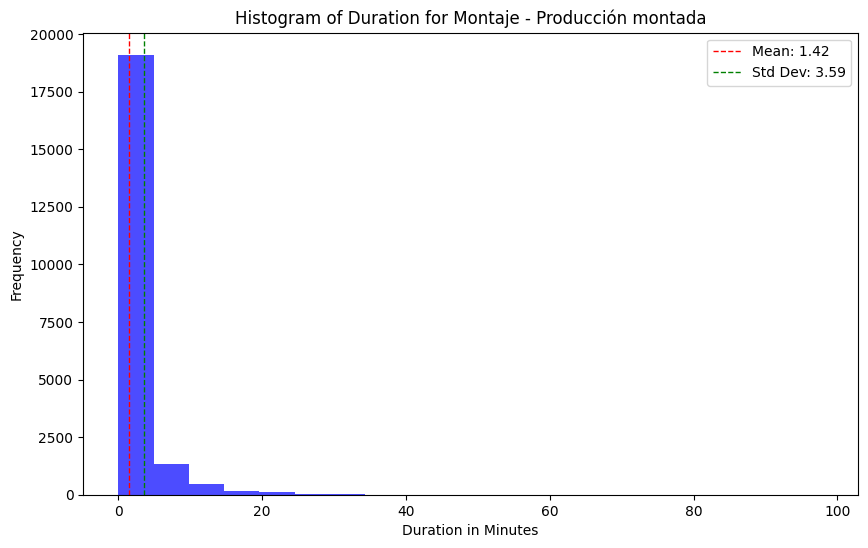

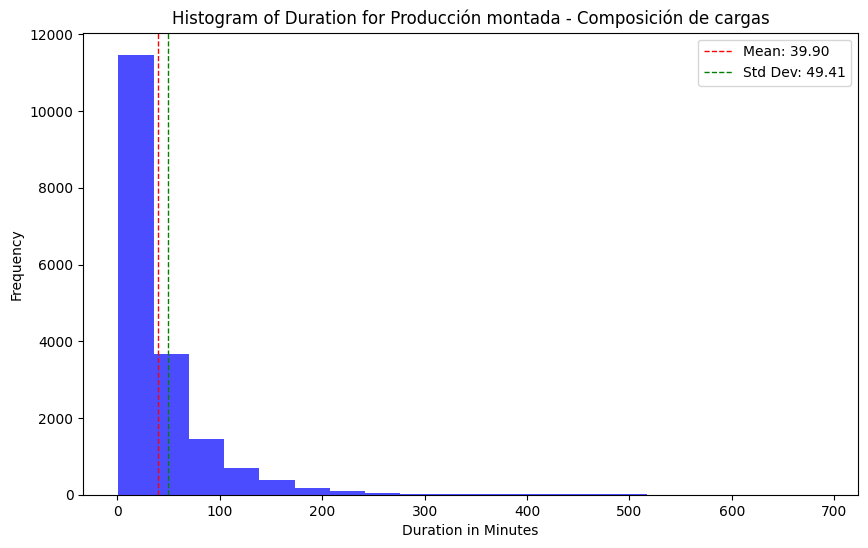

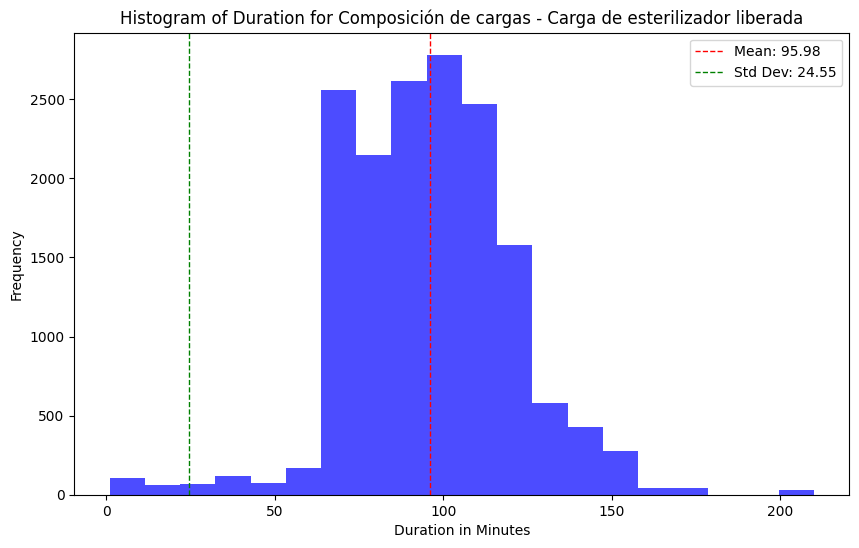

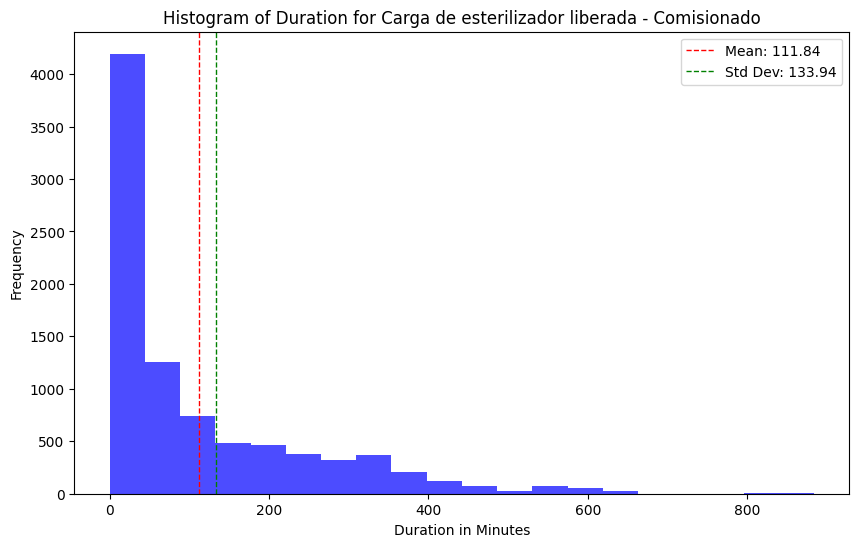

In [209]:

news_df = filtered_result_wddf.copy()

segments = ['Entrada Material Sucio - Cargado en carro L+D',
            'Cargado en carro L+D - Carga L+D iniciada',
            'Carga L+D iniciada - Carga L+D liberada',
            'Carga L+D liberada - Montaje',
            'Montaje - Producción montada',
            'Producción montada - Composición de cargas',
            'Composición de cargas - Carga de esterilizador liberada',
            'Carga de esterilizador liberada - Comisionado'
           ]

for segment in segments:
    segment_df = news_df[news_df['segment_name'] == segment]
    
    if not segment_df.empty:
        plt.figure(figsize=(10, 6))
        plt.hist(segment_df['durationMinutes'], bins=20, color='blue', alpha=0.7)
        plt.title(f'Histogram of Duration for {segment}')
        plt.xlabel('Duration in Minutes')
        plt.ylabel('Frequency')
        plt.axvline(segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {segment_df["durationMinutes"].mean():.2f}')
        plt.axvline(segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {segment_df["durationMinutes"].std():.2f}')
        plt.legend()
        plt.show()


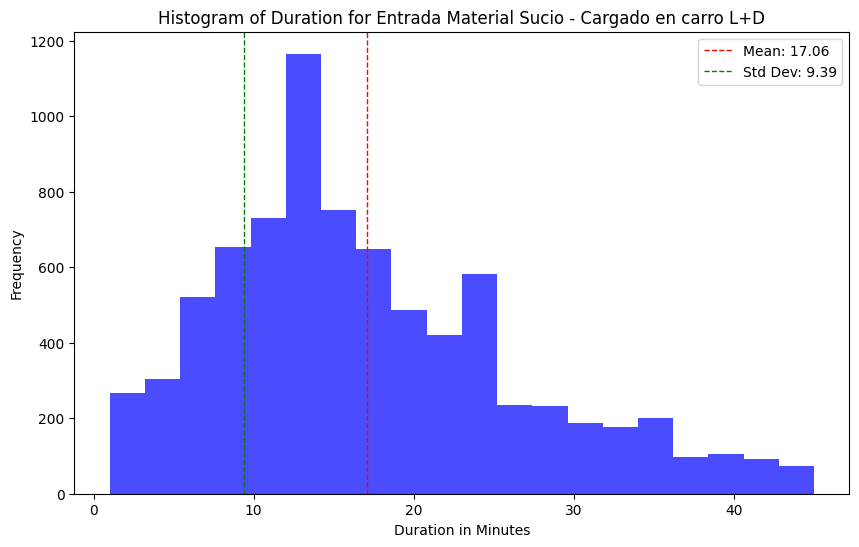

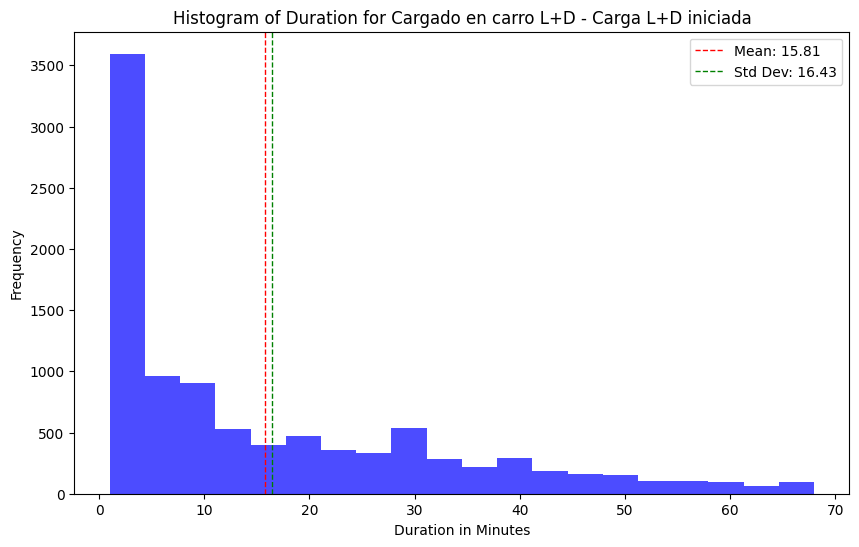

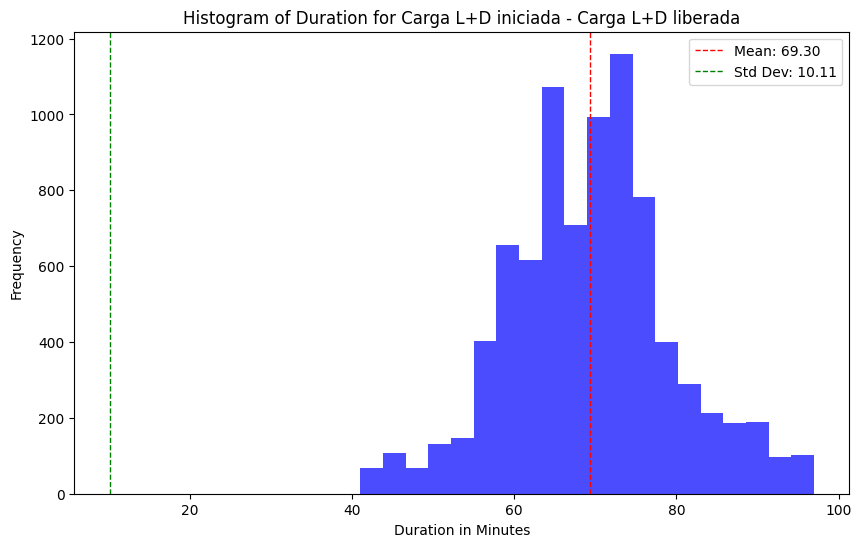

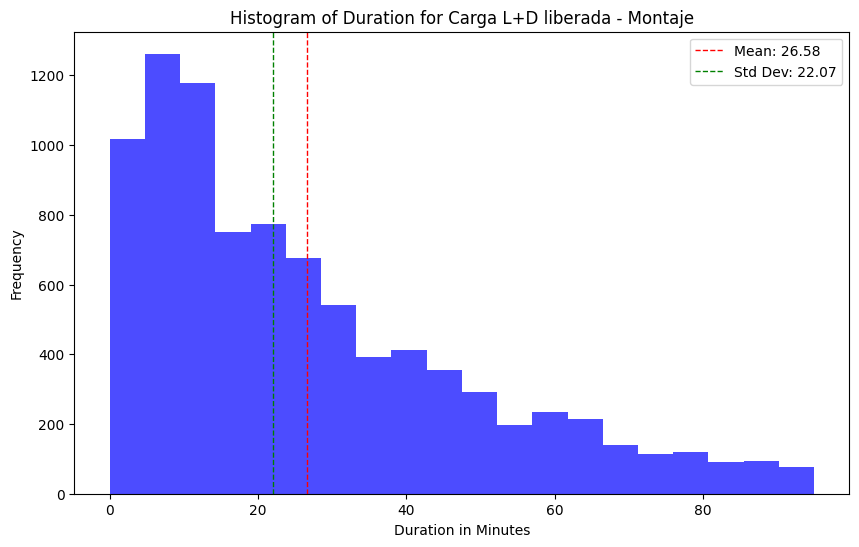

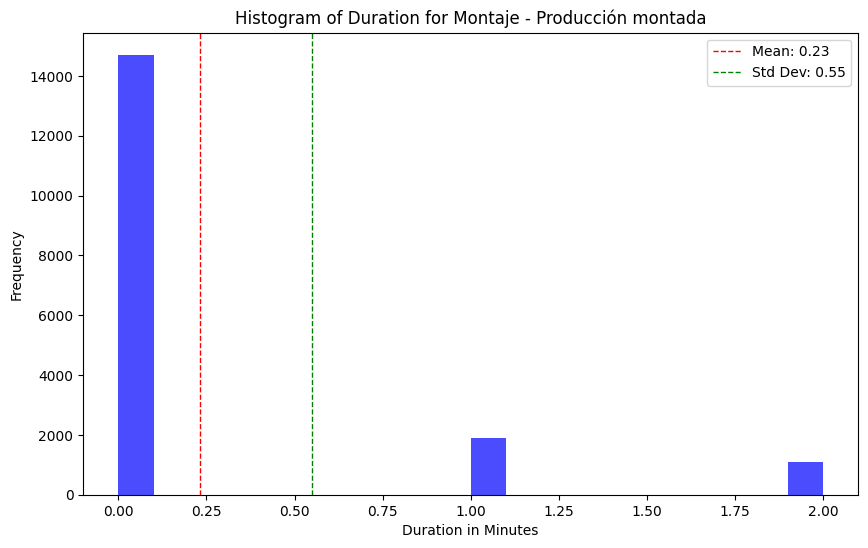

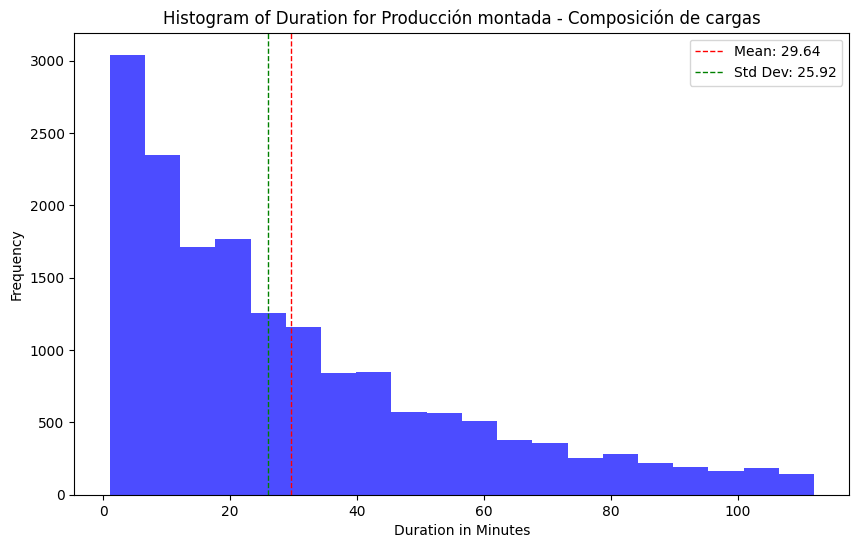

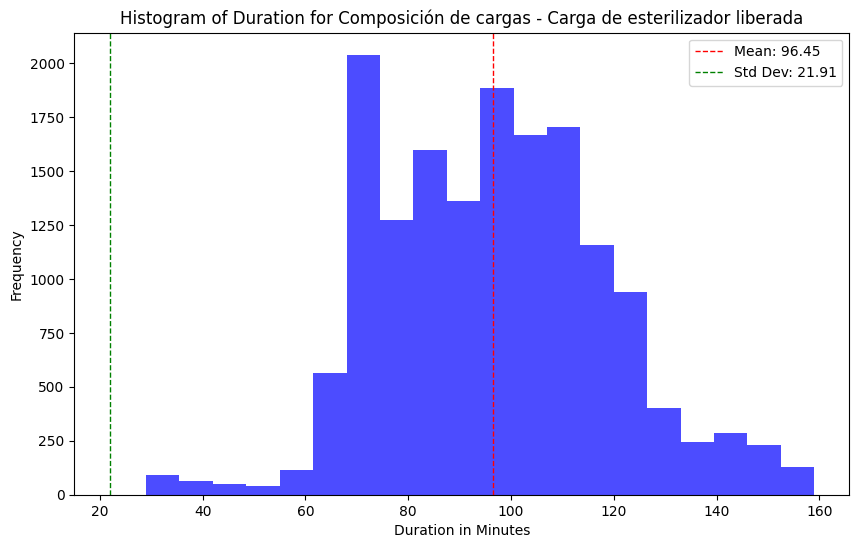

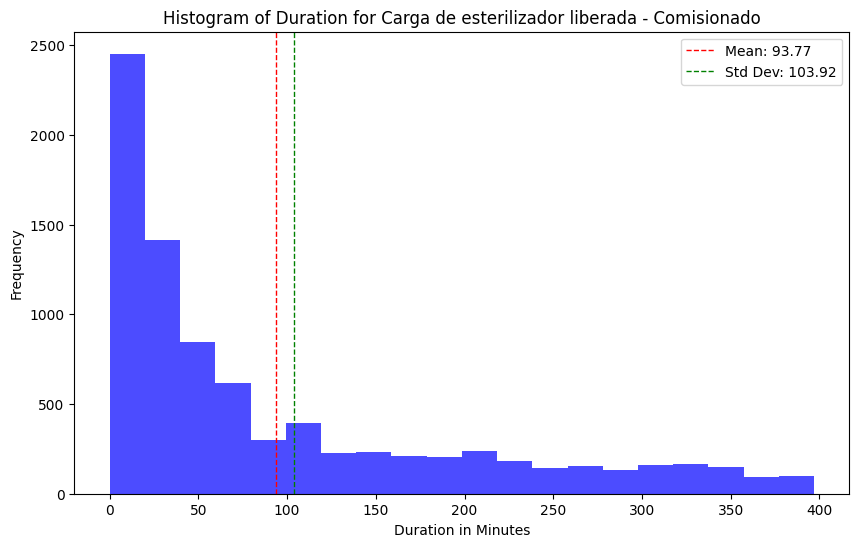

In [228]:
news_df = filtered_result_wddf.copy()

segments = ['Entrada Material Sucio - Cargado en carro L+D',
            'Cargado en carro L+D - Carga L+D iniciada',
            'Carga L+D iniciada - Carga L+D liberada',
            'Carga L+D liberada - Montaje',
            'Montaje - Producción montada',
            'Producción montada - Composición de cargas',
            'Composición de cargas - Carga de esterilizador liberada',
            'Carga de esterilizador liberada - Comisionado'
           ]

for segment in segments:
    segment_df = news_df[news_df['segment_name'] == segment]
    
    if not segment_df.empty:

        Q1 = segment_df['durationMinutes'].quantile(0.25)
        Q3 = segment_df['durationMinutes'].quantile(0.75)
        IQR = Q3 - Q1
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        filtered_segment_df = segment_df[(segment_df['durationMinutes'] >= lower_bound) & 
                                         (segment_df['durationMinutes'] <= upper_bound)]
        
        if not filtered_segment_df.empty:
            plt.figure(figsize=(10, 6))
            plt.hist(filtered_segment_df['durationMinutes'], bins=20, color='blue', alpha=0.7)
            plt.title(f'Histogram of Duration for {segment}')
            plt.xlabel('Duration in Minutes')
            plt.ylabel('Frequency')
            plt.axvline(filtered_segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {filtered_segment_df["durationMinutes"].mean():.2f}')
            plt.axvline(filtered_segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {filtered_segment_df["durationMinutes"].std():.2f}')
            plt.legend()
            plt.show()

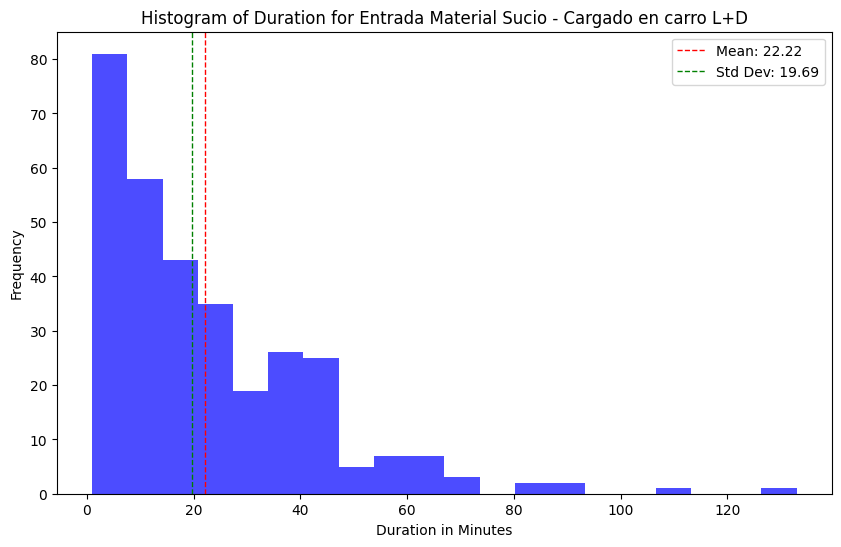

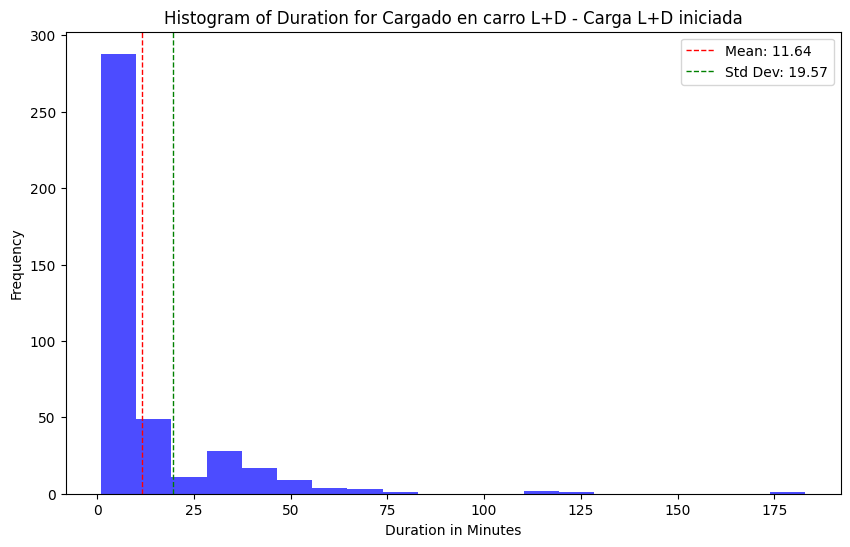

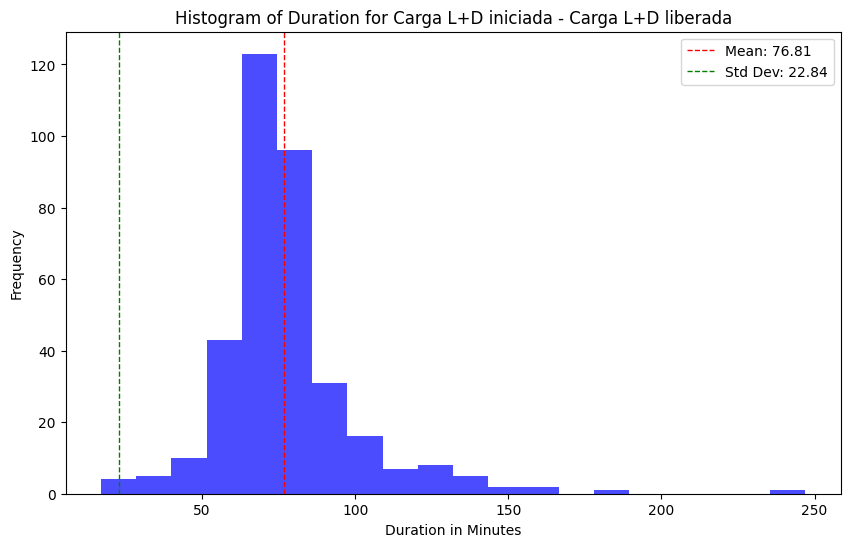

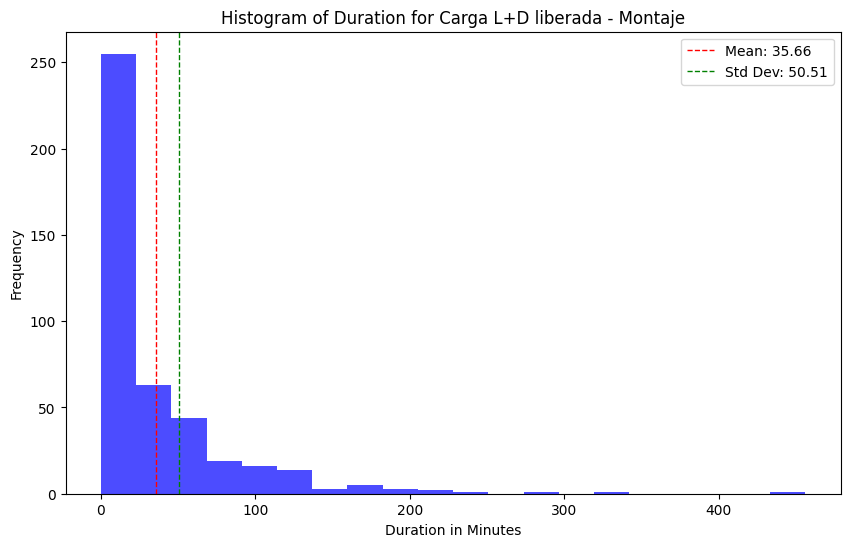

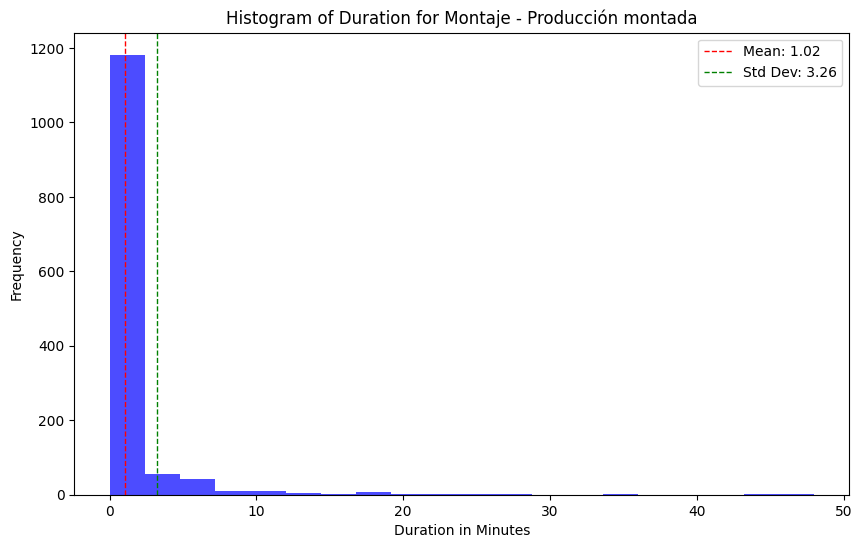

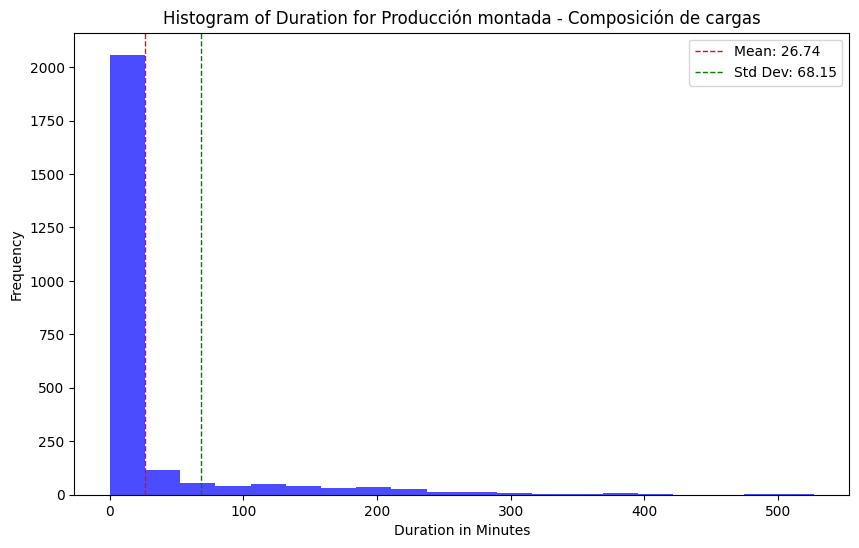

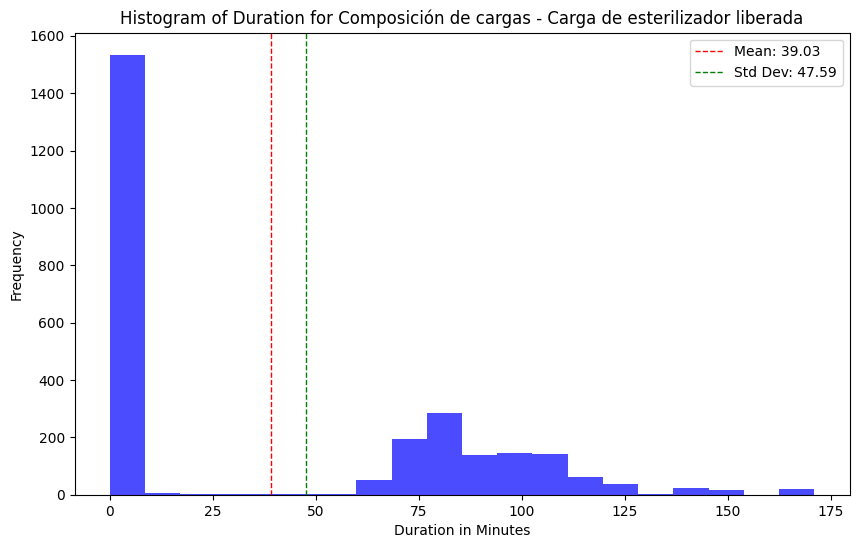

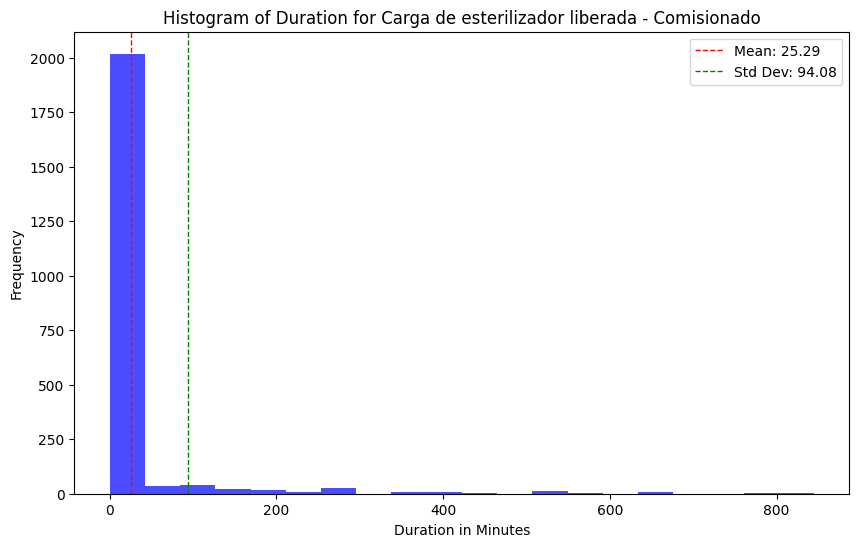

In [207]:
new_df = filtered_result_wedf.copy()
segment_mapping = {
   'Producción montada - Producción montada': 'Producción montada - Composición de cargas',
   'Producción montada - Composición de cargas': 'Producción montada - Composición de cargas',
   'Composición de cargas - Composición de cargas': 'Composición de cargas - Carga de esterilizador liberada',
   'Composición de cargas - Carga de esterilizador liberada': 'Composición de cargas - Carga de esterilizador liberada',
   'Carga de esterilizador liberada - Carga de esterilizador liberada': 'Carga de esterilizador liberada - Comisionado',
   'Carga de esterilizador liberada - Comisionado': 'Carga de esterilizador liberada - Comisionado'
}

new_df['segment_name'] = new_df['segment_name'].replace(segment_mapping)

segments = ['Entrada Material Sucio - Cargado en carro L+D',
            'Cargado en carro L+D - Carga L+D iniciada',
            'Carga L+D iniciada - Carga L+D liberada',
            'Carga L+D liberada - Montaje',
            'Montaje - Producción montada',
            'Producción montada - Composición de cargas',
            'Composición de cargas - Carga de esterilizador liberada',
            'Carga de esterilizador liberada - Comisionado'
           ]

for segment in segments:
    segment_df = new_df[new_df['segment_name'] == segment]
    
    if not segment_df.empty:
        plt.figure(figsize=(10, 6))
        plt.hist(segment_df['durationMinutes'], bins=20, color='blue', alpha=0.7)
        plt.title(f'Histogram of Duration for {segment}')
        plt.xlabel('Duration in Minutes')
        plt.ylabel('Frequency')
        plt.axvline(segment_df['durationMinutes'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean: {segment_df["durationMinutes"].mean():.2f}')
        plt.axvline(segment_df['durationMinutes'].std(), color='green', linestyle='dashed', linewidth=1, label=f'Std Dev: {segment_df["durationMinutes"].std():.2f}')
        plt.legend()
        plt.show()


In [186]:
print(grouped["Weekends"])

                                                count       mean        std  \
segment_name                                                                  
Carga L+D iniciada - Carga L+D iniciada          23.0   2.521739   2.889944   
Carga L+D iniciada - Carga L+D liberada         322.0  73.928571  13.003158   
Carga L+D iniciada - Cargado en carro L+D       169.0   0.000000   0.000000   
Carga L+D iniciada - Comisionado                  4.0  47.250000  32.014320   
Carga L+D iniciada - Montaje                      8.0  30.625000  31.341153   
...                                               ...        ...        ...   
Entrada Material Sucio - Composición de cargas    NaN        NaN        NaN   
Montaje - Carga L+D iniciada                      NaN        NaN        NaN   
Montaje - Carga L+D liberada                      NaN        NaN        NaN   
Montaje - Comisionado                             NaN        NaN        NaN   
Producción montada - Cargado en carro L+D         Na

In [187]:
segments = ['Entrada Material Sucio - Cargado en carro L+D',
                                    'Cargado en carro L+D - Carga L+D iniciada',
                                    'Carga L+D iniciada - Carga L+D liberada',
                                     'Carga L+D liberada - Montaje',
                                       'Montaje - Producción montada',
                                       'Producción montada - Producción montada',
                                       'Producción montada - Composición de cargas',
                                       'Composición de cargas - Composición de cargas',
                                       'Composición de cargas - Carga de esterilizador liberada',
                                       'Carga de esterilizador liberada - Carga de esterilizador liberada'
                                       ]
for segment in segments:
  print(grouped.loc[segment])

  # procuccion montada 
  # mean 32.8
  # std 37.9

Weekends  count     309.000000
          mean       20.731392
          std        16.528282
          min         1.000000
          25%         7.000000
          50%        16.000000
          75%        33.000000
          max        70.000000
Weekdays  count    7930.000000
          mean       17.056999
          std         9.386935
          min         1.000000
          25%        10.000000
          50%        15.000000
          75%        22.000000
          max        45.000000
Name: Entrada Material Sucio - Cargado en carro L+D, dtype: float64
Weekends  count     369.000000
          mean        6.355014
          std         8.430421
          min         1.000000
          25%         1.000000
          50%         2.000000
          75%         8.000000
          max        33.000000
Weekdays  count    9832.000000
          mean       15.812653
          std        16.428225
          min         1.000000
          25%         2.000000
          50%         9.000000
  

joint mean Producción montada - Composición de cargas 15.3
joint std Producción montada - Composición de cargas 20.436741

start mean 55.7
start std 109

free washing machine mean 25.3
free washing machine std 23.5

In [188]:
query = '''match (r:Run {EntityType: 'Kit'}) <- [:CORR] - (e:Event)
where e.timestamp.day = 27 and e.timestamp.month = 3 and r.durationInMinutes > 0 
and r.activities = 'Entrada Material Sucio, Cargado en carro L+D, Carga L+D iniciada, Carga L+D liberada, Montaje, Producción montada, Composición de cargas, Carga de esterilizador liberada'
return e.Usuario, e.timestamp, e.Activity, e.KitID, e.NS, e.Código, r.CaseID'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df.to_csv(common_path + 'output27-3.csv', header= True)

In [189]:
query = '''match (r:Run {EntityType: 'Kit'}) <- [:CORR] - (e:Event)
where not e.KitID contains "CONT"
return e.Usuario, e.timestamp, e.Activity, e.KitID, e.NS, e.Código, r.CaseID'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)
df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df['date'] = df['e.timestamp'].dt.date

case_count = df.groupby(['date', 'e.Activity'])['r.CaseID'].nunique().reset_index(name='case_count')

df_time_diff = df.groupby(['date', 'e.Activity']).apply(calc_time_diff).reset_index(drop=True)

result = pd.merge(case_count, df_time_diff, on=['date', 'e.Activity'])
result.head()


,date,e.Activity,case_count,e.Usuario,e.timestamp,e.KitID,e.NS,e.Código,r.CaseID,time_diff
0,2022-01-01,Carga L+D iniciada,17,MCE,2022-01-01 07:52:00+00:00,HUBU-URG.006-1,1,HUBU-URG.006,HUBU-URG.006-1-CN5,NaT
1,2022-01-01,Carga L+D iniciada,17,MCE,2022-01-01 08:29:00+00:00,HUBU-URG.005-3,3,HUBU-URG.005,HUBU-URG.005-3-CN4,0 days 00:37:00
2,2022-01-01,Carga L+D iniciada,17,MCE,2022-01-01 08:29:00+00:00,HUBU-URG.005-8,8,HUBU-URG.005,HUBU-URG.005-8-CN3,0 days 00:00:00
3,2022-01-01,Carga L+D iniciada,17,MCE,2022-01-01 08:29:00+00:00,HNB-GIN.014-33,33,HNB-GIN.014,HNB-GIN.014-33-CN11,0 days 00:00:00
4,2022-01-01,Carga L+D iniciada,17,MCE,2022-01-01 08:29:00+00:00,HNB-GIN.014-21,21,HNB-GIN.014,HNB-GIN.014-21-CN10,0 days 00:00:00


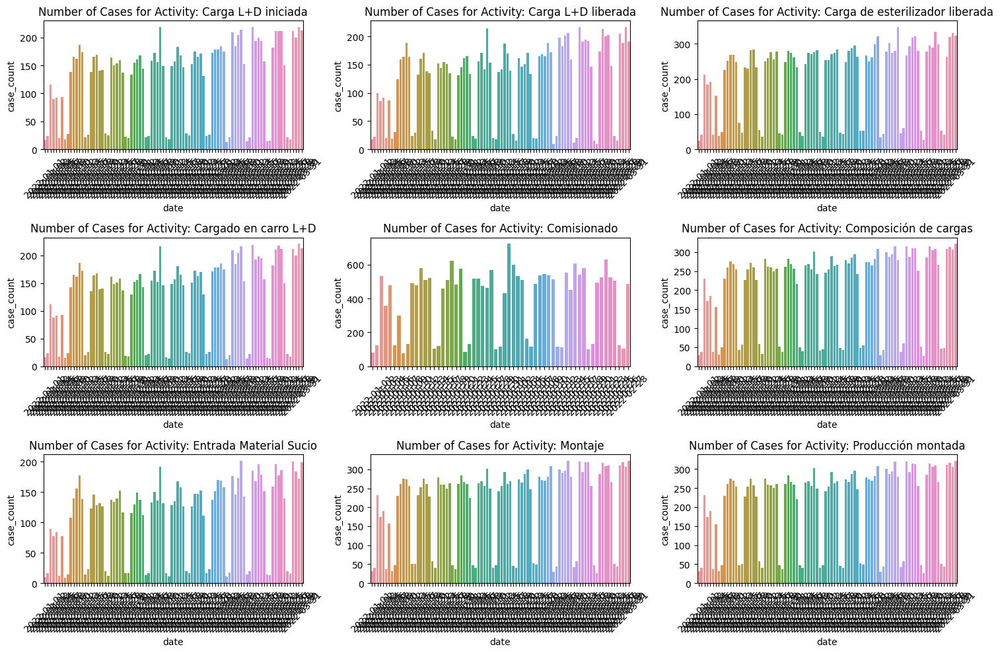

In [190]:
plt.figure(figsize=(15, 10))

unique_activities = result['e.Activity'].unique()
num_activities = len(unique_activities)

for i, activity in enumerate(unique_activities, 1):
    plt.subplot((num_activities + 2) // 3, 3, i)
    activity_data = result[result['e.Activity'] == activity]
    sns.barplot(data=activity_data, x='date', y='case_count')
    plt.title(f'Number of Cases for Activity: {activity}')
    plt.xticks(rotation=45)
    plt.tight_layout()

plt.show()

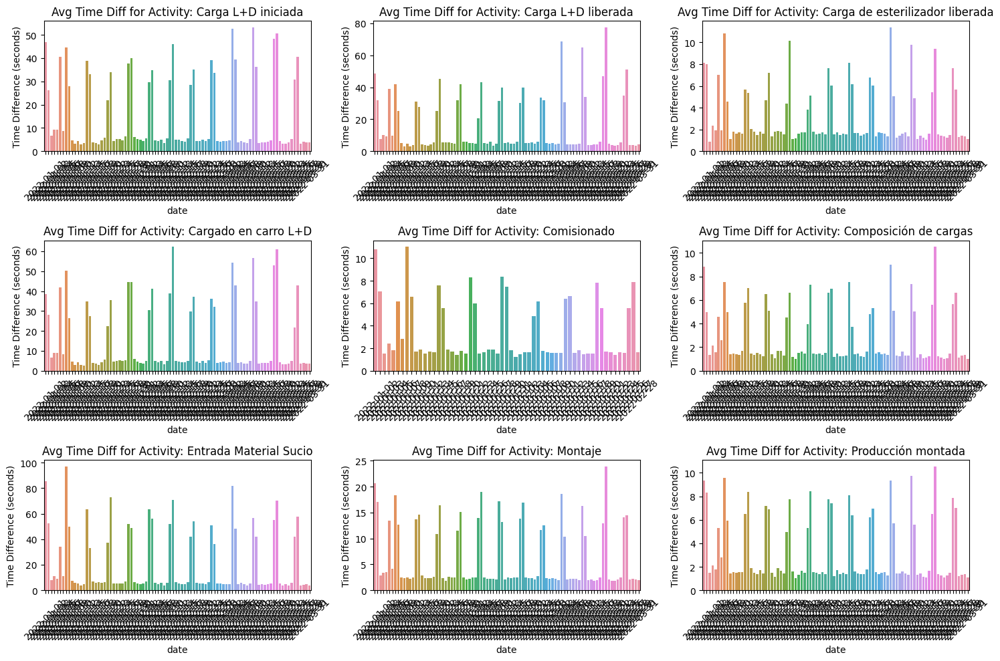

In [191]:
average_time_diff = df_time_diff.groupby(['date', 'e.Activity'])['time_diff'].mean().reset_index()
average_time_diff['time_diff_seconds'] = average_time_diff['time_diff'].dt.total_seconds() / 60

plt.figure(figsize=(15, 10))

for i, activity in enumerate(unique_activities, 1):
    plt.subplot((num_activities + 2) // 3, 3, i)
    activity_data = average_time_diff[average_time_diff['e.Activity'] == activity]
    sns.barplot(data=activity_data, x='date', y='time_diff_seconds')
    plt.title(f'Avg Time Diff for Activity: {activity}')
    plt.ylabel('Time Difference (seconds)')
    plt.xticks(rotation=45)
    plt.tight_layout()

plt.show()

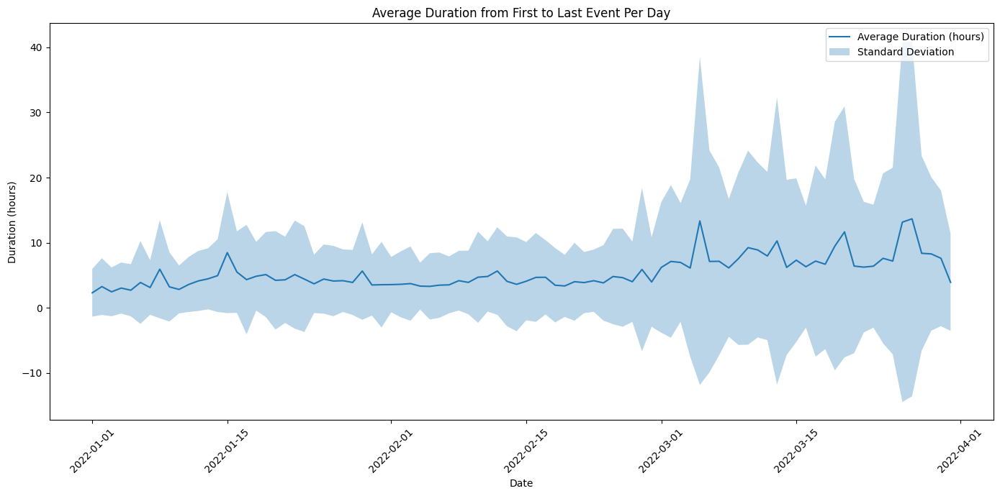

In [192]:
df_filtered = df[df['e.Activity'].isin(['Entrada Material Sucio', 'Carga de esterilizador liberada'])]
df_filtered = df_filtered.sort_values(by=['r.CaseID', 'e.timestamp'])

case_durations = df_filtered.groupby('r.CaseID').apply(lambda x: x.iloc[-1]['e.timestamp'] - x.iloc[0]['e.timestamp']).reset_index(name='duration')
case_durations = case_durations.merge(df[['r.CaseID', 'date']].drop_duplicates(), on='r.CaseID')
case_durations['duration_hours'] = case_durations['duration'].dt.total_seconds() / 3600 

daily_stats = case_durations.groupby('date')['duration_hours'].agg(['mean', 'std']).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=daily_stats, x='date', y='mean', label='Average Duration (hours)')
plt.fill_between(daily_stats['date'], daily_stats['mean'] - daily_stats['std'], daily_stats['mean'] + daily_stats['std'], alpha=0.3, label='Standard Deviation')
plt.xlabel('Date')
plt.ylabel('Duration (hours)')
plt.title('Average Duration from First to Last Event Per Day')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


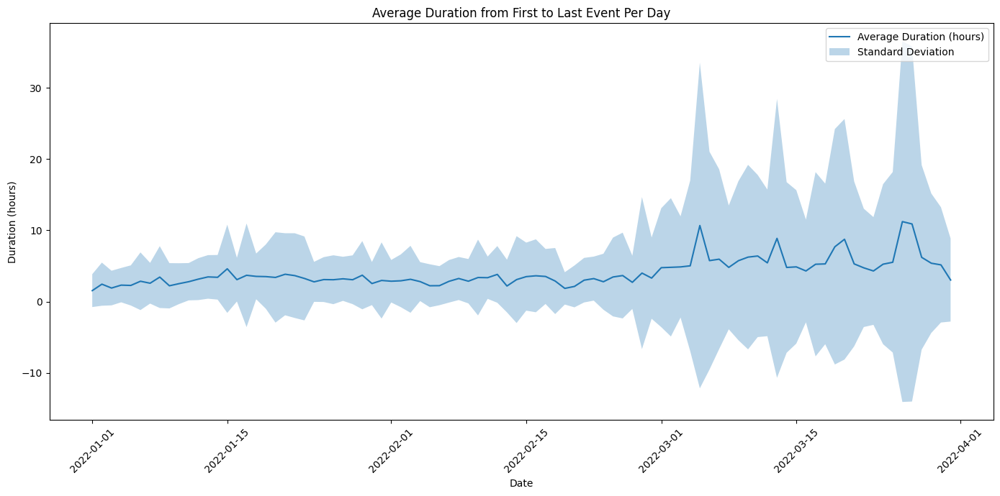

In [193]:
df_filtered = df[df['e.Activity'].isin(['Entrada Material Sucio', 'Carga de esterilizador liberada'])]
df_filtered = df_filtered.sort_values(by=['r.CaseID', 'e.timestamp'])

def calculate_duration(group):
    start_event = group.iloc[0]
    end_event = group.iloc[-1]
    duration = end_event['e.timestamp'] - start_event['e.timestamp']
    
    if start_event['date'] != end_event['date']:
        duration -= pd.Timedelta(hours=8)
    
    return duration

case_durations = df_filtered.groupby('r.CaseID').apply(calculate_duration).reset_index(name='duration')
case_durations = case_durations.merge(df[['r.CaseID', 'date']].drop_duplicates(), on='r.CaseID')
case_durations['duration_hours'] = case_durations['duration'].dt.total_seconds() / 3600 

daily_stats = case_durations.groupby('date')['duration_hours'].agg(['mean', 'std']).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=daily_stats, x='date', y='mean', label='Average Duration (hours)')
plt.fill_between(daily_stats['date'], daily_stats['mean'] - daily_stats['std'], daily_stats['mean'] + daily_stats['std'], alpha=0.3, label='Standard Deviation')
plt.xlabel('Date')
plt.ylabel('Duration (hours)')
plt.title('Average Duration from First to Last Event Per Day')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


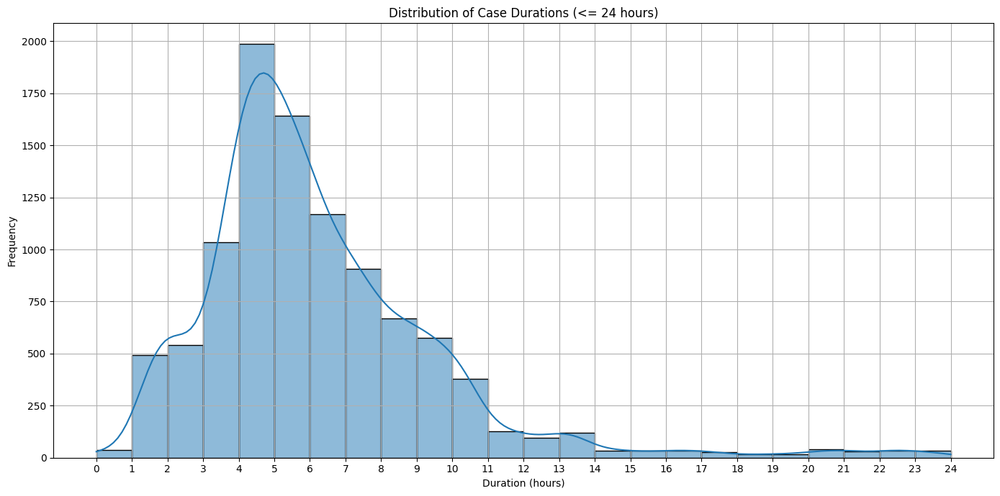

In [195]:
query = '''match (r:Run {EntityType: 'Kit'}) <- [:CORR] - (e:Event)
where not e.KitID contains "CONT"
return e.Usuario, e.timestamp, e.Activity, e.KitID, e.NS, e.Código, r.CaseID'''

result = session.run(query)
data = result.data()

df = pd.DataFrame(data)

df['e.timestamp'] = pd.to_datetime(df['e.timestamp'], format='%Y-%m-%dT%H:%M:%S.%f%z')
df['date'] = df['e.timestamp'].dt.date

valid_df = df[df['e.Activity'].isin(['Entrada Material Sucio', 'Carga de esterilizador liberada'])]["r.CaseID"]
valid_df = valid_df.value_counts()
valid_df = valid_df[valid_df == 2].index
df_filtered = df[df['r.CaseID'].isin(valid_df)]

df_filtered = df_filtered.sort_values(by=['r.CaseID', 'e.timestamp'])

def calculate_duration(group):
    start_event = group.iloc[0]
    end_event = group.iloc[-1]
    duration = end_event['e.timestamp'] - start_event['e.timestamp']
    
    if start_event['date'] != end_event['date']:
        duration -= pd.Timedelta(hours=8)
    
    return pd.Series({
        'duration': duration,
        'date': start_event['date']
    })

case_durations = df_filtered.groupby('r.CaseID').apply(calculate_duration).reset_index()
case_durations['duration_hours'] = case_durations['duration'].dt.total_seconds() / 3600 
case_durations = case_durations[case_durations['duration_hours'] <= 24]

plt.figure(figsize=(14, 7))
sns.histplot(case_durations['duration_hours'], bins=24, kde=True)
plt.xlabel('Duration (hours)')
plt.ylabel('Frequency')
plt.title('Distribution of Case Durations (<= 24 hours)')
plt.xticks(range(0, 25))
plt.grid(True)
plt.tight_layout()
plt.show()
